In [2]:
import pandas as pd       
import os 
import time
import math 
import numpy as np
import matplotlib.pyplot as plt  
import IPython.display as ipd  # To play sound in the notebook
import librosa
import librosa.display
from __future__ import print_function
import pathlib
import IPython.display as ipd  # To play sound in the notebook

from scipy.signal import savgol_filter


from six.moves import xrange

import umap

import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import DataLoader, Dataset
import torch.optim as optim

import torchvision.datasets as datasets
import torchvision.transforms as transforms
from torchvision.utils import make_grid
from torchsummary import summary
import random
from torchviz import make_dot, make_dot_from_trace

In [37]:
i = time.time()
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(time.time() -i)

0.00732731819152832


In [38]:
torch.cuda.current_device()

0

In [39]:
torch.cuda.is_available()

True

In [3]:
# PATHS 

raw_data = '/home/ubuntu/speech2speech/data/raw/VCTK-Corpus'
interim_data = os.path.join('/home/ubuntu/speech2speech/data', 'interim')
spectogram_array_path =  os.path.join(interim_data, 'spectogram_array')
spectogram_array_path_trim_30db =  os.path.join(interim_data, 'spectogram_array_trim_30db')
spectrogram_path =os.path.join(interim_data, 'spectogram') 
audio_path = '/home/ubuntu/speech2speech/data/raw/VCTK-Corpus/wav48/'
trim_audio_path = '/home/ubuntu/speech2speech/data/trim_silence_30db'

In [4]:
# MKDIR
if not os.path.exists(interim_data):
    os.makedirs(interim_data)

if not os.path.exists(spectogram_array_path):
    os.mkdir(spectogram_array_path)

In [5]:
spectogram_array_path_trim_30db

'/home/ubuntu/speech2speech/data/interim/spectogram_array_trim_30db'

## Load Data 

In [6]:
import os
import glob

files_np1 = list(glob.glob(os.path.join(spectogram_array_path_trim_30db,'trim_spec_p225*')))
files_np2 = list(glob.glob(os.path.join(spectogram_array_path_trim_30db,'trim_spec_p226*')))

In [7]:
len(files_np1)

231

In [8]:
len(files_np2)

356

In [9]:
files_np = files_np1+files_np2

In [10]:
len(files_np)

587

In [11]:
col_shape = []
for file in files_np: 
    trial_x = np.load(file)
    _, cols = trial_x.shape
    col_shape.append(cols)

In [12]:
max_col = max(col_shape)
max_col

350

In [13]:
np.percentile(col_shape, 95)

141.39999999999986

/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/matplotlib/font_manager.py:1241: UserWarning: findfont: Font family ['Helvetica'] not found. Falling back to DejaVu Sans.
  (prop.get_family(), self.defaultFamily[fontext]))


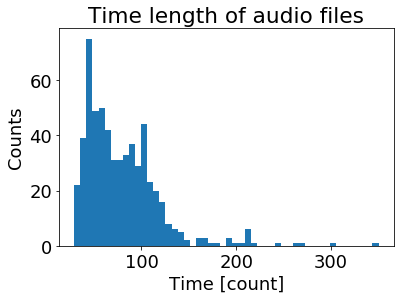

In [14]:
plt.rc("font", size=18, family="Helvetica")
params = {'legend.fontsize': 10 }
plt.rcParams.update(params)
plt.hist(col_shape, bins = 50)
plt.title("Time length of audio files")
plt.xlabel("Time [count]")
plt.ylabel("Counts")

max_col = max(col_shape)

In [15]:
max_col=150
X_list = []
Y_list = []
for file in files_np:     
    load_x = np.load(file)
    x = np.zeros((load_x.shape[0], max_col), dtype = np.float32)
    c = min(max_col, load_x.shape[1])
    x[:load_x.shape[0], :c] = load_x[:, :c]
    
    x =torch.tensor(x, device='cpu').float()
    trial_y = file.split('trim_spec_p')[1][:3]
    trial_y =torch.tensor(int(trial_y), device='cpu').float()
    X_list.append(x)
    Y_list.append(trial_y)

In [16]:
Y_np_list = []
for file in files_np: 
    trial_y = file.split('trim_spec_p')[1][:3]
    Y_np_list.append(trial_y)


In [17]:
Y_np_list= list(set(Y_np_list))

In [18]:
speaker_dic ={'264': 0,
 '298': 1,
 '269': 2,
 '329': 3,
 '314': 4,
 '340': 5,
 '255': 6,
 '299': 7,
 '250': 8,
 '243': 9,
 '234': 10,
 '351': 11,
 '300': 12,
 '361': 13,
 '281': 14,
 '287': 15,
 '259': 16,
 '310': 17,
 '297': 18,
 '248': 19,
 '256': 20,
 '244': 21,
 '288': 22,
 '263': 23,
 '245': 24,
 '236': 25,
 '227': 26,
 '225': 27,
 '280': 28,
 '295': 29,
 '293': 30,
 '228': 31,
 '240': 32,
 '270': 33,
 '233': 34,
 '363': 35,
 '311': 36,
 '262': 37,
 '276': 38,
 '231': 39,
 '230': 40,
 '305': 41,
 '257': 42,
 '374': 43,
 '339': 44,
 '251': 45,
 '252': 46,
 '268': 47,
 '335': 48,
 '317': 49,
 '241': 50,
 '267': 51,
 '265': 52,
 '237': 53,
 '343': 54,
 '294': 55,
 '312': 56,
 '304': 57,
 '232': 58,
 '258': 59,
 '247': 60,
 '334': 61,
 '278': 62,
 '364': 63,
 '261': 64,
 '226': 65,
 '360': 66,
 '282': 67,
 '330': 68,
 '239': 69,
 '246': 70,
 '238': 71,
 '316': 72,
 '283': 73,
 '273': 74,
 '347': 75,
 '318': 76,
 '274': 77,
 '285': 78,
 '333': 79,
 '313': 80,
 '303': 81,
 '272': 82,
 '292': 83,
 '253': 84,
 '266': 85,
 '275': 86,
 '308': 87,
 '307': 88,
 '326': 89,
 '323': 90,
 '315': 91,
 '286': 92,
 '249': 93,
 '277': 94,
 '301': 95,
 '376': 96,
 '306': 97,
 '345': 98,
 '362': 99,
 '254': 100,
 '279': 101,
 '302': 102,
 '341': 103,
 '271': 104,
 '260': 105,
 '229': 106,
 '336': 107,
 '284': 108}

In [19]:
x_Tensor= torch.stack(X_list)

In [20]:
y_Tensor= torch.stack(Y_list)

In [21]:
full_tensordataset = torch.utils.data.TensorDataset(x_Tensor, y_Tensor)

In [22]:
full_loader = torch.utils.data.DataLoader(full_tensordataset, batch_size= 10 ,pin_memory= True, shuffle= True  )

In [23]:
train_val_size = int(0.9 * len(full_tensordataset))
test_size = len(full_tensordataset)- train_val_size
train__val_dataset, test_dataset = torch.utils.data.random_split(full_tensordataset, [train_val_size, test_size])
train_size = int(0.9 * len(train__val_dataset))
val_size = len(train__val_dataset) - train_size
train_dataset, val_dataset = torch.utils.data.random_split(train__val_dataset, [train_size, val_size])

In [24]:
len(train__val_dataset)

528

In [25]:
len(test_dataset)+len(train_dataset)+len(val_dataset)

587

In [26]:
x_Tensor.shape

torch.Size([587, 1025, 150])

## Vector Quantizer Layer

This layer takes a tensor to be quantized. The channel dimension will be used as the space in which to quantize. All other dimensions will be flattened and will be seen as different examples to quantize.

The output tensor will have the same shape as the input.

As an example for a `BCHW` tensor of shape `[16, 64, 32, 32]`, we will first convert it to an `BHWC` tensor of shape `[16, 32, 32, 64]` and then reshape it into `[16384, 64]` and all `16384` vectors of size `64`  will be quantized independently. In otherwords, the channels are used as the space in which to quantize. All other dimensions will be flattened and be seen as different examples to quantize, `16384` in this case.

In [27]:
batch_size = 10
num_training_updates = 15000 #15000

# Encoder
num_hiddens = 768
num_residual_hiddens = 256
num_residual_layers = 2
# input_dim: 256

# VQ
# This value is not that important, usually 64 works.
# This will not change the capacity in the information-bottleneck.
embedding_dim = 64
# The higher this value, the higher the capacity in the information bottleneck.
num_embeddings = 300

# Commitment cost should be set appropriately. It's often useful to try a couple
# of values. It mostly depends on the scale of the reconstruction cost
# (log p(x|z)). So if the reconstruction cost is 100x higher, the
# commitment_cost should also be multiplied with the same amount.
# 0.25 as specified in the paper.
commitment_cost = 0.25

# Only uses for the EMA updates (instead of the Adam optimizer).
# This typically converges faster, and makes the model less dependent on choice
# of the optimizer. In the original VQ-VAE paper [van den Oord et al., 2017],
# EMA updates were not used (but suggested in appendix) and compared in
# [Roy et al., 2018].
decay = -0.99

learning_rate = 1e-4

embedding2_dim = 64
num_epochs   = 20

In [48]:
class VectorQuantizer(nn.Module):
    def __init__(self, num_embeddings, embedding_dim, commitment_cost, device):
        self.verbose = False
        super(VectorQuantizer, self).__init__()
        
        self._embedding_dim = embedding_dim
        self._num_embeddings = num_embeddings
        
        self._embedding = nn.Embedding(self._num_embeddings, self._embedding_dim)
        self._embedding.weight.data.uniform_(-1/self._num_embeddings, 1/self._num_embeddings)
        self._commitment_cost = commitment_cost
        self._device = device

    def forward(self, inputs):
        if self.verbose: print('shape of inputs in VectorQuantizer.forward',inputs.size())
        # convert inputs from BCHW (here its B, F, T) -> BHWC
        inputs = inputs.permute(0, 2, 1).contiguous()
        input_shape = inputs.shape
        if self.verbose: print('shape of permutated inputs in VectorQuantizer.forward',input_shape)
        
        
        _, time, batch_size = input_shape
        
        # Flatten input
        flat_input = inputs.view(-1, self._embedding_dim)
        if self.verbose:print('shape of flat_input in VectorQuantizer.forward',flat_input.size())
        if self.verbose:print('device of flat_input',flat_input.device)
        
        # Calculate distances
        distances = (torch.sum(flat_input**2, dim=1, keepdim=True) 
                    + torch.sum(self._embedding.weight**2, dim=1)
                    - 2 * torch.matmul(flat_input, self._embedding.weight.t()))
            
        # Encoding
        encoding_indices = torch.argmin(distances, dim=1).unsqueeze(1)
        encodings = torch.zeros(encoding_indices.shape[0], self._num_embeddings, device=inputs.device)
        encodings.scatter_(1, encoding_indices, 1)
        
        # Quantize and unflatten
        quantized = torch.matmul(encodings, self._embedding.weight).view(input_shape)
        if self.verbose:print('shape of quantized in VectorQuantizer.forward',quantized.size())
        
        # Loss
        e_latent_loss = F.mse_loss(quantized.detach(), inputs)
        q_latent_loss = F.mse_loss(quantized, inputs.detach())
        loss = q_latent_loss + self._commitment_cost * e_latent_loss
        
        quantized = inputs + (quantized - inputs).detach()
        avg_probs = torch.mean(encodings, dim=0)
        perplexity = torch.exp(-torch.sum(avg_probs * torch.log(avg_probs + 1e-10)))
        if self.verbose:print('shape of inputs quantized in VectorQuantizer.forward',quantized.size())
        if self.verbose:print("with inputs quantized: ",quantized.size())
        
        # convert quantized from BHWC -> BCHW 
        return loss, quantized.permute(0, 2, 1).contiguous(), perplexity, encodings

We will also implement a slightly modified version  which will use exponential moving averages to update the embedding vectors instead of an auxillary loss. This has the advantage that the embedding updates are independent of the choice of optimizer for the encoder, decoder and other parts of the architecture. For most experiments the EMA version trains faster than the non-EMA version.

In [35]:
class VectorQuantizerEMA(nn.Module):
    """
    Inspired from Sonnet implementation of VQ-VAE https://arxiv.org/abs/1711.00937,
    in https://github.com/deepmind/sonnet/blob/master/sonnet/python/modules/nets/vqvae.py and
    pytorch implementation of it from zalandoresearch in https://github.com/zalandoresearch/pytorch-vq-vae/blob/master/vq-vae.ipynb.
    Implements a slightly modified version of the algorithm presented in
    'Neural Discrete Representation Learning' by van den Oord et al.
    https://arxiv.org/abs/1711.00937
    The difference between VectorQuantizerEMA and VectorQuantizer is that
    this module uses exponential moving averages to update the embedding vectors
    instead of an auxiliary loss. This has the advantage that the embedding
    updates are independent of the choice of optimizer (SGD, RMSProp, Adam, K-Fac,
    ...) used for the encoder, decoder and other parts of the architecture. For
    most experiments the EMA version trains faster than the non-EMA version.
    Input any tensor to be quantized. Last dimension will be used as space in
    which to quantize. All other dimensions will be flattened and will be seen
    as different examples to quantize.
    The output tensor will have the same shape as the input.
    For example a tensor with shape [16, 32, 32, 64] will be reshaped into
    [16384, 64] and all 16384 vectors (each of 64 dimensions)  will be quantized
    independently.
    Args:
        embedding_dim: integer representing the dimensionality of the tensors in the
            quantized space. Inputs to the modules must be in this format as well.
        num_embeddings: integer, the number of vectors in the quantized space.
            commitment_cost: scalar which controls the weighting of the loss terms (see
            equation 4 in the paper).
        decay: float, decay for the moving averages.
        epsilon: small float constant to avoid numerical instability.
    """
        
        
    def __init__(self, num_embeddings, embedding_dim, commitment_cost, decay, device, epsilon=1e-5):
           
        super(VectorQuantizerEMA, self).__init__()
        
        self._embedding_dim = embedding_dim
        self._num_embeddings = num_embeddings
        
        self._embedding = nn.Embedding(self._num_embeddings, self._embedding_dim)
        self._embedding.weight.data.normal_()
        self._commitment_cost = commitment_cost
        
        self.register_buffer('_ema_cluster_size', torch.zeros(num_embeddings))
        self._ema_w = nn.Parameter(torch.Tensor(num_embeddings, self._embedding_dim))
        self._ema_w.data.normal_()
        
        self._decay = decay
        self._epsilon = epsilon
        self._device = device

    def forward(self, inputs, compute_distances_if_possible=True, record_codebook_stats=False):
        """
        Connects the module to some inputs.
        Args:
            inputs: Tensor, final dimension must be equal to embedding_dim. All other
                leading dimensions will be flattened and treated as a large batch.
        
        Returns:
            loss: Tensor containing the loss to optimize.
            quantize: Tensor containing the quantized version of the input.
            perplexity: Tensor containing the perplexity of the encodings.
            encodings: Tensor containing the discrete encodings, ie which element
                of the quantized space each input element was mapped to.
            distances
        """

        
        # convert inputs from BCHW -> BHWC
        inputs = inputs.permute(1, 2, 0).contiguous()
        input_shape = inputs.shape
        
        # Flatten input
        flat_input = inputs.view(-1, self._embedding_dim)
        
        # Calculate distances
        distances = (torch.sum(flat_input**2, dim=1, keepdim=True) 
                    + torch.sum(self._embedding.weight**2, dim=1)
                    - 2 * torch.matmul(flat_input, self._embedding.weight.t()))
        """
        encoding_indices: Tensor containing the discrete encoding indices, ie
        which element of the quantized space each input element was mapped to.
        """
        
        # Encoding
        encoding_indices = torch.argmin(distances, dim=1).unsqueeze(1)
        encodings = torch.zeros(encoding_indices.shape[0], self._num_embeddings, dtype=torch.float).to(self._device)
        encodings.scatter_(1, encoding_indices, 1)
        
        # Compute distances between encoding vectors
        if not self.training and compute_distances_if_possible:
            _encoding_distances = [torch.dist(items[0], items[1], 2).to(self._device) for items in combinations(flat_input, r=2)]
            encoding_distances = torch.tensor(_encoding_distances).to(self._device).view(batch_size, -1)
        else:
            encoding_distances = None

        # Compute distances between embedding vectors
        if not self.training and compute_distances_if_possible:
            _embedding_distances = [torch.dist(items[0], items[1], 2).to(self._device) for items in combinations(self._embedding.weight, r=2)]
            embedding_distances = torch.tensor(_embedding_distances).to(self._device)
        else:
            embedding_distances = None

        # Sample nearest embedding
        if not self.training and compute_distances_if_possible:
            _frames_vs_embedding_distances = [torch.dist(items[0], items[1], 2).to(self._device) for items in product(flat_input, self._embedding.weight.detach())]
            frames_vs_embedding_distances = torch.tensor(_frames_vs_embedding_distances).to(self._device).view(batch_size, time, -1)
        else:
            frames_vs_embedding_distances = None
        
        
        

        
        # Use EMA to update the embedding vectors
        if self.training:
            self._ema_cluster_size = self._ema_cluster_size * self._decay + \
                                     (1 - self._decay) * torch.sum(encodings, 0)
            
            # Laplace smoothing of the cluster size
            n = torch.sum(self._ema_cluster_size.data)
            self._ema_cluster_size = (
                (self._ema_cluster_size + self._epsilon)
                / (n + self._num_embeddings * self._epsilon) * n)
            
            dw = torch.matmul(encodings.t(), flat_input)
            self._ema_w = nn.Parameter(self._ema_w * self._decay + (1 - self._decay) * dw)
            
            self._embedding.weight = nn.Parameter(self._ema_w / self._ema_cluster_size.unsqueeze(1))
        
        # Quantize and unflatten
        quantized = torch.matmul(encodings, self._embedding.weight).view(input_shape)
        
        concatenated_quantized = self._embedding.weight[torch.argmin(distances, dim=1).detach().cpu()] if not self.training or record_codebook_stats else None
        
        # Loss
        e_latent_loss = torch.mean((quantized.detach() - inputs)**2)
        loss = self._commitment_cost * e_latent_loss
        
        # Straight Through Estimator
        quantized = inputs + (quantized - inputs).detach()
        avg_probs = torch.mean(encodings, dim=0)
        """
        The perplexity a useful value to track during training.
        It indicates how many codes are 'active' on average.
        """
        perplexity = torch.exp(-torch.sum(avg_probs * torch.log(avg_probs + 1e-10)))
        
        # convert quantized from BHWC -> BCHW
        return loss, quantized.permute(2, 0, 1).contiguous(), perplexity, encodings

## Encoder & Decoder Architecture

The encoder and decoder architecture is based on a ResNet and is implemented below:

In [49]:
class Encoder(nn.Module):
    def __init__(self, in_channels, num_hiddens, num_residual_layers, num_residual_hiddens):
        super(Encoder, self).__init__()
        self.verbose = False
        """
        2 preprocessing convolution layers with filter length 3
        and residual connections.
        """
        

        self._conv_1 = nn.Conv1d(in_channels= 1025, #??features_filters,
                                 out_channels=num_hiddens,
                                 kernel_size=3,
                                 padding=1)
        
        self._conv_2 = nn.Conv1d(in_channels=num_hiddens,
                                 out_channels=num_hiddens,
                                 kernel_size=3,
                                 padding=1)
        """
        1 strided convolution length reduction layer with filter
        length 4 and stride 2 (downsampling the signal by a factor
        of two).
        """
        
        self._conv_3 = nn.Conv1d(in_channels=num_hiddens,
                                 out_channels=num_hiddens,
                                 kernel_size=4,
                                 stride=1, 
                                 padding=2)
        """
        2 convolutional layers with length 3 and
        residual connections.
        """
        self._conv_4 = nn.Conv1d(in_channels=num_hiddens,
                                 out_channels=num_hiddens,
                                 kernel_size=3,
                                 padding=1)
        
        self._conv_5 = nn.Conv1d(in_channels=num_hiddens,
                                 out_channels=num_hiddens,
                                 kernel_size=3,
                                 padding=1)
        
        self._residual_stack = ResidualStack(in_channels=num_hiddens,
                                             num_hiddens=num_hiddens,
                                             num_residual_layers=num_residual_layers,
                                             num_residual_hiddens=num_residual_hiddens)

    def forward(self, inputs):
        if self.verbose: print('shape of inputs in Encoder.forward',inputs.size())

        x_conv_1 = F.relu(self._conv_1(inputs))
        if self.verbose: print('shape of x in Encoder.forward._conv_1',x_conv_1.size())

        x = F.relu(self._conv_2(x_conv_1)) + x_conv_1
        if self.verbose: print('shape of x in Encoder.forward.relu_2',x.size())
        
        x_conv_3 = F.relu(self._conv_3(x))
        if self.verbose: print('shape of x_conv_3 in Encoder.forward._conv_3',x_conv_3.size())
        
        x_conv_4 = F.relu(self._conv_4(x_conv_3)) + x_conv_3
        if self.verbose: print('shape of x_conv_4 in Encoder.forward._conv_4',x_conv_4.size())
        
        x_conv_5 = F.relu(self._conv_5(x_conv_4)) + x_conv_4
        if self.verbose: print('shape of x_conv_5 in Encoder.forward._conv_5',x_conv_5.size())
        
        x = self._residual_stack(x_conv_5) + x_conv_5
        if self.verbose: print('shape of _residual_stack in Encoder.forward',x.size())
        
        return x

In [50]:
class Residual(nn.Module):
    def __init__(self, in_channels, num_hiddens, num_residual_hiddens):
        
        super(Residual, self).__init__()
        
        self._block = nn.Sequential(
            
            nn.ReLU(True),
            
            nn.Conv1d(
                     in_channels=in_channels,
                      out_channels=num_residual_hiddens,
                      kernel_size=3, 
                      stride=1, 
                      padding=1, 
                      bias=False),
            
            nn.ReLU(True),
            
            nn.Conv1d(in_channels=num_residual_hiddens,
                      out_channels=num_hiddens,
                      kernel_size=1, 
                      stride=1, 
                      bias=False)
        )
    
    def forward(self, x):
        #print('shape of x in Residual.forward',x.size())
        return x + self._block(x)


class ResidualStack(nn.Module):
    def __init__(self, in_channels, num_hiddens, num_residual_layers, num_residual_hiddens):
        super(ResidualStack, self).__init__()
        
        self._num_residual_layers = num_residual_layers
        self._layers = nn.ModuleList([Residual(in_channels, num_hiddens, num_residual_hiddens)
                             for _ in range(self._num_residual_layers)])

    def forward(self, x):
        #print('shape of x in ResidualStack.forward',x.size())
        for i in range(self._num_residual_layers):
            x = self._layers[i](x)
            #print(f'Iteration {i} shape of x in ResidualStack.forward {x.size()} ',)
        return F.relu(x)

In [51]:
class Decoder(nn.Module):
    def __init__(self, in_channels, num_hiddens, num_residual_layers, num_residual_hiddens, speaker_dic , embedding2_dim):
        super(Decoder, self).__init__()
        self.verbose = False
        self._embedding = nn.Embedding(len(speaker_dic), embedding2_dim)
        
        self._conv_1 = nn.Conv1d(in_channels=in_channels + embedding2_dim ,
                                 out_channels=num_hiddens,
                                 kernel_size=3,
                                 padding=1)
        
        self._upsample = nn.Upsample(scale_factor=2)
        
        self._residual_stack = ResidualStack(in_channels=num_hiddens,
                                             num_hiddens=num_hiddens,
                                             num_residual_layers=num_residual_layers,
                                             num_residual_hiddens=num_residual_hiddens)
        
        self._conv_trans_1 = nn.ConvTranspose1d(in_channels=num_hiddens, 
                                                out_channels=num_hiddens,
                                                kernel_size=3, 
                                                padding=1)
        
        self._conv_trans_2 = nn.ConvTranspose1d(in_channels=num_hiddens, 
                                                out_channels=num_hiddens,
                                                kernel_size=3,  
                                                padding=0)
        
        self._conv_trans_3 = nn.ConvTranspose1d(in_channels=num_hiddens, 
                                                out_channels=1025,#out_channels
                                                kernel_size=3, 
                                                padding=3)
        

    def forward(self, inputs, speaker_dic ,  speaker_id):
        if self.verbose: print('shape of inputs in Decoder.forward',inputs.size())
        
        lookup_tensor = torch.tensor([speaker_dic[str(int(i))] for i in speaker_id], dtype=torch.long).to(device)
        if self.verbose: print('shape of lookup_tensor in Decoder.forward',lookup_tensor.size())

         
        spk_emb = self._embedding(lookup_tensor)
        
        if self.verbose: print('shape of spk_emb in Decoder.forward',spk_emb.size())
        spk_emb = spk_emb.unsqueeze(2)
        if self.verbose: print("unqueezed spk_emb",spk_emb.size())
        spk_emb = spk_emb.repeat(1 ,1, inputs.size(2))
        if self.verbose: print("spk_emb repeated along time and batch ", spk_emb.size())
        
        
                            
        
        
        x = torch.cat((spk_emb, inputs), dim = 1 )
        if self.verbose: print('shape of x in Decoder.forward.cat',x.size())
        
        x = self._conv_1(x)
        if self.verbose: print('shape of x in Decoder.forward._conv_1',x.size())
        
        x = self._upsample(x)
        if self.verbose: print('shape of x in Decoder.forward._upsample',x.size())
        
        x = self._residual_stack(x)
        if self.verbose: print('shape of x in Decoder.forward._residual_stack',x.size())
        
        x = self._conv_trans_1(x)
        #
        if self.verbose: print('shape of x in Decoder.forward._conv_trans_1',x.size())
        
        x = F.relu(x)#self._conv_trans_1(x)
        if self.verbose: print('shape of x in Decoder.forward._conv_trans_1',x.size())
        
        x = F.relu(self._conv_trans_2(x))
        if self.verbose: print('shape of x in Decoder.forward._conv_trans_2',x.size())
        
        x = self._conv_trans_3(x)
        if self.verbose: print('shape of x in Decoder.forward._conv_trans_3',x.size())
        
        return x

## Train

We use the hyperparameters from the author's code:

In [33]:
training_loader = DataLoader(train_dataset, 
                             batch_size=batch_size, 
                             shuffle=True,
                             pin_memory=True)

In [34]:
validation_loader = DataLoader(val_dataset,
                               batch_size=batch_size,
                               shuffle=True,
                               pin_memory=True)

In [53]:
class Model(nn.Module):
    def __init__(self, num_hiddens, num_residual_layers, num_residual_hiddens, 
                 num_embeddings, embedding_dim, commitment_cost, decay=0):
        super(Model, self).__init__()
        
        self._encoder = Encoder(1, num_hiddens,
                                num_residual_layers, 
                                num_residual_hiddens)
        self._pre_vq_conv = nn.Conv1d(in_channels=num_hiddens, 
                                      out_channels=embedding_dim,
                                      kernel_size=1, 
                                      stride=1)
        if decay > 0.0:
            self._vq_vae = VectorQuantizerEMA(num_embeddings, embedding_dim, 
                                              commitment_cost, decay)
        else:
            self._vq_vae = VectorQuantizer(num_embeddings, embedding_dim,
                                           commitment_cost, device)
        self._decoder = Decoder(embedding_dim,
                                num_hiddens, 
                                num_residual_layers, 
                                num_residual_hiddens, speaker_dic , embedding2_dim)

    def forward(self, x, speaker_id):
        #print("Model::forward")
        #print(x.size())
        z = self._encoder(x)
        z = self._pre_vq_conv(z)
        loss, quantized, perplexity, _ = self._vq_vae(z)
        #vq_loss, quantized, perplexity, _, _, encoding_indices, \
        #losses, concatenated_quantized = self._vq_vae(z)
        #print("quantized ")
        #print( quantized.size())
        x_recon = self._decoder(quantized, speaker_dic ,  speaker_id)
        
        input_features_size = x.size(2)
        #print('input_features_size', input_features_size)
        output_features_size = x_recon.size(2)
        #print('output_features_size', output_features_size)
        
        x_recon = x_recon.view(-1, 1025, output_features_size)
        x_recon = x_recon[:, :, :-(output_features_size-input_features_size)]
        #print('x_recon size', x_recon.size())

        return loss, x_recon, perplexity

In [54]:
model = Model(num_hiddens, num_residual_layers, num_residual_hiddens,
              num_embeddings, embedding_dim, 
              commitment_cost, decay).to(device)

In [55]:
model

Model(
  (_encoder): Encoder(
    (_conv_1): Conv1d(1025, 768, kernel_size=(3,), stride=(1,), padding=(1,))
    (_conv_2): Conv1d(768, 768, kernel_size=(3,), stride=(1,), padding=(1,))
    (_conv_3): Conv1d(768, 768, kernel_size=(4,), stride=(1,), padding=(2,))
    (_conv_4): Conv1d(768, 768, kernel_size=(3,), stride=(1,), padding=(1,))
    (_conv_5): Conv1d(768, 768, kernel_size=(3,), stride=(1,), padding=(1,))
    (_residual_stack): ResidualStack(
      (_layers): ModuleList(
        (0): Residual(
          (_block): Sequential(
            (0): ReLU(inplace=True)
            (1): Conv1d(768, 256, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
            (2): ReLU(inplace=True)
            (3): Conv1d(256, 768, kernel_size=(1,), stride=(1,), bias=False)
          )
        )
        (1): Residual(
          (_block): Sequential(
            (0): ReLU(inplace=True)
            (1): Conv1d(768, 256, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
            (2): R

In [41]:
optimizer = optim.Adam(model.parameters(), lr=learning_rate, amsgrad=False)

In [42]:
mean = 0.
meansq = 0.
for data in training_loader:
    mean = data[0].mean()
    meansq = (data[0]**2).mean()

std = torch.sqrt(meansq - mean**2)
print("mean: " + str(mean))
print("std: " + str(std))
print()

mean: tensor(0.1874)
std: tensor(1.3385)



In [275]:
from tqdm import tqdm

In [44]:
checkpoint_dir = '/home/ubuntu/speech2speech/checkpoints/225_226_max_col_150_spk_emb_64'

In [45]:
# MKDIR
if not os.path.exists(checkpoint_dir):
    os.makedirs(checkpoint_dir)

In [46]:
num_training_updates

15000

In [ ]:
_i = time.time()
model.train()
train_res_recon_error = []
train_res_perplexity = []

for i in xrange(num_training_updates):
    (data, y) = next(iter(training_loader))
    data = data.to(device)
    optimizer.zero_grad()

    speaker_ids = y.numpy()
            
            
            
            
    # forward pass
    vq_loss, data_recon, perplexity = model(data, speaker_ids)
   
    recon_error = F.mse_loss(data_recon, data) / std
    loss = recon_error + vq_loss
    loss.backward()

    optimizer.step()
    
    train_res_recon_error.append(recon_error.item())
    train_res_perplexity.append(perplexity.item())

    if (i+1) % 100 == 0:
        print('%d iterations' % (i+1))
        print('recon_error: %.3f' % np.mean(train_res_recon_error[-100:]))
        print('perplexity: %.3f' % np.mean(train_res_perplexity[-100:]))
        print()
    if (i+1) % 10000 == 0:
            obj={"model_state_dict": model.state_dict(), 
                "optimizer_state_dict": optimizer.state_dict()}
            torch.save(obj, os.path.join(checkpoint_dir,'checkpoint_state_dict_{}.pth'.format(i+1)))
print(time.time() - _i)

100 iterations
recon_error: 1.821
perplexity: 4.301

200 iterations
recon_error: 1.885
perplexity: 4.357

300 iterations
recon_error: 1.898
perplexity: 4.383

400 iterations
recon_error: 1.871
perplexity: 4.328

500 iterations
recon_error: 1.859
perplexity: 4.305

600 iterations
recon_error: 1.871
perplexity: 4.358

700 iterations
recon_error: 1.848
perplexity: 4.314

800 iterations
recon_error: 1.816
perplexity: 4.351

900 iterations
recon_error: 1.917
perplexity: 4.383

1000 iterations
recon_error: 1.849
perplexity: 4.282

1100 iterations
recon_error: 1.965
perplexity: 4.408

1200 iterations
recon_error: 1.836
perplexity: 4.340

1300 iterations
recon_error: 1.970
perplexity: 4.387

1400 iterations
recon_error: 1.897
perplexity: 4.360

1500 iterations
recon_error: 1.871
perplexity: 4.344

1600 iterations
recon_error: 1.851
perplexity: 4.310

1700 iterations
recon_error: 1.902
perplexity: 4.342

1800 iterations
recon_error: 1.826
perplexity: 4.349

1900 iterations
recon_error: 1.806
pe

In [295]:
len(training_loader)

48

In [294]:
len(validation_loader)

6

In [293]:
mean = 0.
meansq = 0.
for data in validation_loader:
    mean = data[0].mean()
    meansq = (data[0]**2).mean()

std = torch.sqrt(meansq - mean**2)
print("mean: " + str(mean))
print("std: " + str(std))
print()

model.eval()
eval_res_recon_error = []
eval_res_perplexity = []

for i in xrange(num_training_updates):

        (data, y) = next(iter(validation_loader))
        data = data.to(device)
        speaker_ids = y.numpy()
            
            
        # zero the parameter gradients
        optimizer.zero_grad()
        # forward + backward + optimize
        vq_loss, data_recon, perplexity = model(data, speaker_ids)
            
        recon_error = F.mse_loss(data_recon, data) / std
        loss = recon_error + vq_loss
            
        
        eval_res_recon_error.append(recon_error.item())
        eval_res_perplexity.append(perplexity.item())
        if (i+1) % 100 == 0:
            print('%d iterations' % (i+1))
            print('recon_error: %.3f' % np.mean(eval_res_recon_error[-100:]))
            print('perplexity: %.3f' % np.mean(eval_res_perplexity[-100:]))
            print()

mean: tensor(0.1477)
std: tensor(1.0676)

100 iterations
recon_error: 0.625
perplexity: 8.602

200 iterations
recon_error: 0.625
perplexity: 8.602

300 iterations
recon_error: 0.625
perplexity: 8.602

400 iterations
recon_error: 0.625
perplexity: 8.602

500 iterations
recon_error: 0.625
perplexity: 8.602

600 iterations
recon_error: 0.625
perplexity: 8.602

700 iterations
recon_error: 0.625
perplexity: 8.602

800 iterations
recon_error: 0.625
perplexity: 8.602

900 iterations
recon_error: 0.625
perplexity: 8.602

1000 iterations
recon_error: 0.625
perplexity: 8.602

1100 iterations
recon_error: 0.625
perplexity: 8.602

1200 iterations
recon_error: 0.625
perplexity: 8.602

1300 iterations
recon_error: 0.625
perplexity: 8.602

1400 iterations
recon_error: 0.625
perplexity: 8.602

1500 iterations
recon_error: 0.625
perplexity: 8.602

1600 iterations
recon_error: 0.625
perplexity: 8.602

1700 iterations
recon_error: 0.625
perplexity: 8.602

1800 iterations
recon_error: 0.625
perplexity: 8.

## Plot Loss 

In [283]:
len(train_res_recon_error)

15000

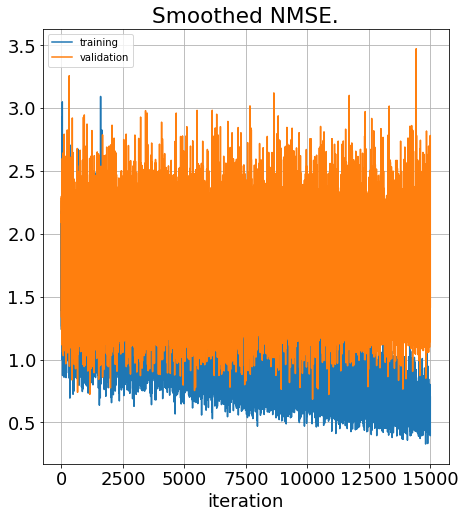

In [296]:
f = plt.figure(figsize=(16,8))
ax = f.add_subplot(1,2,1)
ax.plot(train_res_recon_error, label = 'training')
ax.plot(eval_res_recon_error, label = 'validation')
#ax.set_yscale('log')
ax.set_title('Smoothed NMSE.')
ax.set_xlabel('iteration')
ax.grid()
ax.legend()

In [297]:
train_res_recon_error_smooth = savgol_filter(train_res_recon_error, 201, 7)
train_res_perplexity_smooth = savgol_filter(train_res_perplexity, 201, 7)
eval_res_recon_error_smooth = savgol_filter(eval_res_recon_error, 201, 7)
eval_res_perplexity_smooth = savgol_filter(eval_res_perplexity, 201, 7)

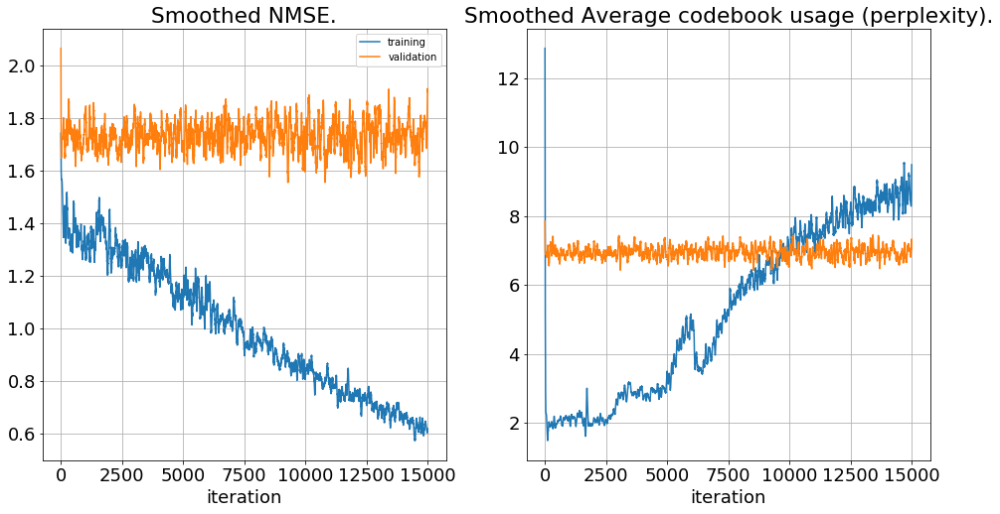

In [299]:
f = plt.figure(figsize=(16,8))
ax = f.add_subplot(1,2,1)
ax.plot(train_res_recon_error_smooth, label = 'training')
ax.plot(eval_res_recon_error_smooth, label = 'validation')
#ax.set_yscale('log')
ax.set_title('Smoothed NMSE.')
ax.set_xlabel('iteration')
#ax.set_ylim(1.1, 1.4)
ax.grid()
ax.legend()


ax = f.add_subplot(1,2,2)
ax.plot(train_res_perplexity_smooth)
ax.plot(eval_res_perplexity_smooth)
ax.set_title('Smoothed Average codebook usage (perplexity).')
ax.set_xlabel('iteration')
ax.grid()

## Reconstructions 

In [116]:
model.eval()

(valid_originals, _) = next(iter(validation_loader))
valid_originals = valid_originals.to(device)

vq_output_eval = model._pre_vq_conv(model._encoder(valid_originals))
_, valid_quantize, _, _ = model._vq_vae(vq_output_eval)
valid_reconstructions = model._decoder(valid_quantize, speaker_dic, speaker_id)

In [303]:
(data, y) = next(iter(training_loader))
data = data.to(device)
speaker_ids = y.numpy()
            

vq_loss, data_recon, perplexity = model(data, speaker_ids)

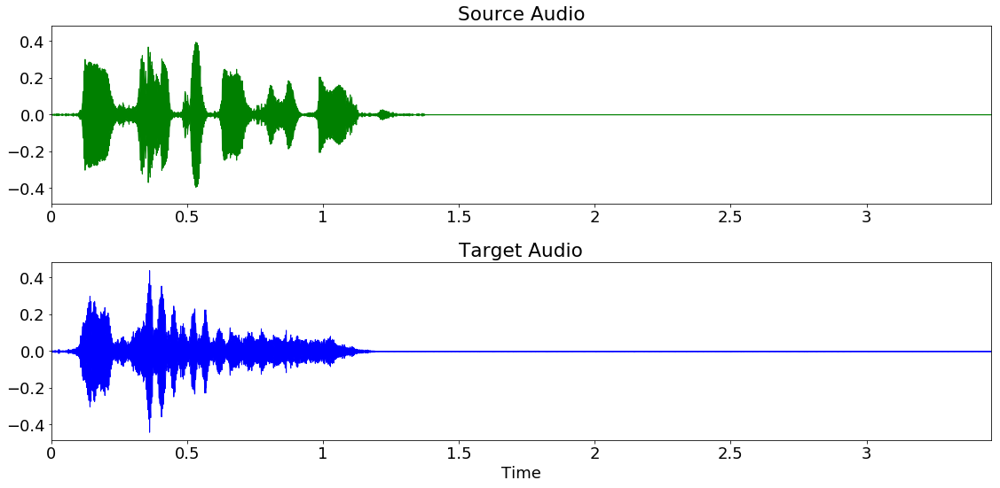

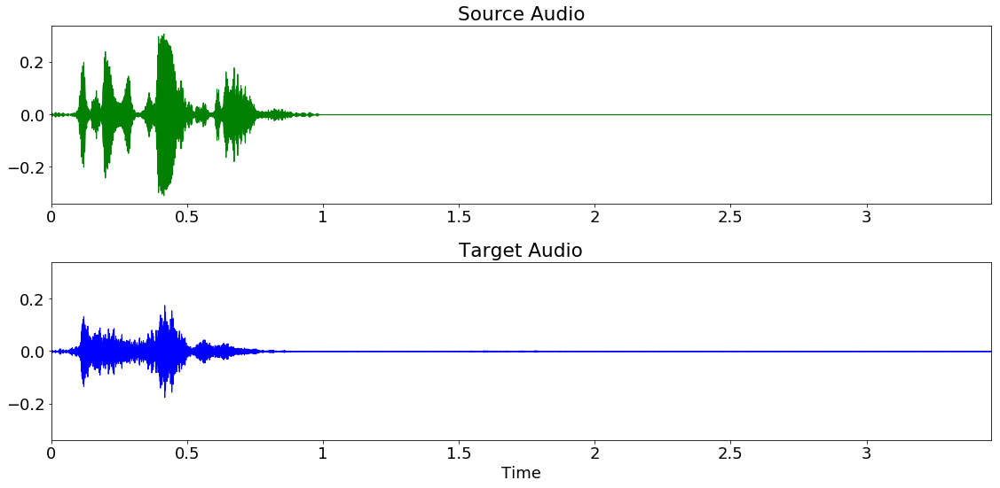

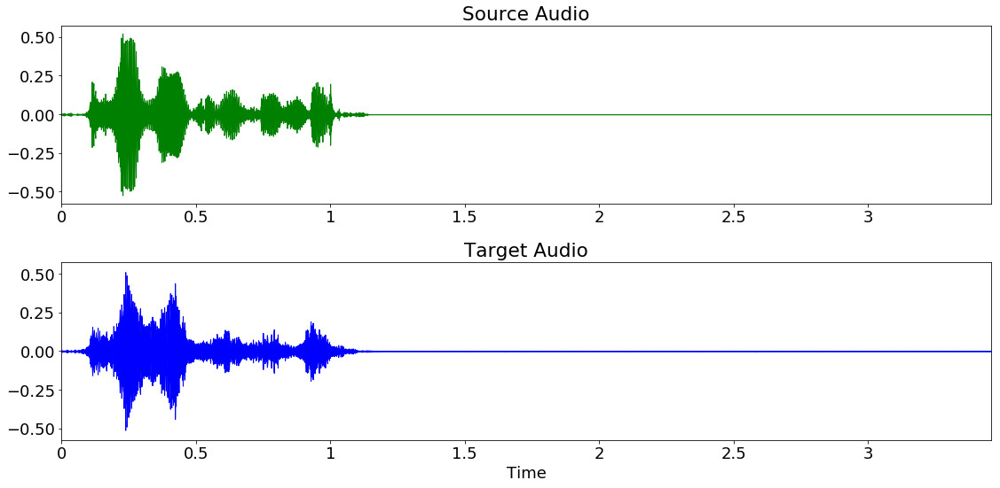

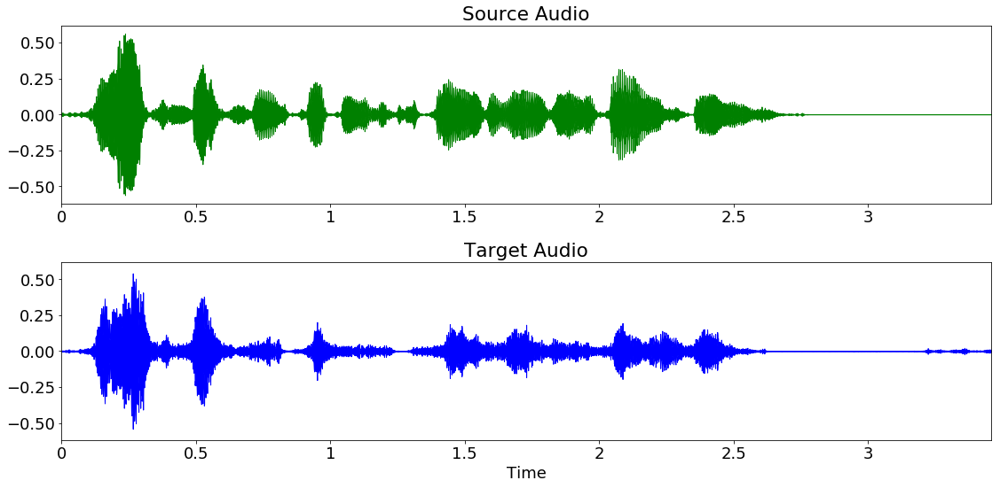

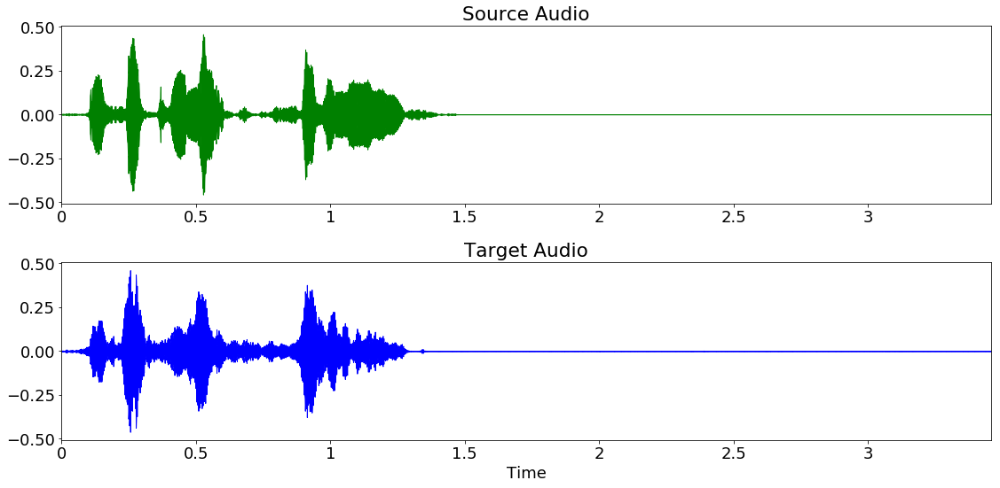

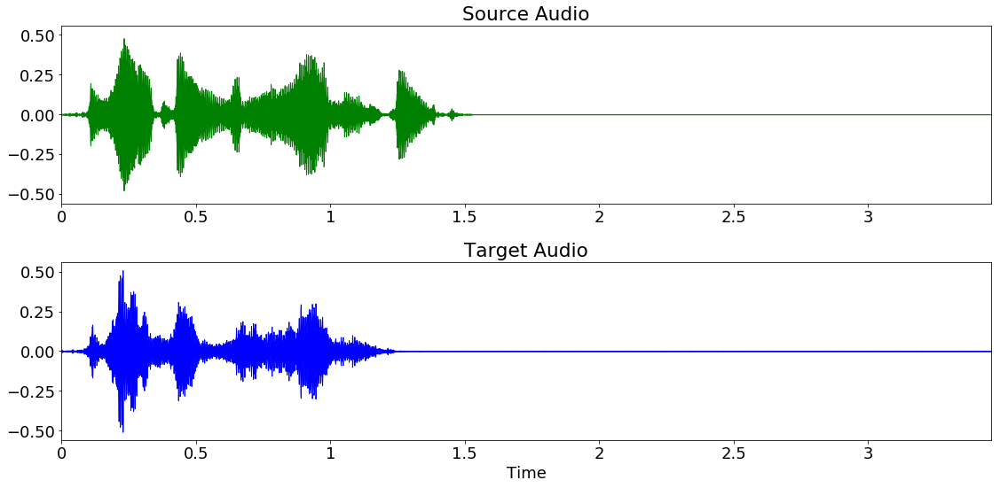

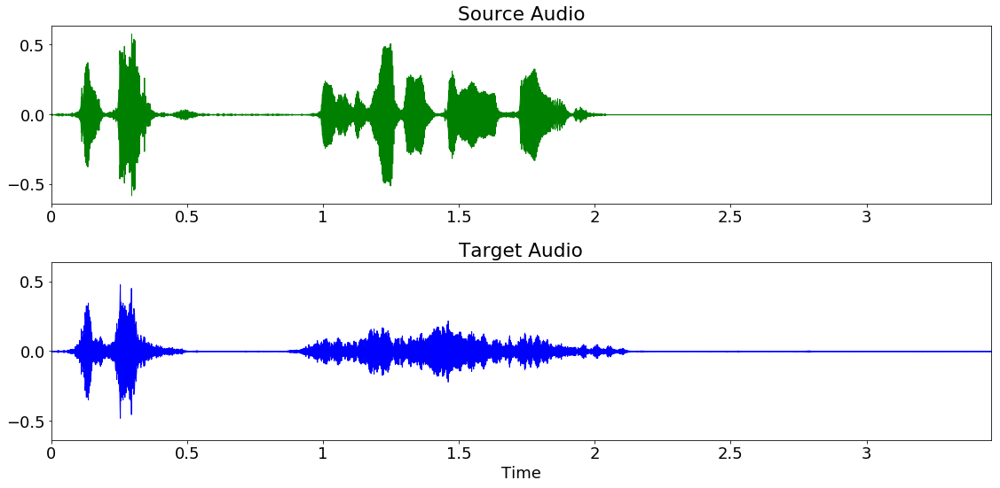

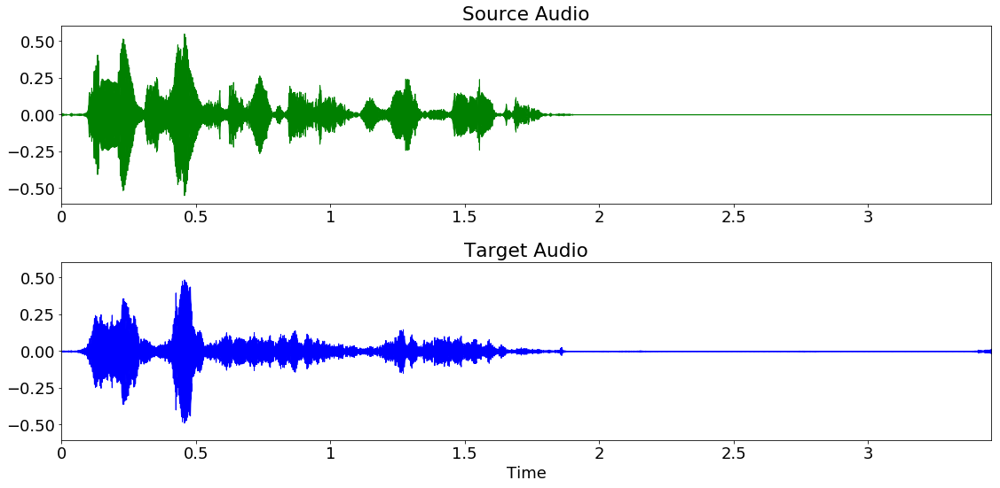

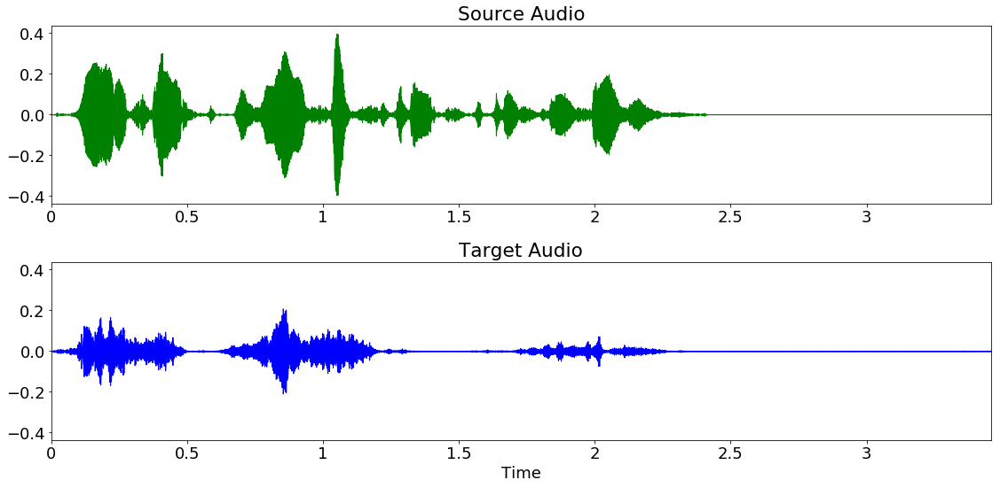

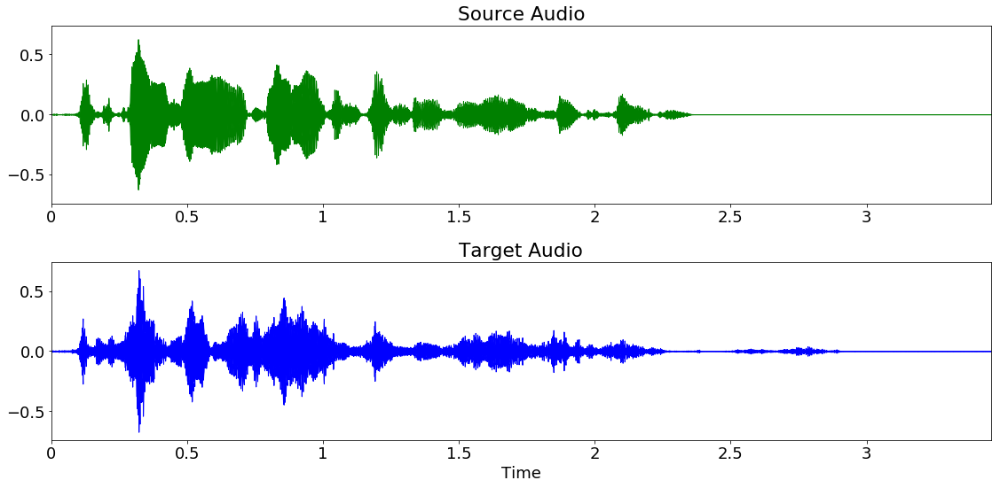

In [304]:
for i in range(len(data)):
    data_np = (data[i].to(torch.device("cpu"))).detach().numpy();
    data_griffin_lim = librosa.griffinlim(data_np)
    data_recon_np = (data_recon[i].to(torch.device("cpu"))).detach().numpy();
    data_recon_griffin_lim = librosa.griffinlim(data_recon_np)
    
    fig = plt.figure(figsize=(16, 8))
    ax = plt.subplot(2,1,1)
    output_path = '/home/ubuntu/speech2speech/plots/plot_225_226_' + str(i) + '.png'
    source_aud_path = '/home/ubuntu/speech2speech/output/source_225_226_' + str(i) + '.wav'
    target_aud_path = '/home/ubuntu/speech2speech/output/target_225_226_' + str(i) + '.wav'
    
    librosa.display.waveplot(data_griffin_lim, color = 'g')
    plt.title('Source Audio')
    plt.xlabel('')
    plt.subplot(2,1,2, sharex=ax, sharey=ax)
    plt.title('Target Audio')
    librosa.display.waveplot(data_recon_griffin_lim, color = 'b')
    plt.tight_layout()
    fig.savefig(output_path)
    
    librosa.output.write_wav(source_aud_path,data_griffin_lim, 16000)
    librosa.output.write_wav(target_aud_path,data_recon_griffin_lim, 16000)

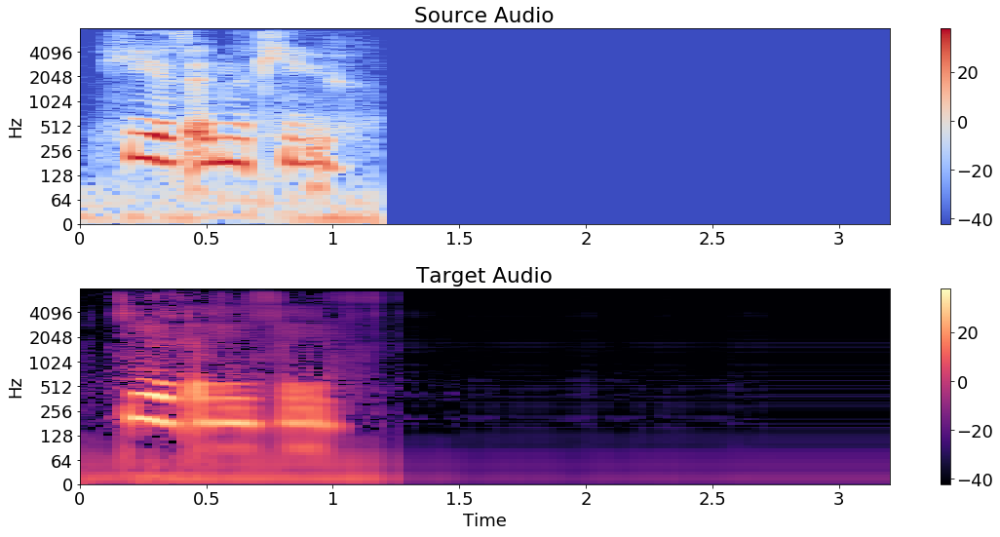

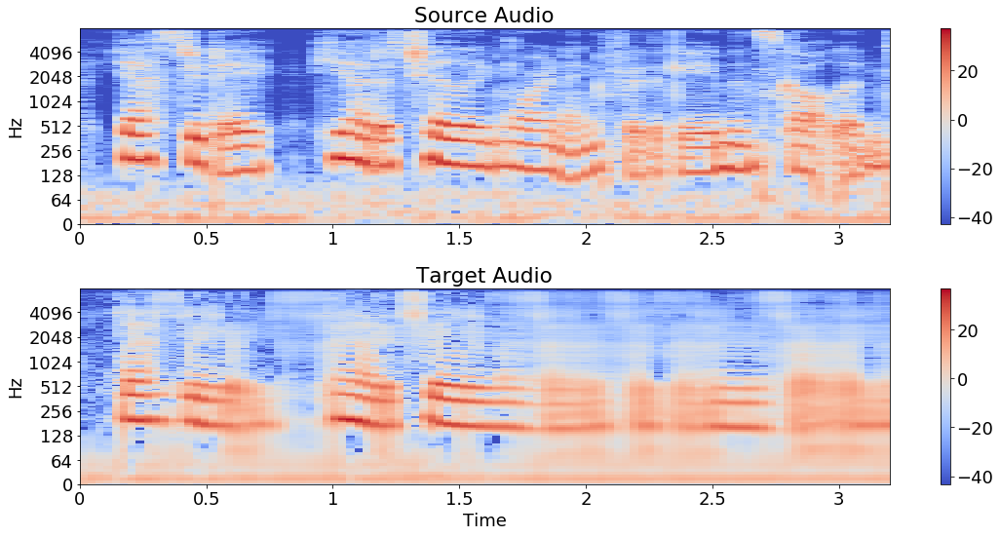

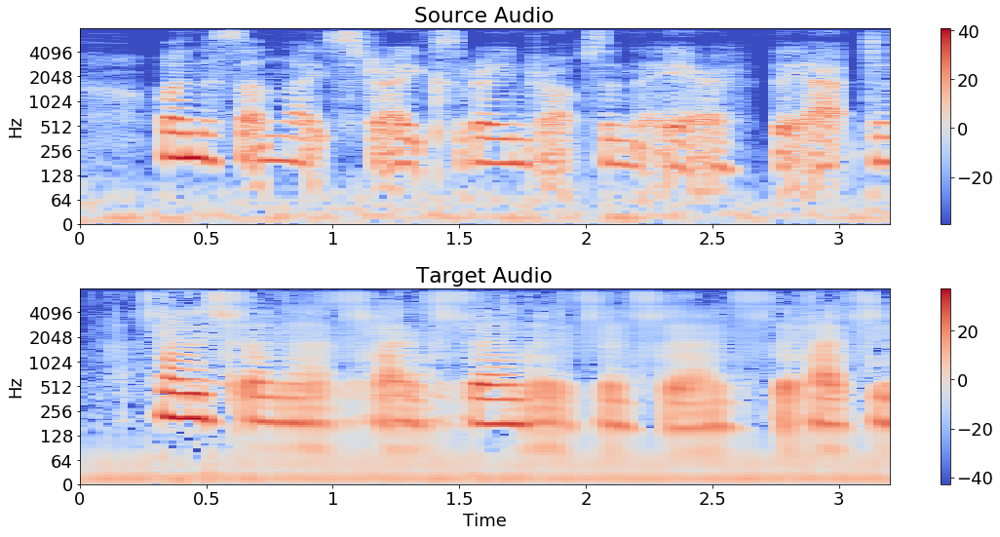

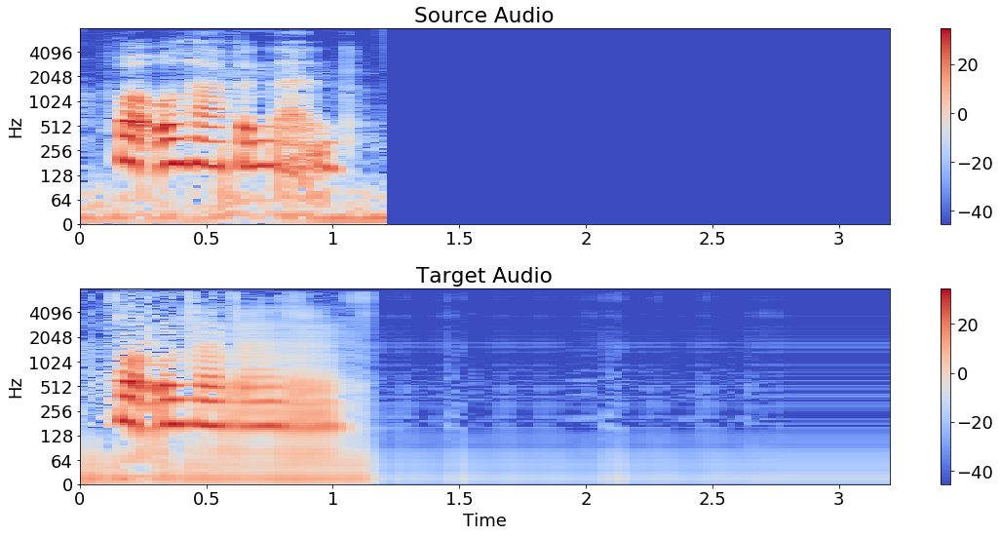

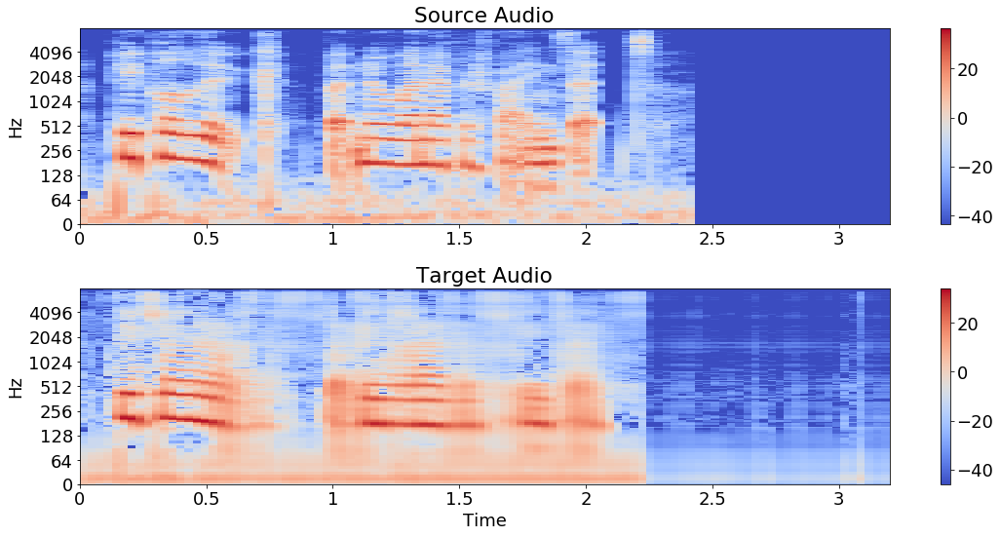

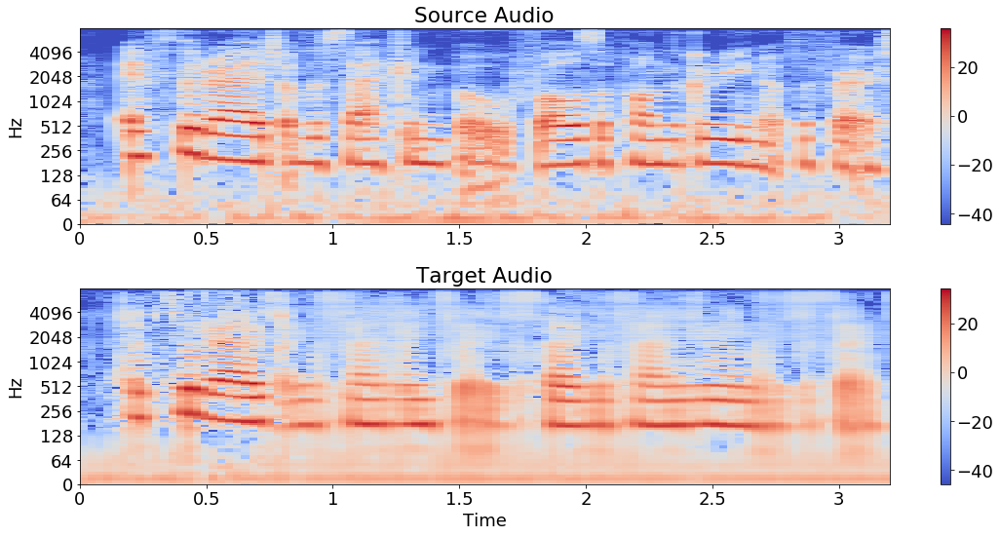

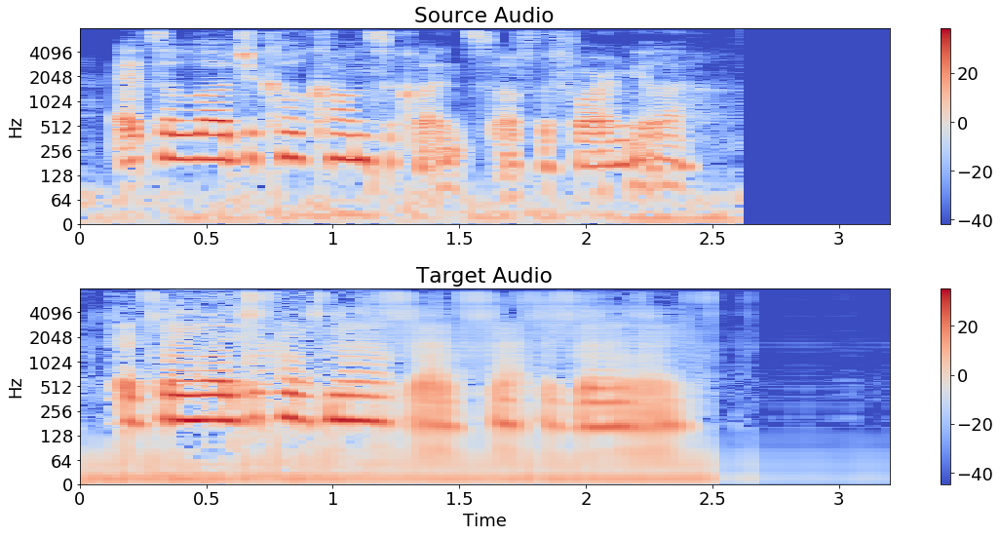

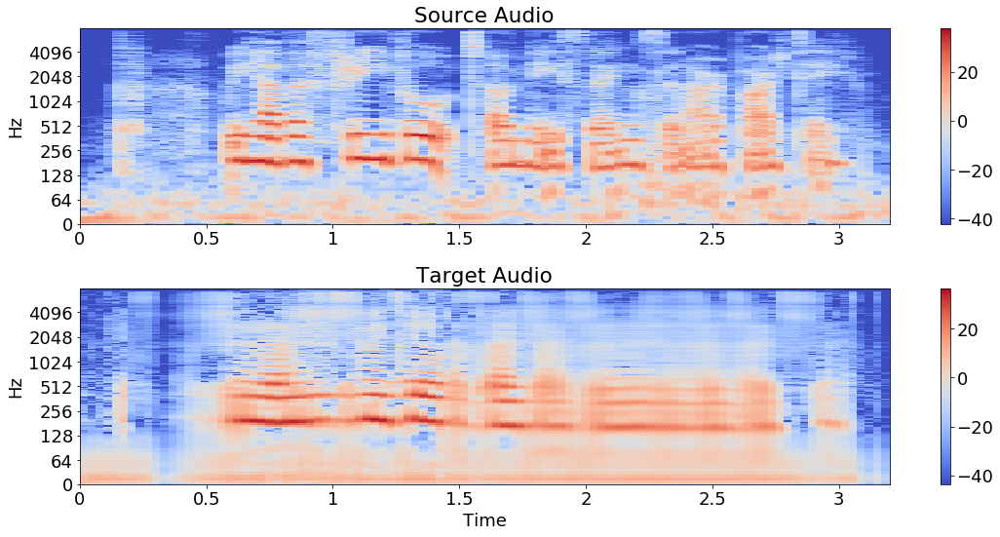

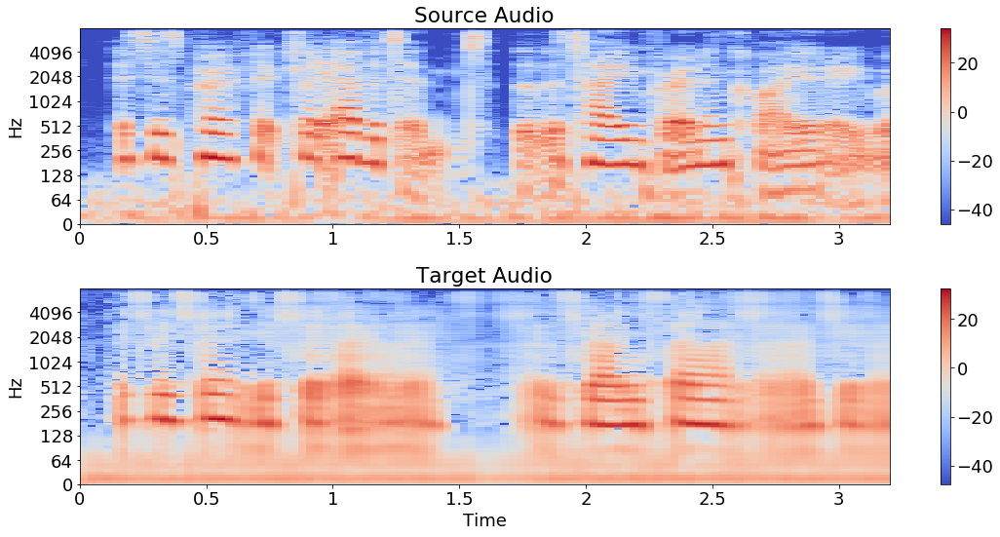

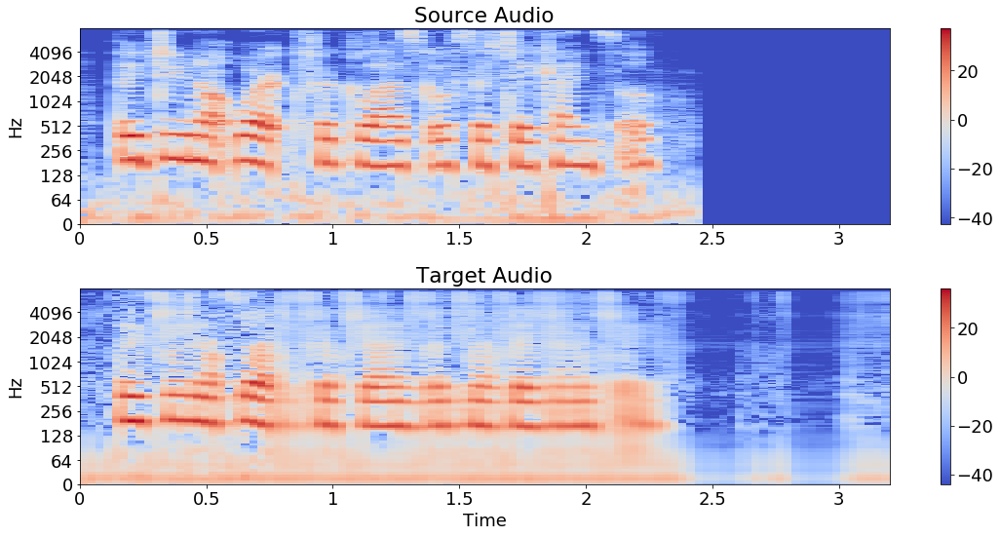

In [119]:
for i in range(len(data)):
    data_np = (data[i].to(torch.device("cpu"))).detach().numpy();
    data_np = librosa.amplitude_to_db(abs(data_np))
    data_recon_np = (data_recon[i].to(torch.device("cpu"))).detach().numpy();
    data_recon_np = librosa.amplitude_to_db(abs(data_recon_np))
    
    fig = plt.figure(figsize=(16, 8))
    ax = plt.subplot(2,1,1)
    output_path = '/home/ubuntu/speech2speech/plots/spec_plot_' + str(i) + '.png'

    librosa.display.specshow(data_np, sr=16000, x_axis='time', y_axis='log')
    plt.title('Source Audio')
    plt.xlabel('')
    plt.colorbar()
    plt.subplot(2,1,2, sharex=ax, sharey=ax)
    plt.title('Target Audio')
    librosa.display.specshow(data_recon_np, sr=16000, x_axis='time', y_axis='log')
    plt.colorbar()
    plt.tight_layout()
    fig.savefig(output_path)

In [305]:
!ls

'Extracting Audio Features.ipynb'
 Extracting_Audio_Features_TODO.ipynb
 MNIST
 Untitled.ipynb
 Untitled1.ipynb
 Untitled2.ipynb
 Untitled3.ipynb
 Untitled4.ipynb
 VQ_VAE.png
 __pycache__
 bayesian-hypothesis-testing-300x225.jpg
 data
 data_preprocessing.ipynb
 images
 male_female.ipynb
 model_v1.ipynb
 model_v2.ipynb
 model_v3.ipynb
 model_v4.ipynb
 old
 output_to_audio.py.ipynb
 predict-256_spectrogram_db_lr1em4.py.ipynb
 predict-300_spectrogram_db_lr1em4.py.ipynb
 predict-Copy1.py.ipynb
 predict.py.ipynb
 reconstruction_same_speaker.ipynb
 serving_trial.py.ipynb
 startup_notes-old.ipynb
 startup_notes.ipynb
 variable_batch_data_loading.py.ipynb
 vq-vae.ipynb
 vqvae2_scrap.ipynb


In [306]:
!pwd

/home/ubuntu/speech2speech/notebooks


In [308]:
!cd /home/ubuntu/speech2speech
!tree /home/ubuntu/speech2speech

/home/ubuntu/speech2speech
├── FAILED001.test_num_embeddings300_spectrogram_db_lr1em3
│   ├── checkpoints
│   │   └── checkpoint_state_dict_10
│   ├── output
│   └── plots
├── README.md
├── __init__.py
├── checkpoints
│   ├── 225_226_150
│   │   └── checkpoint_state_dict_15k_iter.pt
│   ├── 249
│   │   ├── checkpoint_model_1.pth
│   │   ├── checkpoint_state_dict_1.pt
│   │   ├── checkpoint_state_dict_1.pth
│   │   ├── checkpoint_state_dict_10.pt
│   │   ├── checkpoint_state_dict_11.pt
│   │   ├── checkpoint_state_dict_12.pt
│   │   ├── checkpoint_state_dict_13.pt
│   │   ├── checkpoint_state_dict_14.pt
│   │   ├── checkpoint_state_dict_15.pt
│   │   ├── checkpoint_state_dict_16.pt
│   │   ├── checkpoint_state_dict_17.pt
│   │   ├── checkpoint_state_dict_18.pt
│   │   ├── checkpoint_state_dict_19.pt
│   │   ├── checkpoint_state_dict_2.pt
│   │   ├── checkpoint_state_dict_20.pt
│   │   ├── checkpoint_state_dict_3.pt
│   │   ├── checkpoint_state_dict_4.pt
│   │   ├── checkpoint_state_dict

│   │   │   ├── spectogramp351_151.png.npy
│   │   │   ├── spectogramp351_159.png.npy
│   │   │   ├── spectogramp351_171.png.npy
│   │   │   ├── spectogramp351_188.png.npy
│   │   │   ├── spectogramp351_196.png.npy
│   │   │   ├── spectogramp351_204.png.npy
│   │   │   ├── spectogramp351_216.png.npy
│   │   │   ├── spectogramp351_228.png.npy
│   │   │   ├── spectogramp351_239.png.npy
│   │   │   ├── spectogramp351_255.png.npy
│   │   │   ├── spectogramp351_272.png.npy
│   │   │   ├── spectogramp351_293.png.npy
│   │   │   ├── spectogramp351_298.png.npy
│   │   │   ├── spectogramp351_301.png.npy
│   │   │   ├── spectogramp351_309.png.npy
│   │   │   ├── spectogramp351_323.png.npy
│   │   │   ├── spectogramp351_336.png.npy
│   │   │   ├── spectogramp351_338.png.npy
│   │   │   ├── spectogramp351_353.png.npy
│   │   │   ├── spectogramp351_420.png.npy
│   │   │   ├── spectogramp351_422.png.npy
│   │   │   ├── spectogramp360_005.png.npy
│   │   │   ├── spectogramp360_009.png.npy
│   │   │  

│   │   ├── spectogram_array_path_trim_30db_ntft_512
│   │   │   ├── p225_001.npy
│   │   │   ├── p225_002.npy
│   │   │   ├── p225_003.npy
│   │   │   ├── p225_004.npy
│   │   │   ├── p225_005.npy
│   │   │   ├── p225_006.npy
│   │   │   ├── p225_007.npy
│   │   │   ├── p225_008.npy
│   │   │   ├── p225_009.npy
│   │   │   ├── p225_010.npy
│   │   │   ├── p225_011.npy
│   │   │   ├── p225_012.npy
│   │   │   ├── p225_013.npy
│   │   │   ├── p225_014.npy
│   │   │   ├── p225_016.npy
│   │   │   ├── p225_017.npy
│   │   │   ├── p225_018.npy
│   │   │   ├── p225_019.npy
│   │   │   ├── p225_020.npy
│   │   │   ├── p225_021.npy
│   │   │   ├── p225_022.npy
│   │   │   ├── p225_023.npy
│   │   │   ├── p225_024.npy
│   │   │   ├── p225_025.npy
│   │   │   ├── p225_026.npy
│   │   │   ├── p225_027.npy
│   │   │   ├── p225_028.npy
│   │   │   ├── p225_029.npy
│   │   │   ├── p225_030.npy
│   │   │   ├── p225_033.npy
│   │   │   ├── p225_035.npy
│   │   │   ├── p225_036.npy
│   │   │   ├── p22

│   │   │   ├── p227_020.npy
│   │   │   ├── p227_021.npy
│   │   │   ├── p227_022.npy
│   │   │   ├── p227_023.npy
│   │   │   ├── p227_024.npy
│   │   │   ├── p227_025.npy
│   │   │   ├── p227_026.npy
│   │   │   ├── p227_027.npy
│   │   │   ├── p227_028.npy
│   │   │   ├── p227_029.npy
│   │   │   ├── p227_030.npy
│   │   │   ├── p227_031.npy
│   │   │   ├── p227_032.npy
│   │   │   ├── p227_033.npy
│   │   │   ├── p227_034.npy
│   │   │   ├── p227_035.npy
│   │   │   ├── p227_036.npy
│   │   │   ├── p227_037.npy
│   │   │   ├── p227_038.npy
│   │   │   ├── p227_039.npy
│   │   │   ├── p227_040.npy
│   │   │   ├── p227_041.npy
│   │   │   ├── p227_042.npy
│   │   │   ├── p227_043.npy
│   │   │   ├── p227_044.npy
│   │   │   ├── p227_045.npy
│   │   │   ├── p227_046.npy
│   │   │   ├── p227_047.npy
│   │   │   ├── p227_048.npy
│   │   │   ├── p227_049.npy
│   │   │   ├── p227_050.npy
│   │   │   ├── p227_051.npy
│   │   │   ├── p227_052.npy
│   │   │   ├── p227_053.npy
│   │   │   ├─

│   │   │   ├── p241_302.npy
│   │   │   ├── p241_303.npy
│   │   │   ├── p241_304.npy
│   │   │   ├── p241_305.npy
│   │   │   ├── p241_306.npy
│   │   │   ├── p241_307.npy
│   │   │   ├── p241_308.npy
│   │   │   ├── p241_309.npy
│   │   │   ├── p241_310.npy
│   │   │   ├── p241_311.npy
│   │   │   ├── p241_312.npy
│   │   │   ├── p241_313.npy
│   │   │   ├── p241_314.npy
│   │   │   ├── p241_315.npy
│   │   │   ├── p241_317.npy
│   │   │   ├── p241_319.npy
│   │   │   ├── p241_320.npy
│   │   │   ├── p241_321.npy
│   │   │   ├── p241_322.npy
│   │   │   ├── p241_323.npy
│   │   │   ├── p241_324.npy
│   │   │   ├── p241_325.npy
│   │   │   ├── p241_326.npy
│   │   │   ├── p241_327.npy
│   │   │   ├── p241_328.npy
│   │   │   ├── p241_329.npy
│   │   │   ├── p241_330.npy
│   │   │   ├── p241_331.npy
│   │   │   ├── p241_332.npy
│   │   │   ├── p241_333.npy
│   │   │   ├── p241_334.npy
│   │   │   ├── p241_336.npy
│   │   │   ├── p241_337.npy
│   │   │   ├── p241_338.npy
│   │   │   ├─

│   │   │   ├── p257_012.npy
│   │   │   ├── p257_013.npy
│   │   │   ├── p257_014.npy
│   │   │   ├── p257_015.npy
│   │   │   ├── p257_016.npy
│   │   │   ├── p257_017.npy
│   │   │   ├── p257_018.npy
│   │   │   ├── p257_019.npy
│   │   │   ├── p257_020.npy
│   │   │   ├── p257_021.npy
│   │   │   ├── p257_022.npy
│   │   │   ├── p257_023.npy
│   │   │   ├── p257_024.npy
│   │   │   ├── p257_025.npy
│   │   │   ├── p257_026.npy
│   │   │   ├── p257_027.npy
│   │   │   ├── p257_028.npy
│   │   │   ├── p257_029.npy
│   │   │   ├── p257_030.npy
│   │   │   ├── p257_031.npy
│   │   │   ├── p257_032.npy
│   │   │   ├── p257_033.npy
│   │   │   ├── p257_034.npy
│   │   │   ├── p257_035.npy
│   │   │   ├── p257_036.npy
│   │   │   ├── p257_037.npy
│   │   │   ├── p257_038.npy
│   │   │   ├── p257_039.npy
│   │   │   ├── p257_040.npy
│   │   │   ├── p257_041.npy
│   │   │   ├── p257_042.npy
│   │   │   ├── p257_043.npy
│   │   │   ├── p257_044.npy
│   │   │   ├── p257_045.npy
│   │   │   ├─

│   │   │   ├── p270_348.npy
│   │   │   ├── p270_349.npy
│   │   │   ├── p270_350.npy
│   │   │   ├── p270_351.npy
│   │   │   ├── p270_352.npy
│   │   │   ├── p270_353.npy
│   │   │   ├── p270_354.npy
│   │   │   ├── p270_355.npy
│   │   │   ├── p270_356.npy
│   │   │   ├── p270_357.npy
│   │   │   ├── p270_358.npy
│   │   │   ├── p270_359.npy
│   │   │   ├── p270_360.npy
│   │   │   ├── p270_361.npy
│   │   │   ├── p270_362.npy
│   │   │   ├── p270_363.npy
│   │   │   ├── p270_364.npy
│   │   │   ├── p270_365.npy
│   │   │   ├── p270_366.npy
│   │   │   ├── p270_367.npy
│   │   │   ├── p270_368.npy
│   │   │   ├── p270_369.npy
│   │   │   ├── p270_370.npy
│   │   │   ├── p270_371.npy
│   │   │   ├── p270_372.npy
│   │   │   ├── p270_373.npy
│   │   │   ├── p270_374.npy
│   │   │   ├── p270_375.npy
│   │   │   ├── p270_376.npy
│   │   │   ├── p270_377.npy
│   │   │   ├── p270_378.npy
│   │   │   ├── p270_379.npy
│   │   │   ├── p270_380.npy
│   │   │   ├── p270_381.npy
│   │   │   ├─

│   │   │   ├── p283_394.npy
│   │   │   ├── p283_395.npy
│   │   │   ├── p283_396.npy
│   │   │   ├── p283_397.npy
│   │   │   ├── p283_398.npy
│   │   │   ├── p283_399.npy
│   │   │   ├── p283_400.npy
│   │   │   ├── p283_401.npy
│   │   │   ├── p283_402.npy
│   │   │   ├── p283_403.npy
│   │   │   ├── p283_404.npy
│   │   │   ├── p283_405.npy
│   │   │   ├── p283_406.npy
│   │   │   ├── p283_407.npy
│   │   │   ├── p283_408.npy
│   │   │   ├── p283_409.npy
│   │   │   ├── p283_410.npy
│   │   │   ├── p283_411.npy
│   │   │   ├── p283_412.npy
│   │   │   ├── p283_413.npy
│   │   │   ├── p283_414.npy
│   │   │   ├── p283_415.npy
│   │   │   ├── p283_416.npy
│   │   │   ├── p283_417.npy
│   │   │   ├── p283_418.npy
│   │   │   ├── p283_419.npy
│   │   │   ├── p283_420.npy
│   │   │   ├── p283_421.npy
│   │   │   ├── p283_422.npy
│   │   │   ├── p283_423.npy
│   │   │   ├── p283_424.npy
│   │   │   ├── p283_425.npy
│   │   │   ├── p283_426.npy
│   │   │   ├── p283_427.npy
│   │   │   ├─

│   │   │   ├── p301_207.npy
│   │   │   ├── p301_208.npy
│   │   │   ├── p301_209.npy
│   │   │   ├── p301_210.npy
│   │   │   ├── p301_211.npy
│   │   │   ├── p301_212.npy
│   │   │   ├── p301_213.npy
│   │   │   ├── p301_214.npy
│   │   │   ├── p301_215.npy
│   │   │   ├── p301_216.npy
│   │   │   ├── p301_217.npy
│   │   │   ├── p301_218.npy
│   │   │   ├── p301_219.npy
│   │   │   ├── p301_220.npy
│   │   │   ├── p301_221.npy
│   │   │   ├── p301_222.npy
│   │   │   ├── p301_223.npy
│   │   │   ├── p301_224.npy
│   │   │   ├── p301_225.npy
│   │   │   ├── p301_226.npy
│   │   │   ├── p301_227.npy
│   │   │   ├── p301_228.npy
│   │   │   ├── p301_229.npy
│   │   │   ├── p301_230.npy
│   │   │   ├── p301_231.npy
│   │   │   ├── p301_232.npy
│   │   │   ├── p301_233.npy
│   │   │   ├── p301_234.npy
│   │   │   ├── p301_235.npy
│   │   │   ├── p301_236.npy
│   │   │   ├── p301_237.npy
│   │   │   ├── p301_238.npy
│   │   │   ├── p301_239.npy
│   │   │   ├── p301_240.npy
│   │   │   ├─

│   │   │   ├── p316_068.npy
│   │   │   ├── p316_069.npy
│   │   │   ├── p316_070.npy
│   │   │   ├── p316_071.npy
│   │   │   ├── p316_072.npy
│   │   │   ├── p316_073.npy
│   │   │   ├── p316_074.npy
│   │   │   ├── p316_075.npy
│   │   │   ├── p316_076.npy
│   │   │   ├── p316_077.npy
│   │   │   ├── p316_078.npy
│   │   │   ├── p316_079.npy
│   │   │   ├── p316_080.npy
│   │   │   ├── p316_081.npy
│   │   │   ├── p316_082.npy
│   │   │   ├── p316_083.npy
│   │   │   ├── p316_084.npy
│   │   │   ├── p316_085.npy
│   │   │   ├── p316_086.npy
│   │   │   ├── p316_087.npy
│   │   │   ├── p316_088.npy
│   │   │   ├── p316_089.npy
│   │   │   ├── p316_090.npy
│   │   │   ├── p316_091.npy
│   │   │   ├── p316_092.npy
│   │   │   ├── p316_093.npy
│   │   │   ├── p316_094.npy
│   │   │   ├── p316_095.npy
│   │   │   ├── p316_096.npy
│   │   │   ├── p316_097.npy
│   │   │   ├── p316_098.npy
│   │   │   ├── p316_099.npy
│   │   │   ├── p316_100.npy
│   │   │   ├── p316_101.npy
│   │   │   ├─

│   │   │   ├── p343_375.npy
│   │   │   ├── p343_376.npy
│   │   │   ├── p343_377.npy
│   │   │   ├── p343_378.npy
│   │   │   ├── p343_379.npy
│   │   │   ├── p343_381.npy
│   │   │   ├── p343_382.npy
│   │   │   ├── p343_383.npy
│   │   │   ├── p343_384.npy
│   │   │   ├── p343_385.npy
│   │   │   ├── p343_386.npy
│   │   │   ├── p343_387.npy
│   │   │   ├── p343_388.npy
│   │   │   ├── p343_389.npy
│   │   │   ├── p343_390.npy
│   │   │   ├── p343_391.npy
│   │   │   ├── p343_392.npy
│   │   │   ├── p343_393.npy
│   │   │   ├── p343_394.npy
│   │   │   ├── p343_395.npy
│   │   │   ├── p343_396.npy
│   │   │   ├── p343_397.npy
│   │   │   ├── p343_398.npy
│   │   │   ├── p343_399.npy
│   │   │   ├── p343_400.npy
│   │   │   ├── p345_001.npy
│   │   │   ├── p345_002.npy
│   │   │   ├── p345_003.npy
│   │   │   ├── p345_004.npy
│   │   │   ├── p345_005.npy
│   │   │   ├── p345_006.npy
│   │   │   ├── p345_007.npy
│   │   │   ├── p345_008.npy
│   │   │   ├── p345_009.npy
│   │   │   ├─

│   │   └── spectogram_array_trim_30db
│   │       ├── trim_spec_p225_001.npy
│   │       ├── trim_spec_p225_002.npy
│   │       ├── trim_spec_p225_003.npy
│   │       ├── trim_spec_p225_004.npy
│   │       ├── trim_spec_p225_005.npy
│   │       ├── trim_spec_p225_006.npy
│   │       ├── trim_spec_p225_007.npy
│   │       ├── trim_spec_p225_008.npy
│   │       ├── trim_spec_p225_009.npy
│   │       ├── trim_spec_p225_010.npy
│   │       ├── trim_spec_p225_011.npy
│   │       ├── trim_spec_p225_012.npy
│   │       ├── trim_spec_p225_013.npy
│   │       ├── trim_spec_p225_014.npy
│   │       ├── trim_spec_p225_016.npy
│   │       ├── trim_spec_p225_017.npy
│   │       ├── trim_spec_p225_018.npy
│   │       ├── trim_spec_p225_019.npy
│   │       ├── trim_spec_p225_020.npy
│   │       ├── trim_spec_p225_021.npy
│   │       ├── trim_spec_p225_022.npy
│   │       ├── trim_spec_p225_023.npy
│   │       ├── trim_spec_p225_024.npy
│   │       ├── trim_spec_p225_025.npy
│   │       ├── trim_spec

│   │       ├── trim_spec_p238_013.npy
│   │       ├── trim_spec_p238_014.npy
│   │       ├── trim_spec_p238_015.npy
│   │       ├── trim_spec_p238_016.npy
│   │       ├── trim_spec_p238_017.npy
│   │       ├── trim_spec_p238_018.npy
│   │       ├── trim_spec_p238_019.npy
│   │       ├── trim_spec_p238_020.npy
│   │       ├── trim_spec_p238_021.npy
│   │       ├── trim_spec_p238_022.npy
│   │       ├── trim_spec_p238_023.npy
│   │       ├── trim_spec_p238_024.npy
│   │       ├── trim_spec_p238_025.npy
│   │       ├── trim_spec_p238_026.npy
│   │       ├── trim_spec_p238_027.npy
│   │       ├── trim_spec_p238_028.npy
│   │       ├── trim_spec_p238_029.npy
│   │       ├── trim_spec_p238_030.npy
│   │       ├── trim_spec_p238_031.npy
│   │       ├── trim_spec_p238_032.npy
│   │       ├── trim_spec_p238_033.npy
│   │       ├── trim_spec_p238_034.npy
│   │       ├── trim_spec_p238_035.npy
│   │       ├── trim_spec_p238_036.npy
│   │       ├── trim_spec_p238_037.npy
│   │       ├── trim_spec

│   │       ├── trim_spec_p250_233.npy
│   │       ├── trim_spec_p250_234.npy
│   │       ├── trim_spec_p250_235.npy
│   │       ├── trim_spec_p250_236.npy
│   │       ├── trim_spec_p250_237.npy
│   │       ├── trim_spec_p250_238.npy
│   │       ├── trim_spec_p250_239.npy
│   │       ├── trim_spec_p250_240.npy
│   │       ├── trim_spec_p250_241.npy
│   │       ├── trim_spec_p250_242.npy
│   │       ├── trim_spec_p250_243.npy
│   │       ├── trim_spec_p250_244.npy
│   │       ├── trim_spec_p250_245.npy
│   │       ├── trim_spec_p250_246.npy
│   │       ├── trim_spec_p250_247.npy
│   │       ├── trim_spec_p250_248.npy
│   │       ├── trim_spec_p250_249.npy
│   │       ├── trim_spec_p250_250.npy
│   │       ├── trim_spec_p250_251.npy
│   │       ├── trim_spec_p250_252.npy
│   │       ├── trim_spec_p250_253.npy
│   │       ├── trim_spec_p250_254.npy
│   │       ├── trim_spec_p250_255.npy
│   │       ├── trim_spec_p250_257.npy
│   │       ├── trim_spec_p250_258.npy
│   │       ├── trim_spec

│   │       ├── trim_spec_p263_068.npy
│   │       ├── trim_spec_p263_069.npy
│   │       ├── trim_spec_p263_070.npy
│   │       ├── trim_spec_p263_071.npy
│   │       ├── trim_spec_p263_072.npy
│   │       ├── trim_spec_p263_073.npy
│   │       ├── trim_spec_p263_074.npy
│   │       ├── trim_spec_p263_075.npy
│   │       ├── trim_spec_p263_076.npy
│   │       ├── trim_spec_p263_077.npy
│   │       ├── trim_spec_p263_078.npy
│   │       ├── trim_spec_p263_079.npy
│   │       ├── trim_spec_p263_080.npy
│   │       ├── trim_spec_p263_081.npy
│   │       ├── trim_spec_p263_082.npy
│   │       ├── trim_spec_p263_083.npy
│   │       ├── trim_spec_p263_084.npy
│   │       ├── trim_spec_p263_085.npy
│   │       ├── trim_spec_p263_086.npy
│   │       ├── trim_spec_p263_087.npy
│   │       ├── trim_spec_p263_088.npy
│   │       ├── trim_spec_p263_089.npy
│   │       ├── trim_spec_p263_090.npy
│   │       ├── trim_spec_p263_091.npy
│   │       ├── trim_spec_p263_092.npy
│   │       ├── trim_spec

│   │       ├── trim_spec_p274_179.npy
│   │       ├── trim_spec_p274_180.npy
│   │       ├── trim_spec_p274_181.npy
│   │       ├── trim_spec_p274_182.npy
│   │       ├── trim_spec_p274_183.npy
│   │       ├── trim_spec_p274_184.npy
│   │       ├── trim_spec_p274_185.npy
│   │       ├── trim_spec_p274_186.npy
│   │       ├── trim_spec_p274_187.npy
│   │       ├── trim_spec_p274_188.npy
│   │       ├── trim_spec_p274_189.npy
│   │       ├── trim_spec_p274_190.npy
│   │       ├── trim_spec_p274_191.npy
│   │       ├── trim_spec_p274_192.npy
│   │       ├── trim_spec_p274_193.npy
│   │       ├── trim_spec_p274_194.npy
│   │       ├── trim_spec_p274_195.npy
│   │       ├── trim_spec_p274_196.npy
│   │       ├── trim_spec_p274_197.npy
│   │       ├── trim_spec_p274_198.npy
│   │       ├── trim_spec_p274_199.npy
│   │       ├── trim_spec_p274_200.npy
│   │       ├── trim_spec_p274_201.npy
│   │       ├── trim_spec_p274_202.npy
│   │       ├── trim_spec_p274_203.npy
│   │       ├── trim_spec

│   │       ├── trim_spec_p285_249.npy
│   │       ├── trim_spec_p285_250.npy
│   │       ├── trim_spec_p285_251.npy
│   │       ├── trim_spec_p285_252.npy
│   │       ├── trim_spec_p285_253.npy
│   │       ├── trim_spec_p285_254.npy
│   │       ├── trim_spec_p285_255.npy
│   │       ├── trim_spec_p285_256.npy
│   │       ├── trim_spec_p285_257.npy
│   │       ├── trim_spec_p285_258.npy
│   │       ├── trim_spec_p285_259.npy
│   │       ├── trim_spec_p285_260.npy
│   │       ├── trim_spec_p285_261.npy
│   │       ├── trim_spec_p285_262.npy
│   │       ├── trim_spec_p285_263.npy
│   │       ├── trim_spec_p285_264.npy
│   │       ├── trim_spec_p285_265.npy
│   │       ├── trim_spec_p285_266.npy
│   │       ├── trim_spec_p285_267.npy
│   │       ├── trim_spec_p285_268.npy
│   │       ├── trim_spec_p285_269.npy
│   │       ├── trim_spec_p285_270.npy
│   │       ├── trim_spec_p285_271.npy
│   │       ├── trim_spec_p285_272.npy
│   │       ├── trim_spec_p285_273.npy
│   │       ├── trim_spec

│   │       ├── trim_spec_p300_254.npy
│   │       ├── trim_spec_p300_255.npy
│   │       ├── trim_spec_p300_256.npy
│   │       ├── trim_spec_p300_257.npy
│   │       ├── trim_spec_p300_258.npy
│   │       ├── trim_spec_p300_259.npy
│   │       ├── trim_spec_p300_260.npy
│   │       ├── trim_spec_p300_261.npy
│   │       ├── trim_spec_p300_262.npy
│   │       ├── trim_spec_p300_263.npy
│   │       ├── trim_spec_p300_264.npy
│   │       ├── trim_spec_p300_265.npy
│   │       ├── trim_spec_p300_266.npy
│   │       ├── trim_spec_p300_267.npy
│   │       ├── trim_spec_p300_268.npy
│   │       ├── trim_spec_p300_269.npy
│   │       ├── trim_spec_p300_270.npy
│   │       ├── trim_spec_p300_271.npy
│   │       ├── trim_spec_p300_272.npy
│   │       ├── trim_spec_p300_273.npy
│   │       ├── trim_spec_p300_274.npy
│   │       ├── trim_spec_p300_275.npy
│   │       ├── trim_spec_p300_276.npy
│   │       ├── trim_spec_p300_277.npy
│   │       ├── trim_spec_p300_278.npy
│   │       ├── trim_spec

│   │       ├── trim_spec_p314_123.npy
│   │       ├── trim_spec_p314_124.npy
│   │       ├── trim_spec_p314_125.npy
│   │       ├── trim_spec_p314_126.npy
│   │       ├── trim_spec_p314_127.npy
│   │       ├── trim_spec_p314_128.npy
│   │       ├── trim_spec_p314_129.npy
│   │       ├── trim_spec_p314_130.npy
│   │       ├── trim_spec_p314_131.npy
│   │       ├── trim_spec_p314_132.npy
│   │       ├── trim_spec_p314_133.npy
│   │       ├── trim_spec_p314_134.npy
│   │       ├── trim_spec_p314_135.npy
│   │       ├── trim_spec_p314_136.npy
│   │       ├── trim_spec_p314_137.npy
│   │       ├── trim_spec_p314_138.npy
│   │       ├── trim_spec_p314_139.npy
│   │       ├── trim_spec_p314_140.npy
│   │       ├── trim_spec_p314_141.npy
│   │       ├── trim_spec_p314_142.npy
│   │       ├── trim_spec_p314_143.npy
│   │       ├── trim_spec_p314_144.npy
│   │       ├── trim_spec_p314_145.npy
│   │       ├── trim_spec_p314_146.npy
│   │       ├── trim_spec_p314_147.npy
│   │       ├── trim_spec

│   │       ├── trim_spec_p336_023.npy
│   │       ├── trim_spec_p336_024.npy
│   │       ├── trim_spec_p336_025.npy
│   │       ├── trim_spec_p336_026.npy
│   │       ├── trim_spec_p336_027.npy
│   │       ├── trim_spec_p336_028.npy
│   │       ├── trim_spec_p336_029.npy
│   │       ├── trim_spec_p336_030.npy
│   │       ├── trim_spec_p336_031.npy
│   │       ├── trim_spec_p336_032.npy
│   │       ├── trim_spec_p336_033.npy
│   │       ├── trim_spec_p336_034.npy
│   │       ├── trim_spec_p336_035.npy
│   │       ├── trim_spec_p336_036.npy
│   │       ├── trim_spec_p336_037.npy
│   │       ├── trim_spec_p336_038.npy
│   │       ├── trim_spec_p336_039.npy
│   │       ├── trim_spec_p336_040.npy
│   │       ├── trim_spec_p336_041.npy
│   │       ├── trim_spec_p336_042.npy
│   │       ├── trim_spec_p336_043.npy
│   │       ├── trim_spec_p336_044.npy
│   │       ├── trim_spec_p336_045.npy
│   │       ├── trim_spec_p336_046.npy
│   │       ├── trim_spec_p336_047.npy
│   │       ├── trim_spec

│   │       ├── trim_spec_p362_310.npy
│   │       ├── trim_spec_p362_311.npy
│   │       ├── trim_spec_p362_312.npy
│   │       ├── trim_spec_p362_313.npy
│   │       ├── trim_spec_p362_314.npy
│   │       ├── trim_spec_p362_315.npy
│   │       ├── trim_spec_p362_316.npy
│   │       ├── trim_spec_p362_317.npy
│   │       ├── trim_spec_p362_318.npy
│   │       ├── trim_spec_p362_319.npy
│   │       ├── trim_spec_p362_320.npy
│   │       ├── trim_spec_p362_321.npy
│   │       ├── trim_spec_p362_322.npy
│   │       ├── trim_spec_p362_323.npy
│   │       ├── trim_spec_p362_324.npy
│   │       ├── trim_spec_p362_325.npy
│   │       ├── trim_spec_p362_326.npy
│   │       ├── trim_spec_p362_327.npy
│   │       ├── trim_spec_p362_328.npy
│   │       ├── trim_spec_p362_329.npy
│   │       ├── trim_spec_p362_330.npy
│   │       ├── trim_spec_p362_331.npy
│   │       ├── trim_spec_p362_332.npy
│   │       ├── trim_spec_p362_333.npy
│   │       ├── trim_spec_p362_334.npy
│   │       ├── trim_spec

│   │       ├── txt
│   │       │   ├── p225
│   │       │   │   ├── p225_001.txt
│   │       │   │   ├── p225_002.txt
│   │       │   │   ├── p225_003.txt
│   │       │   │   ├── p225_004.txt
│   │       │   │   ├── p225_005.txt
│   │       │   │   ├── p225_006.txt
│   │       │   │   ├── p225_007.txt
│   │       │   │   ├── p225_008.txt
│   │       │   │   ├── p225_009.txt
│   │       │   │   ├── p225_010.txt
│   │       │   │   ├── p225_011.txt
│   │       │   │   ├── p225_012.txt
│   │       │   │   ├── p225_013.txt
│   │       │   │   ├── p225_014.txt
│   │       │   │   ├── p225_016.txt
│   │       │   │   ├── p225_017.txt
│   │       │   │   ├── p225_018.txt
│   │       │   │   ├── p225_019.txt
│   │       │   │   ├── p225_020.txt
│   │       │   │   ├── p225_021.txt
│   │       │   │   ├── p225_022.txt
│   │       │   │   ├── p225_023.txt
│   │       │   │   ├── p225_024.txt
│   │       │   │   ├── p225_025.txt
│   │       │   │   ├── p225_026.txt
│   │       │   │   ├── p225_0

│   │       │   │   ├── p228_171.txt
│   │       │   │   ├── p228_172.txt
│   │       │   │   ├── p228_173.txt
│   │       │   │   ├── p228_174.txt
│   │       │   │   ├── p228_175.txt
│   │       │   │   ├── p228_176.txt
│   │       │   │   ├── p228_177.txt
│   │       │   │   ├── p228_178.txt
│   │       │   │   ├── p228_179.txt
│   │       │   │   ├── p228_180.txt
│   │       │   │   ├── p228_181.txt
│   │       │   │   ├── p228_182.txt
│   │       │   │   ├── p228_183.txt
│   │       │   │   ├── p228_184.txt
│   │       │   │   ├── p228_185.txt
│   │       │   │   ├── p228_186.txt
│   │       │   │   ├── p228_187.txt
│   │       │   │   ├── p228_188.txt
│   │       │   │   ├── p228_189.txt
│   │       │   │   ├── p228_190.txt
│   │       │   │   ├── p228_191.txt
│   │       │   │   ├── p228_192.txt
│   │       │   │   ├── p228_193.txt
│   │       │   │   ├── p228_194.txt
│   │       │   │   ├── p228_195.txt
│   │       │   │   ├── p228_196.txt
│   │       │   │   ├── p228_197.txt
│

│   │       │   │   ├── p234_056.txt
│   │       │   │   ├── p234_057.txt
│   │       │   │   ├── p234_058.txt
│   │       │   │   ├── p234_059.txt
│   │       │   │   ├── p234_060.txt
│   │       │   │   ├── p234_061.txt
│   │       │   │   ├── p234_062.txt
│   │       │   │   ├── p234_063.txt
│   │       │   │   ├── p234_064.txt
│   │       │   │   ├── p234_065.txt
│   │       │   │   ├── p234_066.txt
│   │       │   │   ├── p234_067.txt
│   │       │   │   ├── p234_068.txt
│   │       │   │   ├── p234_069.txt
│   │       │   │   ├── p234_070.txt
│   │       │   │   ├── p234_071.txt
│   │       │   │   ├── p234_072.txt
│   │       │   │   ├── p234_073.txt
│   │       │   │   ├── p234_074.txt
│   │       │   │   ├── p234_075.txt
│   │       │   │   ├── p234_076.txt
│   │       │   │   ├── p234_077.txt
│   │       │   │   ├── p234_079.txt
│   │       │   │   ├── p234_080.txt
│   │       │   │   ├── p234_081.txt
│   │       │   │   ├── p234_082.txt
│   │       │   │   ├── p234_083.txt
│

│   │       │   ├── p241
│   │       │   │   ├── p241_001.txt
│   │       │   │   ├── p241_002.txt
│   │       │   │   ├── p241_003.txt
│   │       │   │   ├── p241_004.txt
│   │       │   │   ├── p241_005.txt
│   │       │   │   ├── p241_006.txt
│   │       │   │   ├── p241_007.txt
│   │       │   │   ├── p241_008.txt
│   │       │   │   ├── p241_009.txt
│   │       │   │   ├── p241_010.txt
│   │       │   │   ├── p241_011.txt
│   │       │   │   ├── p241_012.txt
│   │       │   │   ├── p241_013.txt
│   │       │   │   ├── p241_014.txt
│   │       │   │   ├── p241_016.txt
│   │       │   │   ├── p241_017.txt
│   │       │   │   ├── p241_018.txt
│   │       │   │   ├── p241_019.txt
│   │       │   │   ├── p241_021.txt
│   │       │   │   ├── p241_023.txt
│   │       │   │   ├── p241_024.txt
│   │       │   │   ├── p241_025.txt
│   │       │   │   ├── p241_026.txt
│   │       │   │   ├── p241_027.txt
│   │       │   │   ├── p241_028.txt
│   │       │   │   ├── p241_029.txt
│   │       │

│   │       │   ├── p249
│   │       │   │   ├── p249_002.txt
│   │       │   │   ├── p249_003.txt
│   │       │   │   ├── p249_004.txt
│   │       │   │   ├── p249_005.txt
│   │       │   │   ├── p249_006.txt
│   │       │   │   ├── p249_007.txt
│   │       │   │   ├── p249_008.txt
│   │       │   │   ├── p249_009.txt
│   │       │   │   ├── p249_010.txt
│   │       │   │   ├── p249_011.txt
│   │       │   │   ├── p249_012.txt
│   │       │   │   ├── p249_013.txt
│   │       │   │   ├── p249_014.txt
│   │       │   │   ├── p249_016.txt
│   │       │   │   ├── p249_017.txt
│   │       │   │   ├── p249_018.txt
│   │       │   │   ├── p249_019.txt
│   │       │   │   ├── p249_020.txt
│   │       │   │   ├── p249_021.txt
│   │       │   │   ├── p249_022.txt
│   │       │   │   ├── p249_023.txt
│   │       │   │   ├── p249_024.txt
│   │       │   │   ├── p249_025.txt
│   │       │   │   ├── p249_026.txt
│   │       │   │   ├── p249_027.txt
│   │       │   │   ├── p249_028.txt
│   │       │

│   │       │   ├── p256
│   │       │   │   ├── p256_001.txt
│   │       │   │   ├── p256_002.txt
│   │       │   │   ├── p256_003.txt
│   │       │   │   ├── p256_004.txt
│   │       │   │   ├── p256_005.txt
│   │       │   │   ├── p256_006.txt
│   │       │   │   ├── p256_007.txt
│   │       │   │   ├── p256_008.txt
│   │       │   │   ├── p256_009.txt
│   │       │   │   ├── p256_010.txt
│   │       │   │   ├── p256_011.txt
│   │       │   │   ├── p256_012.txt
│   │       │   │   ├── p256_013.txt
│   │       │   │   ├── p256_014.txt
│   │       │   │   ├── p256_015.txt
│   │       │   │   ├── p256_016.txt
│   │       │   │   ├── p256_017.txt
│   │       │   │   ├── p256_018.txt
│   │       │   │   ├── p256_019.txt
│   │       │   │   ├── p256_020.txt
│   │       │   │   ├── p256_021.txt
│   │       │   │   ├── p256_022.txt
│   │       │   │   ├── p256_023.txt
│   │       │   │   ├── p256_024.txt
│   │       │   │   ├── p256_025.txt
│   │       │   │   ├── p256_026.txt
│   │       │

│   │       │   ├── p262
│   │       │   │   ├── p262_001.txt
│   │       │   │   ├── p262_002.txt
│   │       │   │   ├── p262_003.txt
│   │       │   │   ├── p262_004.txt
│   │       │   │   ├── p262_005.txt
│   │       │   │   ├── p262_006.txt
│   │       │   │   ├── p262_007.txt
│   │       │   │   ├── p262_008.txt
│   │       │   │   ├── p262_009.txt
│   │       │   │   ├── p262_010.txt
│   │       │   │   ├── p262_011.txt
│   │       │   │   ├── p262_012.txt
│   │       │   │   ├── p262_013.txt
│   │       │   │   ├── p262_014.txt
│   │       │   │   ├── p262_015.txt
│   │       │   │   ├── p262_016.txt
│   │       │   │   ├── p262_017.txt
│   │       │   │   ├── p262_018.txt
│   │       │   │   ├── p262_019.txt
│   │       │   │   ├── p262_020.txt
│   │       │   │   ├── p262_021.txt
│   │       │   │   ├── p262_022.txt
│   │       │   │   ├── p262_023.txt
│   │       │   │   ├── p262_024.txt
│   │       │   │   ├── p262_025.txt
│   │       │   │   ├── p262_026.txt
│   │       │

│   │       │   ├── p268
│   │       │   │   ├── p268_001.txt
│   │       │   │   ├── p268_002.txt
│   │       │   │   ├── p268_003.txt
│   │       │   │   ├── p268_004.txt
│   │       │   │   ├── p268_005.txt
│   │       │   │   ├── p268_006.txt
│   │       │   │   ├── p268_007.txt
│   │       │   │   ├── p268_009.txt
│   │       │   │   ├── p268_010.txt
│   │       │   │   ├── p268_011.txt
│   │       │   │   ├── p268_012.txt
│   │       │   │   ├── p268_013.txt
│   │       │   │   ├── p268_014.txt
│   │       │   │   ├── p268_015.txt
│   │       │   │   ├── p268_016.txt
│   │       │   │   ├── p268_017.txt
│   │       │   │   ├── p268_018.txt
│   │       │   │   ├── p268_019.txt
│   │       │   │   ├── p268_020.txt
│   │       │   │   ├── p268_021.txt
│   │       │   │   ├── p268_022.txt
│   │       │   │   ├── p268_024.txt
│   │       │   │   ├── p268_025.txt
│   │       │   │   ├── p268_026.txt
│   │       │   │   ├── p268_027.txt
│   │       │   │   ├── p268_028.txt
│   │       │

│   │       │   ├── p274
│   │       │   │   ├── p274_002.txt
│   │       │   │   ├── p274_003.txt
│   │       │   │   ├── p274_004.txt
│   │       │   │   ├── p274_005.txt
│   │       │   │   ├── p274_006.txt
│   │       │   │   ├── p274_007.txt
│   │       │   │   ├── p274_008.txt
│   │       │   │   ├── p274_009.txt
│   │       │   │   ├── p274_010.txt
│   │       │   │   ├── p274_011.txt
│   │       │   │   ├── p274_012.txt
│   │       │   │   ├── p274_013.txt
│   │       │   │   ├── p274_014.txt
│   │       │   │   ├── p274_015.txt
│   │       │   │   ├── p274_016.txt
│   │       │   │   ├── p274_017.txt
│   │       │   │   ├── p274_018.txt
│   │       │   │   ├── p274_019.txt
│   │       │   │   ├── p274_020.txt
│   │       │   │   ├── p274_021.txt
│   │       │   │   ├── p274_022.txt
│   │       │   │   ├── p274_023.txt
│   │       │   │   ├── p274_024.txt
│   │       │   │   ├── p274_025.txt
│   │       │   │   ├── p274_026.txt
│   │       │   │   ├── p274_027.txt
│   │       │

│   │       │   │   ├── p279_072.txt
│   │       │   │   ├── p279_073.txt
│   │       │   │   ├── p279_074.txt
│   │       │   │   ├── p279_075.txt
│   │       │   │   ├── p279_076.txt
│   │       │   │   ├── p279_077.txt
│   │       │   │   ├── p279_078.txt
│   │       │   │   ├── p279_079.txt
│   │       │   │   ├── p279_080.txt
│   │       │   │   ├── p279_081.txt
│   │       │   │   ├── p279_082.txt
│   │       │   │   ├── p279_083.txt
│   │       │   │   ├── p279_084.txt
│   │       │   │   ├── p279_085.txt
│   │       │   │   ├── p279_086.txt
│   │       │   │   ├── p279_087.txt
│   │       │   │   ├── p279_088.txt
│   │       │   │   ├── p279_089.txt
│   │       │   │   ├── p279_090.txt
│   │       │   │   ├── p279_091.txt
│   │       │   │   ├── p279_092.txt
│   │       │   │   ├── p279_093.txt
│   │       │   │   ├── p279_094.txt
│   │       │   │   ├── p279_095.txt
│   │       │   │   ├── p279_096.txt
│   │       │   │   ├── p279_097.txt
│   │       │   │   ├── p279_098.txt
│

│   │       │   ├── p285
│   │       │   │   ├── p285_001.txt
│   │       │   │   ├── p285_002.txt
│   │       │   │   ├── p285_003.txt
│   │       │   │   ├── p285_004.txt
│   │       │   │   ├── p285_005.txt
│   │       │   │   ├── p285_006.txt
│   │       │   │   ├── p285_007.txt
│   │       │   │   ├── p285_008.txt
│   │       │   │   ├── p285_009.txt
│   │       │   │   ├── p285_010.txt
│   │       │   │   ├── p285_011.txt
│   │       │   │   ├── p285_012.txt
│   │       │   │   ├── p285_013.txt
│   │       │   │   ├── p285_014.txt
│   │       │   │   ├── p285_015.txt
│   │       │   │   ├── p285_016.txt
│   │       │   │   ├── p285_017.txt
│   │       │   │   ├── p285_018.txt
│   │       │   │   ├── p285_019.txt
│   │       │   │   ├── p285_020.txt
│   │       │   │   ├── p285_021.txt
│   │       │   │   ├── p285_022.txt
│   │       │   │   ├── p285_023.txt
│   │       │   │   ├── p285_024.txt
│   │       │   │   ├── p285_025.txt
│   │       │   │   ├── p285_026.txt
│   │       │

│   │       │   ├── p294
│   │       │   │   ├── p294_001.txt
│   │       │   │   ├── p294_002.txt
│   │       │   │   ├── p294_003.txt
│   │       │   │   ├── p294_004.txt
│   │       │   │   ├── p294_005.txt
│   │       │   │   ├── p294_006.txt
│   │       │   │   ├── p294_007.txt
│   │       │   │   ├── p294_008.txt
│   │       │   │   ├── p294_009.txt
│   │       │   │   ├── p294_010.txt
│   │       │   │   ├── p294_011.txt
│   │       │   │   ├── p294_012.txt
│   │       │   │   ├── p294_013.txt
│   │       │   │   ├── p294_014.txt
│   │       │   │   ├── p294_015.txt
│   │       │   │   ├── p294_016.txt
│   │       │   │   ├── p294_017.txt
│   │       │   │   ├── p294_018.txt
│   │       │   │   ├── p294_019.txt
│   │       │   │   ├── p294_020.txt
│   │       │   │   ├── p294_021.txt
│   │       │   │   ├── p294_022.txt
│   │       │   │   ├── p294_023.txt
│   │       │   │   ├── p294_024.txt
│   │       │   │   ├── p294_025.txt
│   │       │   │   ├── p294_026.txt
│   │       │

│   │       │   │   ├── p300_072.txt
│   │       │   │   ├── p300_073.txt
│   │       │   │   ├── p300_074.txt
│   │       │   │   ├── p300_075.txt
│   │       │   │   ├── p300_076.txt
│   │       │   │   ├── p300_077.txt
│   │       │   │   ├── p300_078.txt
│   │       │   │   ├── p300_079.txt
│   │       │   │   ├── p300_080.txt
│   │       │   │   ├── p300_081.txt
│   │       │   │   ├── p300_082.txt
│   │       │   │   ├── p300_083.txt
│   │       │   │   ├── p300_084.txt
│   │       │   │   ├── p300_085.txt
│   │       │   │   ├── p300_086.txt
│   │       │   │   ├── p300_087.txt
│   │       │   │   ├── p300_088.txt
│   │       │   │   ├── p300_089.txt
│   │       │   │   ├── p300_090.txt
│   │       │   │   ├── p300_091.txt
│   │       │   │   ├── p300_092.txt
│   │       │   │   ├── p300_093.txt
│   │       │   │   ├── p300_094.txt
│   │       │   │   ├── p300_095.txt
│   │       │   │   ├── p300_096.txt
│   │       │   │   ├── p300_097.txt
│   │       │   │   ├── p300_098.txt
│

│   │       │   │   ├── p306_309.txt
│   │       │   │   ├── p306_310.txt
│   │       │   │   ├── p306_311.txt
│   │       │   │   ├── p306_312.txt
│   │       │   │   ├── p306_313.txt
│   │       │   │   ├── p306_314.txt
│   │       │   │   ├── p306_315.txt
│   │       │   │   ├── p306_316.txt
│   │       │   │   ├── p306_317.txt
│   │       │   │   ├── p306_318.txt
│   │       │   │   ├── p306_319.txt
│   │       │   │   ├── p306_320.txt
│   │       │   │   ├── p306_321.txt
│   │       │   │   ├── p306_322.txt
│   │       │   │   ├── p306_323.txt
│   │       │   │   ├── p306_324.txt
│   │       │   │   ├── p306_325.txt
│   │       │   │   ├── p306_326.txt
│   │       │   │   ├── p306_327.txt
│   │       │   │   ├── p306_328.txt
│   │       │   │   ├── p306_329.txt
│   │       │   │   ├── p306_330.txt
│   │       │   │   ├── p306_331.txt
│   │       │   │   ├── p306_332.txt
│   │       │   │   ├── p306_333.txt
│   │       │   │   ├── p306_334.txt
│   │       │   │   ├── p306_335.txt
│

│   │       │   │   ├���─ p313_365.txt
│   │       │   │   ├── p313_366.txt
│   │       │   │   ├── p313_367.txt
│   │       │   │   ├── p313_368.txt
│   │       │   │   ├── p313_369.txt
│   │       │   │   ├── p313_370.txt
│   │       │   │   ├── p313_371.txt
│   │       │   │   ├── p313_372.txt
│   │       │   │   ├── p313_373.txt
│   │       │   │   ├── p313_374.txt
│   │       │   │   ├── p313_375.txt
│   │       │   │   ├── p313_376.txt
│   │       │   │   ├── p313_377.txt
│   │       │   │   ├── p313_378.txt
│   │       │   │   ├── p313_379.txt
│   │       │   │   ├── p313_380.txt
│   │       │   │   ├── p313_381.txt
│   │       │   │   ├── p313_382.txt
│   │       │   │   ├── p313_383.txt
│   │       │   │   ├── p313_384.txt
│   │       │   │   ├── p313_385.txt
│   │       │   │   ├── p313_386.txt
│   │       │   │   ├── p313_387.txt
│   │       │   │   ├── p313_388.txt
│   │       │   │   ├── p313_389.txt
│   │       │   │   ├── p313_390.txt
│   │       │   │   ├── p313_391.txt

│   │       │   │   ├── p326_027.txt
│   │       │   │   ├── p326_028.txt
│   │       │   │   ├── p326_029.txt
│   │       │   │   ├── p326_030.txt
│   │       │   │   ├── p326_031.txt
│   │       │   │   ├── p326_032.txt
│   │       │   │   ├── p326_033.txt
│   │       │   │   ├── p326_034.txt
│   │       │   │   ├── p326_035.txt
│   │       │   │   ├── p326_036.txt
│   │       │   │   ├── p326_037.txt
│   │       │   │   ├── p326_038.txt
│   │       │   │   ├── p326_039.txt
│   │       │   │   ├── p326_040.txt
│   │       │   │   ├── p326_041.txt
│   │       │   │   ├── p326_042.txt
│   │       │   │   ├── p326_043.txt
│   │       │   │   ├── p326_044.txt
│   │       │   │   ├── p326_045.txt
│   │       │   │   ├── p326_046.txt
│   │       │   │   ├── p326_047.txt
│   │       │   │   ├── p326_048.txt
│   │       │   │   ├── p326_049.txt
│   │       │   │   ├── p326_050.txt
│   │       │   │   ├── p326_051.txt
│   │       │   │   ├── p326_052.txt
│   │       │   │   ├── p326_053.txt
│

│   │       │   ├── p335
│   │       │   │   ├── p335_001.txt
│   │       │   │   ├── p335_002.txt
│   │       │   │   ├── p335_003.txt
│   │       │   │   ├── p335_004.txt
│   │       │   │   ├── p335_005.txt
│   │       │   │   ├── p335_006.txt
│   │       │   │   ├── p335_007.txt
│   │       │   │   ├── p335_008.txt
│   │       │   │   ├── p335_010.txt
│   │       │   │   ├── p335_011.txt
│   │       │   │   ├── p335_012.txt
│   │       │   │   ├── p335_013.txt
│   │       │   │   ├── p335_014.txt
│   │       │   │   ├── p335_015.txt
│   │       │   │   ├── p335_016.txt
│   │       │   │   ├── p335_017.txt
│   │       │   │   ├── p335_018.txt
│   │       │   │   ├── p335_019.txt
│   │       │   │   ├── p335_020.txt
│   │       │   │   ├── p335_021.txt
│   │       │   │   ├── p335_022.txt
│   │       │   │   ├── p335_023.txt
│   │       │   │   ├── p335_024.txt
│   │       │   │   ├── p335_025.txt
│   │       │   │   ├── p335_026.txt
│   │       │   │   ├── p335_027.txt
│   │       │

│   │       │   ├── p343
│   │       │   │   ├── p343_001.txt
│   │       │   │   ├── p343_002.txt
│   │       │   │   ├── p343_003.txt
│   │       │   │   ├── p343_004.txt
│   │       │   │   ├── p343_005.txt
│   │       │   │   ├── p343_006.txt
│   │       │   │   ├── p343_007.txt
│   │       │   │   ├── p343_009.txt
│   │       │   │   ├── p343_010.txt
│   │       │   │   ├── p343_011.txt
│   │       │   │   ├── p343_012.txt
│   │       │   │   ├── p343_013.txt
│   │       │   │   ├── p343_014.txt
│   │       │   │   ├── p343_015.txt
│   │       │   │   ├── p343_016.txt
│   │       │   │   ├── p343_018.txt
│   │       │   │   ├── p343_019.txt
│   │       │   │   ├── p343_020.txt
│   │       │   │   ├── p343_021.txt
│   │       │   │   ├── p343_022.txt
│   │       │   │   ├── p343_023.txt
│   │       │   │   ├── p343_024.txt
│   │       │   │   ├── p343_025.txt
│   │       │   │   ├── p343_026.txt
│   │       │   │   ├── p343_027.txt
│   │       │   │   ├── p343_028.txt
│   │       │

│   │       │   ├── p361
│   │       │   │   ├── p361_001.txt
│   │       │   │   ├── p361_002.txt
│   │       │   │   ├── p361_003.txt
│   │       │   │   ├── p361_004.txt
│   │       │   │   ├── p361_005.txt
│   │       │   │   ├── p361_006.txt
│   │       │   │   ├── p361_007.txt
│   │       │   │   ├── p361_008.txt
│   │       │   │   ├── p361_009.txt
│   │       │   │   ├── p361_010.txt
│   │       │   │   ├── p361_011.txt
│   │       │   │   ├── p361_012.txt
│   │       │   │   ├── p361_013.txt
│   │       │   │   ├── p361_014.txt
│   │       │   │   ├── p361_015.txt
│   │       │   │   ├── p361_016.txt
│   │       │   │   ├── p361_017.txt
│   │       │   │   ├── p361_018.txt
│   │       │   │   ├── p361_019.txt
│   │       │   │   ├── p361_020.txt
│   │       │   │   ├── p361_021.txt
│   │       │   │   ├── p361_022.txt
│   │       │   │   ├── p361_023.txt
│   │       │   │   ├── p361_024.txt
│   │       │   │   ├── p361_025.txt
│   │       │   │   ├── p361_026.txt
│   │       │

│   │       └── wav48
│   │           ├── p225
│   │           │   ├── p225_001.wav
│   │           │   ├── p225_002.wav
│   │           │   ├── p225_003.wav
│   │           │   ├── p225_004.wav
│   │           │   ├── p225_005.wav
│   │           │   ├── p225_006.wav
│   │           │   ├── p225_007.wav
│   │           │   ├── p225_008.wav
│   │           │   ├── p225_009.wav
│   │           │   ├── p225_010.wav
│   │           │   ├── p225_011.wav
│   │           │   ├── p225_012.wav
│   │           │   ├── p225_013.wav
│   │           │   ├── p225_014.wav
│   │           │   ├── p225_016.wav
│   │           │   ├── p225_017.wav
│   │           │   ├── p225_018.wav
│   │           │   ├── p225_019.wav
│   │           │   ├── p225_020.wav
│   │           │   ├── p225_021.wav
│   │           │   ├── p225_022.wav
│   │           │   ├── p225_023.wav
│   │           │   ├── p225_024.wav
│   │           │   ├── p225_025.wav
│   │           │   ├── p225_026.wav
│   │           │   ├── p225

│   │           │   ├── p226_367.wav
│   │           │   ├── p226_368.wav
│   │           │   ├── p226_369.wav
│   │           │   └── p226_370.wav
│   │           ├── p227
│   │           │   ├── p227_001.wav
│   │           │   ├── p227_002.wav
│   │           │   ├── p227_003.wav
│   │           │   ├── p227_004.wav
│   │           │   ├── p227_005.wav
│   │           │   ├── p227_006.wav
│   │           │   ├── p227_008.wav
│   │           │   ├── p227_009.wav
│   │           │   ├── p227_010.wav
│   │           │   ├── p227_011.wav
│   │           │   ├── p227_012.wav
│   │           │   ├── p227_013.wav
│   │           │   ├── p227_014.wav
│   │           │   ├── p227_015.wav
│   │           │   ├── p227_016.wav
│   │           │   ├── p227_017.wav
│   │           │   ├── p227_018.wav
│   │           │   ├── p227_019.wav
│   │           │   ├── p227_020.wav
│   │           │   ├── p227_021.wav
│   │           │   ├── p227_022.wav
│   │           │   ├── p227_023.wav
│   │        

│   │           ├── p233
│   │           │   ├── p233_001.wav
│   │           │   ├── p233_002.wav
│   │           │   ├── p233_003.wav
│   │           │   ├── p233_004.wav
│   │           │   ├── p233_005.wav
│   │           │   ├── p233_006.wav
│   │           │   ├── p233_007.wav
│   │           │   ├── p233_008.wav
│   │           │   ├── p233_009.wav
│   │           │   ├── p233_011.wav
│   │           │   ├── p233_012.wav
│   │           │   ├── p233_013.wav
│   │           │   ├── p233_014.wav
│   │           │   ├── p233_015.wav
│   │           │   ├── p233_016.wav
│   │           │   ├── p233_017.wav
│   │           │   ├── p233_018.wav
│   │           │   ├── p233_019.wav
│   │           │   ├── p233_020.wav
│   │           │   ├── p233_021.wav
│   │           │   ├── p233_022.wav
│   │           │   ├── p233_023.wav
│   │           │   ├── p233_024.wav
│   │           │   ├── p233_025.wav
│   │           │   ├── p233_026.wav
│   │           │   ├── p233_027.wav
│   │        

│   │           ├── p240
│   │           │   ├── p240_001.wav
│   │           │   ├── p240_002.wav
│   │           │   ├── p240_003.wav
│   │           │   ├── p240_004.wav
│   │           │   ├── p240_005.wav
│   │           │   ├── p240_006.wav
│   │           │   ├── p240_007.wav
│   │           │   ├── p240_008.wav
│   │           │   ├── p240_009.wav
│   │           │   ├── p240_010.wav
│   │           │   ├── p240_011.wav
│   │           │   ├── p240_012.wav
│   │           │   ├── p240_013.wav
│   │           │   ├── p240_014.wav
│   │           │   ├── p240_015.wav
│   │           │   ├── p240_016.wav
│   │           │   ├── p240_017.wav
│   │           │   ├── p240_018.wav
│   │           │   ├── p240_019.wav
│   │           │   ├── p240_020.wav
│   │           │   ├── p240_021.wav
│   │           │   ├── p240_022.wav
│   │           │   ├── p240_023.wav
│   │           │   ├── p240_024.wav
│   │           │   ├── p240_025.wav
│   │           │   ├── p240_026.wav
│   │        

│   │           ├── p248
│   │           │   ├── p248_001.wav
│   │           │   ├── p248_002.wav
│   │           │   ├── p248_003.wav
│   │           │   ├── p248_004.wav
│   │           │   ├── p248_005.wav
│   │           │   ├── p248_006.wav
│   │           │   ├── p248_007.wav
│   │           │   ├── p248_008.wav
│   │           │   ├── p248_009.wav
│   │           │   ├── p248_010.wav
│   │           │   ├── p248_011.wav
│   │           │   ├── p248_012.wav
│   │           │   ├── p248_013.wav
│   │           │   ├── p248_014.wav
│   │           │   ├── p248_015.wav
│   │           │   ├── p248_016.wav
│   │           │   ├── p248_017.wav
│   │           │   ├── p248_018.wav
│   │           │   ├── p248_019.wav
│   │           │   ├── p248_020.wav
│   │           │   ├── p248_021.wav
│   │           │   ├── p248_022.wav
│   │           │   ├── p248_023.wav
│   │           │   ├── p248_024.wav
│   │           │   ├── p248_025.wav
│   │           │   ├── p248_026.wav
│   │        

│   │           │   ├── p252_275.wav
│   │           │   ├── p252_276.wav
│   │           │   ├── p252_277.wav
│   │           │   ├── p252_278.wav
│   │           │   ├── p252_279.wav
│   │           │   ├── p252_280.wav
│   │           │   ├── p252_281.wav
│   │           │   ├── p252_282.wav
│   │           │   ├── p252_283.wav
│   │           │   ├── p252_284.wav
│   │           │   ├── p252_286.wav
│   │           │   ├── p252_287.wav
│   │           │   ├── p252_288.wav
│   │           │   ├── p252_289.wav
│   │           │   ├── p252_290.wav
│   │           │   ├── p252_291.wav
│   │           │   ├── p252_292.wav
│   │           │   ├── p252_293.wav
│   │           │   ├── p252_294.wav
│   │           │   ├── p252_295.wav
│   │           │   ├── p252_296.wav
│   │           │   ├── p252_297.wav
│   │           │   ├── p252_298.wav
│   │           │   ├── p252_299.wav
│   │           │   ├── p252_300.wav
│   │           │   ├── p252_301.wav
│   │           │   ├── p252_302.wav
│

│   │           │   ├── p259_003.wav
│   │           │   ├── p259_004.wav
│   │           │   ├── p259_005.wav
│   │           │   ├── p259_006.wav
│   │           │   ├── p259_007.wav
│   │           │   ├── p259_008.wav
│   │           │   ├── p259_009.wav
│   │           │   ├── p259_010.wav
│   │           │   ├── p259_011.wav
│   │           │   ├── p259_012.wav
│   │           │   ├── p259_013.wav
│   │           │   ├── p259_014.wav
│   │           │   ├── p259_015.wav
│   │           │   ├── p259_016.wav
│   │           │   ├── p259_017.wav
│   │           │   ├── p259_018.wav
│   │           │   ├── p259_019.wav
│   │           │   ├── p259_020.wav
│   │           │   ├── p259_021.wav
│   │           │   ├── p259_022.wav
│   │           │   ├── p259_023.wav
│   │           │   ├── p259_024.wav
│   │           │   ├── p259_025.wav
│   │           │   ├── p259_026.wav
│   │           │   ├── p259_027.wav
│   │           │   ├── p259_028.wav
│   │           │   ├── p259_029.wav
│

│   │           │   ├── p264_479.wav
│   │           │   ├── p264_480.wav
│   │           │   ├── p264_481.wav
│   │           │   ├── p264_482.wav
│   │           │   ├── p264_483.wav
│   │           │   ├── p264_484.wav
│   │           │   ├── p264_485.wav
│   │           │   ├── p264_486.wav
│   │           │   ├── p264_487.wav
│   │           │   ├── p264_488.wav
│   │           │   ├── p264_489.wav
│   │           │   ├── p264_490.wav
│   │           │   ├── p264_491.wav
│   │           │   ├── p264_492.wav
│   │           │   ├── p264_493.wav
│   │           │   ├── p264_494.wav
│   │           │   └── p264_495.wav
│   │           ├── p265
│   │           │   ├── p265_002.wav
│   │           │   ├── p265_003.wav
│   │           │   ├── p265_004.wav
│   │           │   ├── p265_005.wav
│   │           │   ├── p265_006.wav
│   │           │   ├── p265_007.wav
│   │           │   ├── p265_008.wav
│   │           │   ├── p265_010.wav
│   │           │   ├── p265_011.wav
│   │        

│   │           ├── p271
│   │           │   ├── p271_001.wav
│   │           │   ├── p271_002.wav
│   │           │   ├── p271_003.wav
│   │           │   ├── p271_004.wav
│   │           │   ├── p271_005.wav
│   │           │   ├── p271_006.wav
│   │           │   ├── p271_007.wav
│   │           │   ├── p271_008.wav
│   │           │   ├── p271_009.wav
│   │           │   ├── p271_010.wav
│   │           │   ├── p271_011.wav
│   │           │   ├── p271_012.wav
│   │           │   ├── p271_013.wav
│   │           │   ├── p271_014.wav
│   │           │   ├── p271_015.wav
│   │           │   ├── p271_016.wav
│   │           │   ├── p271_017.wav
│   │           │   ├── p271_018.wav
│   │           │   ├── p271_019.wav
│   │           │   ├── p271_020.wav
│   │           │   ├── p271_021.wav
│   │           │   ├── p271_022.wav
│   │           │   ├── p271_023.wav
│   │           │   ├── p271_024.wav
│   │           │   ├── p271_025.wav
│   │           │   ├── p271_026.wav
│   │        

│   │           ├── p277
│   │           │   ├── p277_002.wav
│   │           │   ├── p277_003.wav
│   │           │   ├── p277_004.wav
│   │           │   ├── p277_005.wav
│   │           │   ├── p277_006.wav
│   │           │   ├── p277_007.wav
│   │           │   ├── p277_008.wav
│   │           │   ├── p277_009.wav
│   │           │   ├── p277_010.wav
│   │           │   ├── p277_011.wav
│   │           │   ├── p277_012.wav
│   │           │   ├── p277_013.wav
│   │           │   ├── p277_014.wav
│   │           │   ├── p277_015.wav
│   │           │   ├── p277_016.wav
│   │           │   ├── p277_017.wav
│   │           │   ├── p277_018.wav
│   │           │   ├── p277_019.wav
│   │           │   ├── p277_020.wav
│   │           │   ├── p277_021.wav
│   │           │   ├── p277_022.wav
│   │           │   ├── p277_023.wav
│   │           │   ├── p277_024.wav
│   │           │   ├── p277_025.wav
│   │           │   ├── p277_026.wav
│   │           │   ├── p277_027.wav
│   │        

│   │           ├── p283
│   │           │   ├── p283_001.wav
│   │           │   ├── p283_002.wav
│   │           │   ├── p283_003.wav
│   │           │   ├── p283_004.wav
│   │           │   ├── p283_005.wav
│   │           │   ├── p283_006.wav
│   │           │   ├── p283_007.wav
│   │           │   ├── p283_008.wav
│   │           │   ├── p283_009.wav
│   │           │   ├── p283_010.wav
│   │           │   ├── p283_011.wav
│   │           │   ├── p283_012.wav
│   │           │   ├── p283_013.wav
│   │           │   ├── p283_014.wav
│   │           │   ├── p283_015.wav
│   │           │   ├── p283_016.wav
│   │           │   ├── p283_017.wav
│   │           │   ├── p283_018.wav
│   │           │   ├── p283_019.wav
│   │           │   ├── p283_020.wav
│   │           │   ├── p283_021.wav
│   │           │   ├── p283_022.wav
│   │           │   ├── p283_023.wav
│   │           │   ├── p283_024.wav
│   │           │   ├── p283_025.wav
│   │           │   ├── p283_026.wav
│   │        

│   │           │   ├── p288_378.wav
│   │           │   ├── p288_379.wav
│   │           │   ├── p288_380.wav
│   │           │   ├── p288_381.wav
│   │           │   ├── p288_382.wav
│   │           │   ├── p288_383.wav
│   │           │   ├── p288_384.wav
│   │           │   ├── p288_385.wav
│   │           │   ├── p288_386.wav
│   │           │   ├── p288_387.wav
│   │           │   ├── p288_388.wav
│   │           │   ├── p288_389.wav
│   │           │   ├── p288_390.wav
│   │           │   ├── p288_391.wav
│   │           │   ├── p288_392.wav
│   │           │   ├── p288_393.wav
│   │           │   ├── p288_394.wav
│   │           │   ├── p288_395.wav
│   │           │   ├── p288_396.wav
│   │           │   ├── p288_397.wav
│   │           │   ├── p288_398.wav
│   │           │   ├── p288_399.wav
│   │           │   ├── p288_400.wav
│   │           │   ├── p288_401.wav
│   │           │   ├── p288_402.wav
│   │           │   ├── p288_403.wav
│   │           │   ├── p288_404.wav
│

│   │           │   ├── p298_294.wav
│   │           │   ├── p298_295.wav
│   │           │   ├── p298_296.wav
│   │           │   ├── p298_297.wav
│   │           │   ├── p298_298.wav
│   │           │   ├── p298_299.wav
│   │           │   ├── p298_300.wav
│   │           │   ├── p298_301.wav
│   │           │   ├── p298_302.wav
│   │           │   ├── p298_303.wav
│   │           │   ├── p298_304.wav
│   │           │   ├── p298_305.wav
│   │           │   ├── p298_306.wav
│   │           │   ├── p298_307.wav
│   │           │   ├── p298_308.wav
│   │           │   ├── p298_309.wav
│   │           │   ├── p298_310.wav
│   │           │   ├── p298_311.wav
│   │           │   ├── p298_312.wav
│   │           │   ├── p298_313.wav
│   │           │   ├── p298_314.wav
│   │           │   ├── p298_315.wav
│   │           │   ├── p298_316.wav
│   │           │   ├── p298_317.wav
│   │           │   ├── p298_318.wav
│   │           │   ├── p298_319.wav
│   │           │   ├── p298_320.wav
│

│   │           │   ├── p304_325.wav
│   │           │   ├── p304_326.wav
│   │           │   ├── p304_327.wav
│   │           │   ├── p304_328.wav
│   │           │   ├── p304_329.wav
│   │           │   ├── p304_330.wav
│   │           │   ├── p304_331.wav
│   │           │   ├── p304_332.wav
│   │           │   ├── p304_333.wav
│   │           │   ├── p304_334.wav
│   │           │   ├── p304_335.wav
│   │           │   ├── p304_336.wav
│   │           │   ├── p304_337.wav
│   │           │   ├── p304_338.wav
│   │           │   ├── p304_339.wav
│   │           │   ├── p304_340.wav
│   │           │   ├── p304_341.wav
│   │           │   ├── p304_342.wav
│   │           │   ├── p304_343.wav
│   │           │   ├── p304_344.wav
│   │           │   ├── p304_345.wav
│   │           │   ├── p304_346.wav
│   │           │   ├── p304_347.wav
│   │           │   ├── p304_348.wav
│   │           │   ├── p304_349.wav
│   │           │   ├── p304_350.wav
│   │           │   ├── p304_351.wav
│

│   │           │   ├── p312_005.wav
│   │           │   ├── p312_006.wav
│   │           │   ├── p312_007.wav
│   │           │   ├── p312_008.wav
│   │           │   ├── p312_009.wav
│   │           │   ├── p312_010.wav
│   │           │   ├── p312_011.wav
│   │           │   ├── p312_012.wav
│   │           │   ├── p312_013.wav
│   │           │   ├── p312_014.wav
│   │           │   ├── p312_015.wav
│   │           │   ├── p312_016.wav
│   │           │   ├── p312_017.wav
│   │           │   ├── p312_018.wav
│   │           │   ├── p312_019.wav
│   │           │   ├── p312_020.wav
│   │           │   ├── p312_021.wav
│   │           │   ├── p312_022.wav
│   │           │   ├── p312_023.wav
│   │           │   ├── p312_024.wav
│   │           │   ├── p312_025.wav
│   │           │   ├── p312_026.wav
│   │           │   ├── p312_027.wav
│   │           │   ├── p312_028.wav
│   │           │   ├── p312_029.wav
│   │           │   ├── p312_030.wav
│   │           │   ├── p312_031.wav
│

│   │           │   ├── p317_037.wav
│   │           │   ├── p317_038.wav
│   │           │   ├── p317_039.wav
│   │           │   ├── p317_040.wav
│   │           │   ├── p317_041.wav
│   │           │   ├── p317_042.wav
│   │           │   ├── p317_043.wav
│   │           │   ├── p317_044.wav
│   │           │   ├── p317_045.wav
│   │           │   ├── p317_046.wav
│   │           │   ├── p317_047.wav
│   │           │   ├── p317_048.wav
│   │           │   ├── p317_049.wav
│   │           │   ├── p317_050.wav
│   │           │   ├── p317_051.wav
│   │           │   ├── p317_052.wav
│   │           │   ├── p317_053.wav
│   │           │   ├── p317_054.wav
│   │           │   ├── p317_055.wav
│   │           │   ├── p317_056.wav
│   │           │   ├── p317_057.wav
│   │           │   ├── p317_058.wav
│   │           │   ├── p317_059.wav
│   │           │   ├── p317_060.wav
│   │           │   ├── p317_061.wav
│   │           │   ├── p317_062.wav
│   │           │   ├── p317_063.wav
│

│   │           │   ├── p330_382.wav
│   │           │   ├── p330_383.wav
│   │           │   ├── p330_384.wav
│   │           │   ├── p330_385.wav
│   │           │   ├── p330_386.wav
│   │           │   ├── p330_387.wav
│   │           │   ├── p330_388.wav
│   │           │   ├── p330_389.wav
│   │           │   ├── p330_390.wav
│   │           │   ├── p330_391.wav
│   │           │   ├── p330_392.wav
│   │           │   ├── p330_393.wav
│   │           │   ├── p330_394.wav
│   │           │   ├── p330_395.wav
│   │           │   ├── p330_396.wav
│   │           │   ├── p330_397.wav
│   │           │   ├── p330_398.wav
│   │           │   ├── p330_399.wav
│   │           │   ├── p330_400.wav
│   │           │   ├── p330_401.wav
│   │           │   ├── p330_402.wav
│   │           │   ├── p330_403.wav
│   │           │   ├── p330_404.wav
│   │           │   ├── p330_405.wav
│   │           │   ├── p330_406.wav
│   │           │   ├── p330_407.wav
│   │           │   ├── p330_408.wav
│

│   │           ├── p340
│   │           │   ├── p340_001.wav
│   │           │   ├── p340_002.wav
│   │           │   ├── p340_003.wav
│   │           │   ├── p340_004.wav
│   │           │   ├── p340_005.wav
│   │           │   ├── p340_006.wav
│   │           │   ├── p340_007.wav
│   │           │   ├── p340_008.wav
│   │           │   ├── p340_009.wav
│   │           │   ├── p340_010.wav
│   │           │   ├── p340_011.wav
│   │           │   ├── p340_012.wav
│   │           │   ├── p340_013.wav
│   │           │   ├── p340_014.wav
│   │           │   ├── p340_015.wav
│   │           │   ├── p340_016.wav
│   │           │   ├── p340_017.wav
│   │           │   ├── p340_018.wav
│   │           │   ├── p340_019.wav
│   │           │   ├── p340_020.wav
│   │           │   ├── p340_021.wav
│   │           │   ├── p340_022.wav
│   │           │   ├── p340_024.wav
│   │           │   ├── p340_025.wav
│   │           │   ├── p340_026.wav
│   │           │   ├── p340_027.wav
│   │        

│   │           ├── p360
│   │           │   ├── p360_001.wav
│   │           │   ├── p360_002.wav
│   │           │   ├── p360_003.wav
│   │           │   ├── p360_004.wav
│   │           │   ├── p360_005.wav
│   │           │   ├── p360_006.wav
│   │           │   ├── p360_007.wav
│   │           │   ├── p360_008.wav
│   │           │   ├── p360_009.wav
│   │           │   ├── p360_010.wav
│   │           │   ├── p360_011.wav
│   │           │   ├── p360_012.wav
│   │           │   ├── p360_013.wav
│   │           │   ├── p360_014.wav
│   │           │   ├── p360_015.wav
│   │           │   ├── p360_016.wav
│   │           │   ├── p360_017.wav
│   │           │   ├── p360_018.wav
│   │           │   ├── p360_019.wav
│   │           │   ├── p360_020.wav
│   │           │   ├── p360_021.wav
│   │           │   ├── p360_022.wav
│   │           │   ├── p360_023.wav
│   │           │   ├── p360_024.wav
│   │           │   ├── p360_025.wav
│   │           │   ├── p360_026.wav
│   │        

│   │           │   ├── p364_122.wav
│   │           │   ├── p364_123.wav
│   │           │   ├── p364_124.wav
│   │           │   ├── p364_125.wav
│   │           │   ├── p364_126.wav
│   │           │   ├── p364_127.wav
│   │           │   ├── p364_128.wav
│   │           │   ├── p364_129.wav
│   │           │   ├── p364_130.wav
│   │           │   ├── p364_131.wav
│   │           │   ├── p364_132.wav
│   │           │   ├── p364_133.wav
│   │           │   ├── p364_134.wav
│   │           │   ├── p364_135.wav
│   │           │   ├── p364_136.wav
│   │           │   ├── p364_137.wav
│   │           │   ├── p364_138.wav
│   │           │   ├── p364_140.wav
│   │           │   ├── p364_141.wav
│   │           │   ├── p364_142.wav
│   │           │   ├── p364_143.wav
│   │           │   ├── p364_144.wav
│   │           │   ├── p364_145.wav
│   │           │   ├── p364_146.wav
│   │           │   ├── p364_147.wav
│   │           │   ├── p364_148.wav
│   │           │   ├── p364_149.wav
│

│   ├── trim_dat
│   │   ├── p225
│   │   │   ├── p225_001.wav
│   │   │   ├── p225_002.wav
│   │   │   ├── p225_003.wav
│   │   │   ├── p225_004.wav
│   │   │   ├── p225_005.wav
│   │   │   ├── p225_006.wav
│   │   │   ├── p225_007.wav
│   │   │   ├── p225_008.wav
│   │   │   ├── p225_009.wav
│   │   │   ├── p225_010.wav
│   │   │   ├── p225_011.wav
│   │   │   ├── p225_012.wav
│   │   │   ├── p225_013.wav
│   │   │   ├── p225_014.wav
│   │   │   ├── p225_016.wav
│   │   │   ├── p225_017.wav
│   │   │   ├── p225_018.wav
│   │   │   ├── p225_019.wav
│   │   │   ├── p225_020.wav
│   │   │   ├── p225_021.wav
│   │   │   ├── p225_022.wav
│   │   │   ├── p225_023.wav
│   │   │   ├── p225_024.wav
│   │   │   ├── p225_025.wav
│   │   │   ├── p225_026.wav
│   │   │   ├── p225_027.wav
│   │   │   ├── p225_028.wav
│   │   │   ├── p225_029.wav
│   │   │   ├── p225_030.wav
│   │   │   ├── p225_033.wav
│   │   │   ├── p225_035.wav
│   │   │   ├── p225_036.wav
│   │   │   ├── p225_037.wav
│   │   │

│   │   │   ├── p229_377.wav
│   │   │   ├── p229_378.wav
│   │   │   ├── p229_379.wav
│   │   │   ├── p229_380.wav
│   │   │   ├── p229_381.wav
│   │   │   ├── p229_382.wav
│   │   │   ├── p229_384.wav
│   │   │   ├── p229_386.wav
│   │   │   ├── p229_387.wav
│   │   │   ├── p229_388.wav
│   │   │   ├── p229_389.wav
│   │   │   ├── p229_390.wav
│   │   │   ├── p229_391.wav
│   │   │   └── p229_392.wav
│   │   ├── p230
│   │   │   ├── p230_001.wav
│   │   │   ├── p230_002.wav
│   │   │   ├── p230_003.wav
│   │   │   ├── p230_005.wav
│   │   │   ├── p230_006.wav
│   │   │   ├── p230_007.wav
│   │   │   ├── p230_008.wav
│   │   │   ├── p230_009.wav
│   │   │   ├── p230_010.wav
│   │   │   ├── p230_012.wav
│   │   │   ├── p230_013.wav
│   │   │   ├── p230_014.wav
│   │   │   ├── p230_016.wav
│   │   │   ├── p230_017.wav
│   │   │   ├── p230_018.wav
│   │   │   ├── p230_019.wav
│   │   │   ├── p230_020.wav
│   │   │   ├── p230_021.wav
│   │   │   ├── p230_023.wav
│   │   │   ├── p230_024.w

│   │   │   ├── p236_037.wav
│   │   │   ├── p236_038.wav
│   │   │   ├── p236_039.wav
│   │   │   ├── p236_040.wav
│   │   │   ├── p236_041.wav
│   │   │   ├── p236_042.wav
│   │   │   ├── p236_043.wav
│   │   │   ├── p236_044.wav
│   │   │   ├── p236_045.wav
│   │   │   ├── p236_046.wav
│   │   │   ├── p236_047.wav
│   │   │   ├── p236_048.wav
│   │   │   ├── p236_049.wav
│   │   │   ├── p236_050.wav
│   │   │   ├── p236_051.wav
│   │   │   ├── p236_052.wav
│   │   │   ├── p236_053.wav
│   │   │   ├── p236_054.wav
│   │   │   ├── p236_055.wav
│   │   │   ├── p236_056.wav
│   │   │   ├── p236_057.wav
│   │   │   ├── p236_058.wav
│   │   │   ├── p236_059.wav
│   │   │   ├── p236_060.wav
│   │   │   ├── p236_061.wav
│   │   │   ├── p236_062.wav
│   │   │   ├── p236_063.wav
│   │   │   ├── p236_064.wav
│   │   │   ├── p236_065.wav
│   │   │   ├── p236_066.wav
│   │   │   ├── p236_068.wav
│   │   │   ├── p236_069.wav
│   │   │   ├── p236_070.wav
│   │   │   ├── p236_071.wav
│   │   │   ├─

│   │   │   ├── p243_005.wav
│   │   │   ├── p243_006.wav
│   │   │   ├── p243_007.wav
│   │   │   ├── p243_008.wav
│   │   │   ├── p243_009.wav
│   │   │   ├── p243_010.wav
│   │   │   ├── p243_011.wav
│   │   │   ├── p243_012.wav
│   │   │   ├── p243_013.wav
│   │   │   ├── p243_014.wav
│   │   │   ├── p243_015.wav
│   │   │   ├── p243_016.wav
│   │   │   ├── p243_018.wav
│   │   │   ├── p243_019.wav
│   │   │   ├── p243_020.wav
│   │   │   ├── p243_021.wav
│   │   │   ├── p243_022.wav
│   │   │   ├── p243_023.wav
│   │   │   ├── p243_024.wav
│   │   │   ├── p243_025.wav
│   │   │   ├── p243_026.wav
│   │   │   ├── p243_027.wav
│   │   │   ├── p243_028.wav
│   │   │   ├── p243_029.wav
│   │   │   ├── p243_030.wav
│   │   │   ├── p243_031.wav
│   │   │   ├── p243_032.wav
│   │   │   ├── p243_033.wav
│   │   │   ├── p243_034.wav
│   │   │   ├── p243_035.wav
│   │   │   ├── p243_036.wav
│   │   │   ├── p243_037.wav
│   │   │   ├── p243_038.wav
│   │   │   ├── p243_039.wav
│   │   │   ├─

│   │   ├── p248
│   │   │   ├── p248_001.wav
│   │   │   ├── p248_002.wav
│   │   │   ├── p248_003.wav
│   │   │   ├── p248_004.wav
│   │   │   ├── p248_005.wav
│   │   │   ├── p248_006.wav
│   │   │   ├── p248_007.wav
│   │   │   ├── p248_008.wav
│   │   │   ├── p248_009.wav
│   │   │   ├── p248_010.wav
│   │   │   ├── p248_011.wav
│   │   │   ├── p248_012.wav
│   │   │   ├── p248_013.wav
│   │   │   ├── p248_014.wav
│   │   │   ├── p248_015.wav
│   │   │   ├── p248_016.wav
│   │   │   ├── p248_017.wav
│   │   │   ├── p248_018.wav
│   │   │   ├── p248_019.wav
│   │   │   ├── p248_020.wav
│   │   │   ├── p248_021.wav
│   │   │   ├── p248_022.wav
│   │   │   ├── p248_023.wav
│   │   │   ├── p248_024.wav
│   │   │   ├── p248_025.wav
│   │   │   ├── p248_026.wav
│   │   │   ├── p248_027.wav
│   │   │   ├── p248_028.wav
│   │   │   ├── p248_029.wav
│   │   │   ├── p248_030.wav
│   │   │   ├── p248_031.wav
│   │   │   ├── p248_032.wav
│   │   │   ├── p248_033.wav
│   │   │   ├── p248_034.w

│   │   │   ├── p254_007.wav
│   │   │   ├── p254_008.wav
│   │   │   ├── p254_009.wav
│   │   │   ├── p254_010.wav
│   │   │   ├── p254_011.wav
│   │   │   ├── p254_012.wav
│   │   │   ├── p254_013.wav
│   │   │   ├── p254_014.wav
│   │   │   ├── p254_015.wav
│   │   │   ├── p254_016.wav
│   │   │   ├── p254_017.wav
│   │   │   ├── p254_018.wav
│   │   │   ├── p254_019.wav
│   │   │   ├── p254_020.wav
│   │   │   ├── p254_021.wav
│   │   │   ├── p254_022.wav
│   │   │   ├── p254_023.wav
│   │   │   ├── p254_024.wav
│   │   │   ├── p254_025.wav
│   │   │   ├── p254_026.wav
│   │   │   ├── p254_027.wav
│   │   │   ├── p254_028.wav
│   │   │   ├── p254_029.wav
│   │   │   ├── p254_030.wav
│   │   │   ├── p254_031.wav
│   │   │   ├── p254_032.wav
│   │   │   ├── p254_033.wav
│   │   │   ├── p254_034.wav
│   │   │   ├── p254_035.wav
│   │   │   ├── p254_037.wav
│   │   │   ├── p254_038.wav
│   │   │   ├── p254_039.wav
│   │   │   ├── p254_040.wav
│   │   │   ├── p254_041.wav
│   │   │   ├─

│   │   │   ├── p259_008.wav
│   │   │   ├── p259_009.wav
│   │   │   ├── p259_010.wav
│   │   │   ├── p259_011.wav
│   │   │   ├── p259_012.wav
│   │   │   ├── p259_013.wav
│   │   │   ├── p259_014.wav
│   │   │   ├── p259_015.wav
│   │   │   ├── p259_016.wav
│   │   │   ├── p259_017.wav
│   │   │   ├── p259_018.wav
│   │   │   ├── p259_019.wav
│   │   │   ├── p259_020.wav
│   │   │   ├── p259_021.wav
│   │   │   ├── p259_022.wav
│   │   │   ├── p259_023.wav
│   │   │   ├── p259_024.wav
│   │   │   ├── p259_025.wav
│   │   │   ├── p259_026.wav
│   │   │   ├── p259_027.wav
│   │   │   ├── p259_028.wav
│   │   │   ├── p259_029.wav
│   │   │   ├── p259_030.wav
│   │   │   ├── p259_031.wav
│   │   │   ├── p259_032.wav
│   │   │   ├── p259_033.wav
│   │   │   ├── p259_034.wav
│   │   │   ├── p259_035.wav
│   │   │   ├── p259_036.wav
│   │   │   ├── p259_037.wav
│   │   │   ├── p259_038.wav
│   │   │   ├── p259_039.wav
│   │   │   ├── p259_040.wav
│   │   │   ├── p259_041.wav
│   │   │   ├─

│   │   │   ├── p264_405.wav
│   │   │   ├── p264_406.wav
│   │   │   ├── p264_407.wav
│   │   │   ├── p264_408.wav
│   │   │   ├── p264_409.wav
│   │   │   ├── p264_410.wav
│   │   │   ├── p264_411.wav
│   │   │   ├── p264_412.wav
│   │   │   ├── p264_413.wav
│   │   │   ├── p264_414.wav
│   │   │   ├── p264_415.wav
│   │   │   ├── p264_416.wav
│   │   │   ├── p264_417.wav
│   │   │   ├── p264_418.wav
│   │   │   ├── p264_419.wav
│   │   │   ├── p264_420.wav
│   │   │   ├── p264_421.wav
│   │   │   ├── p264_422.wav
│   │   │   ├── p264_423.wav
│   │   │   ├── p264_424.wav
│   │   │   ├── p264_425.wav
│   │   │   ├── p264_426.wav
│   │   │   ├── p264_427.wav
│   │   │   ├── p264_428.wav
│   │   │   ├── p264_429.wav
│   │   │   ├── p264_430.wav
│   │   │   ├── p264_431.wav
│   │   │   ├── p264_432.wav
│   │   │   ├── p264_433.wav
│   │   │   ├── p264_434.wav
│   │   │   ├── p264_435.wav
│   │   │   ├── p264_436.wav
│   │   │   ├── p264_437.wav
│   │   │   ├── p264_438.wav
│   │   │   ├─

│   │   │ �� ├── p270_103.wav
│   │   │   ├── p270_104.wav
│   │   │   ├── p270_105.wav
│   │   │   ├── p270_106.wav
│   │   │   ├── p270_107.wav
│   │   │   ├── p270_108.wav
│   │   │   ├── p270_109.wav
│   │   │   ├── p270_110.wav
│   │   │   ├── p270_111.wav
│   │   │   ├── p270_112.wav
│   │   │   ├── p270_113.wav
│   │   │   ├── p270_114.wav
│   │   │   ├── p270_115.wav
│   │   │   ├── p270_116.wav
│   │   │   ├── p270_117.wav
│   │   │   ├── p270_118.wav
│   │   │   ├── p270_119.wav
│   │   │   ├── p270_120.wav
│   │   │   ├── p270_121.wav
│   │   │   ├── p270_122.wav
│   │   │   ├── p270_123.wav
│   │   │   ├── p270_124.wav
│   │   │   ├── p270_125.wav
│   │   │   ├── p270_126.wav
│   │   │   ├── p270_127.wav
│   │   │   ├── p270_128.wav
│   │   │   ├── p270_129.wav
│   │   │   ├── p270_130.wav
│   │   │   ├── p270_131.wav
│   │   │   ├── p270_132.wav
│   │   │   ├── p270_133.wav
│   │   │   ├── p270_134.wav
│   │   │   ├── p270_135.wav
│   │   │   ├── p270_136.wav
│   │   │   ├

│   │   ├── p276
│   │   │   ├── p276_002.wav
│   │   │   ├── p276_003.wav
│   │   │   ├── p276_004.wav
│   │   │   ├── p276_005.wav
│   │   │   ├── p276_006.wav
│   │   │   ├── p276_007.wav
│   │   │   ├── p276_008.wav
│   │   │   ├── p276_009.wav
│   │   │   ├── p276_010.wav
│   │   │   ├── p276_011.wav
│   │   │   ├── p276_012.wav
│   │   │   ├── p276_013.wav
│   │   │   ├── p276_014.wav
│   │   │   ├── p276_015.wav
│   │   │   ├── p276_016.wav
│   │   │   ├── p276_017.wav
│   │   │   ├── p276_018.wav
│   │   │   ├── p276_019.wav
│   │   │   ├── p276_020.wav
│   │   │   ├── p276_021.wav
│   │   │   ├── p276_022.wav
│   │   │   ├── p276_023.wav
│   │   │   ├── p276_024.wav
│   │   │   ├── p276_025.wav
│   │   │   ├── p276_026.wav
│   │   │   ├── p276_027.wav
│   │   │   ├── p276_028.wav
│   │   │   ├── p276_029.wav
│   │   │   ├── p276_030.wav
│   │   │   ├── p276_031.wav
│   │   │   ├── p276_032.wav
│   │   │   ├── p276_033.wav
│   │   │   ├── p276_034.wav
│   │   │   ├── p276_035.w

│   │   ├── p281
│   │   │   ├── p281_002.wav
│   │   │   ├── p281_003.wav
│   │   │   ├── p281_004.wav
│   │   │   ├── p281_005.wav
│   │   │   ├── p281_006.wav
│   │   │   ├── p281_007.wav
│   │   │   ├── p281_008.wav
│   │   │   ├── p281_009.wav
│   │   │   ├── p281_010.wav
│   │   │   ├── p281_011.wav
│   │   │   ├── p281_012.wav
│   │   │   ├── p281_013.wav
│   │   │   ├── p281_014.wav
│   │   │   ├── p281_015.wav
│   │   │   ├── p281_016.wav
│   │   │   ├── p281_017.wav
│   │   │   ├── p281_018.wav
│   │   │   ├── p281_019.wav
│   │   │   ├── p281_020.wav
│   │   │   ├── p281_021.wav
│   │   │   ├── p281_022.wav
│   │   │   ├── p281_023.wav
│   │   │   ├── p281_024.wav
│   │   │   ├── p281_025.wav
│   │   │   ├── p281_026.wav
│   │   │   ├── p281_027.wav
│   │   │   ├── p281_028.wav
│   │   │   ├── p281_029.wav
│   │   │   ├── p281_030.wav
│   │   │   ├── p281_031.wav
│   │   │   ├── p281_032.wav
│   │   │   ├── p281_033.wav
│   │   │   ├── p281_034.wav
│   │   │   ├── p281_035.w

│   │   ├── p287
│   │   │   ├── p287_001.wav
│   │   │   ├── p287_002.wav
│   │   │   ├── p287_003.wav
│   │   │   ├── p287_004.wav
│   │   │   ├── p287_005.wav
│   │   │   ├── p287_006.wav
│   │   │   ├── p287_007.wav
│   │   │   ├── p287_008.wav
│   │   │   ├── p287_009.wav
│   │   │   ├── p287_010.wav
│   │   │   ├── p287_011.wav
│   │   │   ├── p287_012.wav
│   │   │   ├── p287_013.wav
│   │   │   ├── p287_014.wav
│   │   │   ├── p287_015.wav
│   │   │   ├── p287_016.wav
│   │   │   ├── p287_017.wav
│   │   │   ├── p287_018.wav
│   │   │   ├── p287_019.wav
│   │   │   ├── p287_020.wav
│   │   │   ├── p287_021.wav
│   │   │   ├── p287_022.wav
│   │   │   ├── p287_023.wav
│   │   │   ├── p287_024.wav
│   │   │   ├── p287_025.wav
│   │   │   ├── p287_026.wav
│   │   │   ├── p287_027.wav
│   │   │   ├── p287_028.wav
│   │   │   ├── p287_029.wav
│   │   │   ├── p287_030.wav
│   │   │   ├── p287_031.wav
│   │   │   ├── p287_032.wav
│   │   │   ├── p287_033.wav
│   │   │   ├── p287_034.w

│   │   ├── p295
│   │   │   ├── p295_001.wav
│   │   │   ├── p295_002.wav
│   │   │   ├── p295_003.wav
│   │   │   ├── p295_004.wav
│   │   │   ├── p295_005.wav
│   │   │   ├── p295_006.wav
│   │   │   ├── p295_007.wav
│   │   │   ├── p295_008.wav
│   │   │   ├── p295_009.wav
│   │   │   ├── p295_010.wav
│   │   │   ├── p295_011.wav
│   │   │   ├── p295_012.wav
│   │   │   ├── p295_013.wav
│   │   │   ├── p295_014.wav
│   │   │   ├── p295_015.wav
│   │   │   ├── p295_016.wav
│   │   │   ├── p295_017.wav
│   │   │   ├── p295_018.wav
│   │   │   ├── p295_019.wav
│   │   │   ├── p295_020.wav
│   │   │   ├── p295_021.wav
│   │   │   ├── p295_022.wav
│   │   │   ├── p295_025.wav
│   │   │   ├── p295_026.wav
│   │   │   ├── p295_027.wav
│   │   │   ├── p295_028.wav
│   │   │   ├── p295_029.wav
│   │   │   ├── p295_030.wav
│   │   │   ├── p295_031.wav
│   │   │   ├── p295_032.wav
│   │   │   ├── p295_033.wav
│   │   │   ├── p295_034.wav
│   │   │   ├── p295_035.wav
│   │   │   ├── p295_036.w

│   │   ├── p302
│   │   │   ├── p302_001.wav
│   │   │   ├── p302_002.wav
│   │   │   ├── p302_003.wav
│   │   │   ├── p302_004.wav
│   │   │   ├── p302_005.wav
│   │   │   ├── p302_006.wav
│   │   │   ├── p302_007.wav
│   │   │   ├── p302_008.wav
│   │   │   ├── p302_009.wav
│   │   │   ├── p302_010.wav
│   │   │   ├── p302_011.wav
│   │   │   ├── p302_012.wav
│   │   │   ├── p302_014.wav
│   │   │   ├── p302_015.wav
│   │   │   ├── p302_016.wav
│   │   │   ├── p302_017.wav
│   │   │   ├── p302_018.wav
│   │   │   ├── p302_019.wav
│   │   │   ├── p302_020.wav
│   │   │   ├── p302_021.wav
│   │   │   ├── p302_022.wav
│   │   │   ├── p302_023.wav
│   │   │   ├── p302_024.wav
│   │   │   ├── p302_025.wav
│   │   │   ├── p302_026.wav
│   │   │   ├── p302_027.wav
│   │   │   ├── p302_028.wav
│   │   │   ├── p302_029.wav
│   │   │   ├── p302_030.wav
│   │   │   ├── p302_031.wav
│   │   │   ├── p302_032.wav
│   │   │   ├── p302_033.wav
│   │   │   ├── p302_034.wav
│   │   │   ├── p302_035.w

│   │   │   ├── p304_213.wav
│   │   │   ├── p304_214.wav
│   │   │   ├── p304_215.wav
│   │   │   ├── p304_216.wav
│   │   │   ├── p304_217.wav
│   │   │   ├── p304_218.wav
│   │   │   ├── p304_219.wav
│   │   │   ├── p304_220.wav
│   │   │   ├── p304_221.wav
│   │   │   ├── p304_222.wav
│   │   │   ├── p304_223.wav
│   │   │   ├── p304_224.wav
│   │   │   ├── p304_225.wav
│   │   │   ├── p304_226.wav
│   │   │   ├── p304_227.wav
│   │   │   ├── p304_228.wav
│   │   │   ├── p304_229.wav
│   │   │   ├── p304_230.wav
│   │   │   ├── p304_231.wav
│   │   │   ├── p304_232.wav
│   │   │   ├── p304_233.wav
│   │   │   ├── p304_234.wav
│   │   │   ├── p304_235.wav
│   │   │   ├── p304_236.wav
│   │   │   ├── p304_237.wav
│   │   │   ├── p304_238.wav
│   │   │   ├── p304_239.wav
│   │   │   ├── p304_240.wav
│   │   │   ├── p304_241.wav
│   │   │   ├── p304_242.wav
│   │   │   ├── p304_243.wav
│   │   │   ├── p304_244.wav
│   │   │   ├── p304_245.wav
│   │   │   ├── p304_246.wav
│   │   │   ├─

│   │   ├── p312
│   │   │   ├── p312_002.wav
│   │   │   ├── p312_003.wav
│   │   │   ├── p312_004.wav
│   │   │   ├── p312_005.wav
│   │   │   ├── p312_006.wav
│   │   │   ├── p312_007.wav
│   │   │   ├── p312_008.wav
│   │   │   ├── p312_009.wav
│   │   │   ├── p312_010.wav
│   │   │   ├── p312_011.wav
│   │   │   ├── p312_012.wav
│   │   │   ├── p312_013.wav
│   │   │   ├── p312_014.wav
│   │   │   ├── p312_015.wav
│   │   │   ├── p312_016.wav
│   │   │   ├── p312_017.wav
│   │   │   ├── p312_018.wav
│   │   │   ├── p312_019.wav
│   │   │   ├── p312_020.wav
│   │   │   ├── p312_021.wav
│   │   │   ├── p312_022.wav
│   │   │   ├── p312_023.wav
│   │   │   ├── p312_024.wav
│   │   │   ├── p312_025.wav
│   │   │   ├── p312_026.wav
│   │   │   ├── p312_027.wav
│   │   │   ├── p312_028.wav
│   │   │   ├── p312_029.wav
│   │   │   ├── p312_030.wav
│   │   │   ├── p312_031.wav
│   │   │   ├── p312_032.wav
│   │   │   ├── p312_033.wav
│   │   │   ├── p312_034.wav
│   │   │   ├── p312_035.w

│   │   │   ├── p313_365.wav
│   │   │   ├── p313_366.wav
│   │   │   ├── p313_367.wav
│   │   │   ├── p313_368.wav
│   │   │   ├── p313_369.wav
│   │   │   ├── p313_370.wav
│   │   │   ├── p313_371.wav
│   │   │   ├── p313_372.wav
│   │   │   ├── p313_373.wav
│   │   │   ├── p313_374.wav
│   │   │   ├── p313_375.wav
│   │   │   ├── p313_376.wav
│   │   │   ├── p313_377.wav
│   │   │   ├── p313_378.wav
│   │   │   ├── p313_379.wav
│   │   │   ├── p313_380.wav
│   │   │   ├── p313_381.wav
│   │   │   ├── p313_382.wav
│   │   │   ├── p313_383.wav
│   │   │   ├── p313_384.wav
│   │   │   ├── p313_385.wav
│   │   │   ├── p313_386.wav
│   │   │   ├── p313_387.wav
│   │   │   ├── p313_388.wav
│   │   │   ├── p313_389.wav
│   │   │   ├── p313_390.wav
│   │   │   ├── p313_391.wav
│   │   │   ├── p313_392.wav
│   │   │   ├── p313_393.wav
│   │   │   ├── p313_394.wav
│   │   │   ├── p313_395.wav
│   │   │   ├── p313_396.wav
│   │   │   ├── p313_397.wav
│   │   │   ├── p313_398.wav
│   │   │   ├─

│   │   │   ├── p326_085.wav
│   │   │   ├── p326_086.wav
│   │   │   ├── p326_087.wav
│   │   │   ├── p326_088.wav
│   │   │   ├── p326_089.wav
│   │   │   ├── p326_090.wav
│   │   │   ├── p326_091.wav
│   │   │   ├── p326_092.wav
│   │   │   ├── p326_093.wav
│   │   │   ├── p326_094.wav
│   │   │   ├── p326_095.wav
│   │   │   ├── p326_096.wav
│   │   │   ├── p326_097.wav
│   │   │   ├── p326_098.wav
│   │   │   ├── p326_099.wav
│   │   │   ├── p326_100.wav
│   │   │   ├── p326_101.wav
│   │   │   ├── p326_102.wav
│   │   │   ├── p326_103.wav
│   │   │   ├── p326_104.wav
│   │   │   ├── p326_105.wav
│   │   │   ├── p326_106.wav
│   │   │   ├── p326_107.wav
│   │   │   ├── p326_108.wav
│   │   │   ├── p326_109.wav
│   │   │   ├── p326_110.wav
│   │   │   ├── p326_111.wav
│   │   │   ├── p326_112.wav
│   │   │   ├── p326_113.wav
│   │   │   ├── p326_114.wav
│   │   │   ├── p326_115.wav
│   │   │   ├── p326_116.wav
│   │   │   ├── p326_117.wav
│   │   │   ├── p326_118.wav
│   │   │   ├─

│   │   ├── p330
│   │   │   ├── p330_001.wav
│   │   │   ├── p330_002.wav
│   │   │   ├── p330_003.wav
│   │   │   ├── p330_004.wav
│   │   │   ├── p330_005.wav
│   │   │   ├── p330_006.wav
│   │   │   ├── p330_007.wav
│   │   │   ├── p330_008.wav
│   │   │   ├── p330_009.wav
│   │   │   ├── p330_010.wav
│   │   │   ├── p330_011.wav
│   │   │   ├── p330_012.wav
│   │   │   ├── p330_013.wav
│   │   │   ├── p330_014.wav
│   │   │   ├── p330_015.wav
│   │   │   ├── p330_016.wav
│   │   │   ├── p330_017.wav
│   │   │   ├── p330_018.wav
│   │   │   ├── p330_019.wav
│   │   │   ├── p330_020.wav
│   │   │   ├── p330_021.wav
│   │   │   ├── p330_022.wav
│   │   │   ├── p330_023.wav
│   │   │   ├── p330_024.wav
│   │   │   ├── p330_025.wav
│   │   │   ├── p330_026.wav
│   │   │   ├── p330_027.wav
│   │   │   ├── p330_028.wav
│   │   │   ├── p330_029.wav
│   │   │   ├── p330_030.wav
│   │   │   ├── p330_031.wav
│   │   │   ├── p330_032.wav
│   │   │   ├── p330_033.wav
│   │   │   ├── p330_034.w

│   │   ├── p340
│   │   │   ├── p340_001.wav
│   │   │   ├── p340_002.wav
│   │   │   ├── p340_003.wav
│   │   │   ├── p340_004.wav
│   │   │   ├── p340_005.wav
│   │   │   ├── p340_006.wav
│   │   │   ├── p340_007.wav
│   │   │   ├── p340_008.wav
│   │   │   ├── p340_009.wav
│   │   │   ├── p340_010.wav
│   │   │   ├── p340_011.wav
│   │   │   ├── p340_012.wav
│   │   │   ├── p340_013.wav
│   │   │   ├── p340_014.wav
│   │   │   ├── p340_015.wav
│   │   │   ├── p340_016.wav
│   │   │   ├── p340_017.wav
│   │   │   ├── p340_018.wav
│   │   │   ├── p340_019.wav
│   │   │   ├── p340_020.wav
│   │   │   ├── p340_021.wav
│   │   │   ├── p340_022.wav
│   │   │   ├── p340_024.wav
│   │   │   ├── p340_025.wav
│   │   │   ├── p340_026.wav
│   │   │   ├── p340_027.wav
│   │   │   ├── p340_028.wav
│   │   │   ├── p340_029.wav
│   │   │   ├── p340_030.wav
│   │   │   ├── p340_031.wav
│   │   │   ├── p340_032.wav
│   │   │   ├── p340_033.wav
│   │   │   ├── p340_034.wav
│   │   │   ├── p340_035.w

│   │   ├── p343
│   │   │   ├── p343_001.wav
│   │   │   ├── p343_002.wav
│   │   │   ├── p343_003.wav
│   │   │   ├── p343_004.wav
│   │   │   ├── p343_005.wav
│   │   │   ├── p343_006.wav
│   │   │   ├── p343_007.wav
│   │   │   ├── p343_009.wav
│   │   │   ├── p343_010.wav
│   │   │   ├── p343_011.wav
│   │   │   ├── p343_012.wav
│   │   │   ├── p343_013.wav
│   │   │   ├── p343_014.wav
│   │   │   ├── p343_015.wav
│   │   │   ├── p343_016.wav
│   │   │   ├── p343_018.wav
│   │   │   ├── p343_019.wav
│   │   │   ├── p343_020.wav
│   │   │   ├── p343_021.wav
│   │   │   ├── p343_022.wav
│   │   │   ├── p343_023.wav
│   │   │   ├── p343_024.wav
│   │   │   ├── p343_025.wav
│   │   │   ├── p343_026.wav
│   │   │   ├── p343_027.wav
│   │   │   ├── p343_028.wav
│   │   │   ├── p343_029.wav
│   │   │   ├── p343_030.wav
│   │   │   ├── p343_031.wav
│   │   │   ├── p343_032.wav
│   │   │   ├── p343_033.wav
│   │   │   ├── p343_034.wav
│   │   │   ├── p343_035.wav
│   │   │   ├── p343_036.w

│   │   ├── p362
│   │   │   ├── p362_001.wav
│   │   │   ├── p362_002.wav
│   │   │   ├── p362_003.wav
│   │   │   ├── p362_004.wav
│   │   │   ├── p362_005.wav
│   │   │   ├── p362_006.wav
│   │   │   ├── p362_007.wav
│   │   │   ├── p362_008.wav
│   │   │   ├── p362_009.wav
│   │   │   ├── p362_010.wav
│   │   │   ├── p362_011.wav
│   │   │   ├── p362_012.wav
│   │   │   ├── p362_013.wav
│   │   │   ├── p362_014.wav
│   │   │   ├── p362_015.wav
│   │   │   ├── p362_016.wav
│   │   │   ├── p362_017.wav
│   │   │   ├── p362_018.wav
│   │   │   ├── p362_019.wav
│   │   │   ├── p362_020.wav
│   │   │   ├── p362_021.wav
│   │   │   ├── p362_022.wav
│   │   │   ├── p362_023.wav
│   │   │   ├── p362_024.wav
│   │   │   ├── p362_025.wav
│   │   │   ├── p362_026.wav
│   │   │   ├── p362_027.wav
│   │   │   ├── p362_028.wav
│   │   │   ├── p362_029.wav
│   │   │   ├── p362_030.wav
│   │   │   ├── p362_031.wav
│   │   │   ├── p362_032.wav
│   │   │   ├── p362_033.wav
│   │   │   ├── p362_034.w

│   │   │   ├── p363_169.wav
│   │   │   ├── p363_170.wav
│   │   │   ├── p363_171.wav
│   │   │   ├── p363_172.wav
│   │   │   ├── p363_173.wav
│   │   │   ├── p363_174.wav
│   │   │   ├── p363_175.wav
│   │   │   ├── p363_176.wav
│   │   │   ├── p363_177.wav
│   │   │   ├── p363_178.wav
│   │   │   ├── p363_179.wav
│   │   │   ├── p363_180.wav
│   │   │   ├── p363_181.wav
│   │   │   ├── p363_182.wav
│   │   │   ├── p363_183.wav
│   │   │   ├── p363_184.wav
│   │   │   ├── p363_185.wav
│   │   │   ├── p363_186.wav
│   │   │   ├── p363_187.wav
│   │   │   ├── p363_188.wav
│   │   │   ├── p363_189.wav
│   │   │   ├── p363_190.wav
│   │   │   ├── p363_191.wav
│   │   │   ├── p363_192.wav
│   │   │   ├── p363_193.wav
│   │   │   ├── p363_194.wav
│   │   │   ├── p363_195.wav
│   │   │   ├── p363_196.wav
│   │   │   ├── p363_197.wav
│   │   │   ├── p363_198.wav
│   │   │   ├── p363_199.wav
│   │   │   ├── p363_200.wav
│   │   │   ├── p363_201.wav
│   │   │   ├── p363_202.wav
│   │   │   ├─

│   └── trim_silence_30db
│       ├── p225
│       │   ├── p225_001.wav
│       │   ├── p225_002.wav
│       │   ├── p225_003.wav
│       │   ├── p225_004.wav
│       │   ├── p225_005.wav
│       │   ├── p225_006.wav
│       │   ├── p225_007.wav
│       │   ├── p225_008.wav
│       │   ├── p225_009.wav
│       │   ├── p225_010.wav
│       │   ├── p225_011.wav
│       │   ├── p225_012.wav
│       │   ├── p225_013.wav
│       │   ├── p225_014.wav
│       │   ├── p225_016.wav
│       │   ├── p225_017.wav
│       │   ├── p225_018.wav
│       │   ├── p225_019.wav
│       │   ├── p225_020.wav
│       │   ├── p225_021.wav
│       │   ├── p225_022.wav
│       │   ├── p225_023.wav
│       │   ├── p225_024.wav
│       │   ├── p225_025.wav
│       │   ├── p225_026.wav
│       │   ├── p225_027.wav
│       │   ├── p225_028.wav
│       │   ├── p225_029.wav
│       │   ├── p225_030.wav
│       │   ├── p225_033.wav
│       │   ├── p225_035.wav
│       │   ├── p225_036.wav
│       │   ├── p225_037.wav


│       │   ├── p232_004.wav
│       │   ├── p232_005.wav
│       │   ├── p232_006.wav
│       │   ├── p232_007.wav
│       │   ├── p232_008.wav
│       │   ├── p232_009.wav
│       │   ├── p232_010.wav
│       │   ├── p232_011.wav
│       │   ├── p232_012.wav
│       │   ├── p232_013.wav
│       │   ├── p232_014.wav
│       │   ├── p232_015.wav
│       │   ├── p232_016.wav
│       │   ├── p232_017.wav
│       │   ├── p232_018.wav
│       │   ├── p232_019.wav
│       │   ├── p232_020.wav
│       │   ├── p232_021.wav
│       │   ├── p232_022.wav
│       │   ├── p232_023.wav
│       │   ├── p232_024.wav
│       │   ├── p232_025.wav
│       │   ├── p232_026.wav
│       │   ├── p232_027.wav
│       │   ├── p232_028.wav
│       │   ├── p232_029.wav
│       │   ├── p232_030.wav
│       │   ├── p232_031.wav
│       │   ├── p232_032.wav
│       │   ├── p232_033.wav
│       │   ├── p232_034.wav
│       │   ├── p232_035.wav
│       │   ├── p232_036.wav
│       │   ├── p232_037.wav
│       │   ├─

│       │   ├── p233_072.wav
│       │   ├── p233_073.wav
│       │   ├── p233_074.wav
│       │   ├── p233_075.wav
│       │   ├── p233_076.wav
│       │   ├── p233_077.wav
│       │   ├── p233_079.wav
│       │   ├── p233_080.wav
│       │   ├── p233_081.wav
│       │   ├── p233_082.wav
│       │   ├── p233_083.wav
│       │   ├── p233_084.wav
│       │   ├── p233_085.wav
│       │   ├── p233_086.wav
│       │   ├── p233_087.wav
│       │   ├── p233_088.wav
│       │   ├── p233_089.wav
│       │   ├── p233_090.wav
│       │   ├── p233_091.wav
│       │   ├── p233_092.wav
│       │   ├── p233_093.wav
│       │   ├── p233_094.wav
│       │   ├── p233_095.wav
│       │   ├── p233_096.wav
│       │   ├── p233_097.wav
│       │   ├── p233_098.wav
│       │   ├── p233_099.wav
│       │   ├── p233_100.wav
│       │   ├── p233_101.wav
│       │   ├── p233_102.wav
│       │   ├── p233_103.wav
│       │   ├── p233_104.wav
│       │   ├── p233_105.wav
│       │   ├── p233_106.wav
│       │   ├─

│       │   ├── p240_351.wav
│       │   ├── p240_352.wav
│       │   ├── p240_353.wav
│       │   ├── p240_354.wav
│       │   ├── p240_355.wav
│       │   ├── p240_357.wav
│       │   ├── p240_358.wav
│       │   ├── p240_359.wav
│       │   ├── p240_360.wav
│       │   ├── p240_361.wav
│       │   ├── p240_362.wav
│       │   ├── p240_363.wav
│       │   ├── p240_364.wav
│       │   ├── p240_365.wav
│       │   ├── p240_366.wav
│       │   ├── p240_367.wav
│       │   ├── p240_368.wav
│       │   ├── p240_369.wav
│       │   ├── p240_370.wav
│       │   ├── p240_371.wav
│       │   ├── p240_372.wav
│       │   ├── p240_373.wav
│       │   ├── p240_374.wav
│       │   ├── p240_375.wav
│       │   ├── p240_376.wav
│       │   ├── p240_377.wav
│       │   ├── p240_378.wav
│       │   ├── p240_379.wav
│       │   └── p240_380.wav
│       ├── p241
│       │   ├── p241_001.wav
│       │   ├── p241_002.wav
│       │   ├── p241_003.wav
│       │   ├── p241_004.wav
│       │   ├── p241_005.w

│       ├── p243
│       │   ├── p243_001.wav
│       │   ├── p243_002.wav
│       │   ├── p243_003.wav
│       │   ├── p243_004.wav
│       │   ├── p243_005.wav
│       │   ├── p243_006.wav
│       │   ├── p243_007.wav
│       │   ├── p243_008.wav
│       │   ├── p243_009.wav
│       │   ├── p243_010.wav
│       │   ├── p243_011.wav
│       │   ├── p243_012.wav
│       │   ├── p243_013.wav
│       │   ├── p243_014.wav
│       │   ├── p243_015.wav
│       │   ├── p243_016.wav
│       │   ├── p243_018.wav
│       │   ├── p243_019.wav
│       │   ├── p243_020.wav
│       │   ├── p243_021.wav
│       │   ├── p243_022.wav
│       │   ├── p243_023.wav
│       │   ├── p243_024.wav
│       │   ├── p243_025.wav
│       │   ├── p243_026.wav
│       │   ├── p243_027.wav
│       │   ├── p243_028.wav
│       │   ├── p243_029.wav
│       │   ├── p243_030.wav
│       │   ├── p243_031.wav
│       │   ├── p243_032.wav
│       │   ├── p243_033.wav
│       │   ├── p243_034.wav
│       │   ├── p243_035.w

│       │   ├��─ p249_294.wav
│       │   ├── p249_295.wav
│       │   ├── p249_296.wav
│       │   ├── p249_297.wav
│       │   ├── p249_298.wav
│       │   ├── p249_299.wav
│       │   ├── p249_300.wav
│       │   ├── p249_301.wav
│       │   ├── p249_302.wav
│       │   ├── p249_303.wav
│       │   ├── p249_304.wav
│       │   ├── p249_305.wav
│       │   ├── p249_306.wav
│       │   ├── p249_307.wav
│       │   ├── p249_308.wav
│       │   ├── p249_309.wav
│       │   ├── p249_310.wav
│       │   ├── p249_311.wav
│       │   ├── p249_312.wav
│       │   ├── p249_313.wav
│       │   ├── p249_314.wav
│       │   ├── p249_315.wav
│       │   ├── p249_316.wav
│       │   ├── p249_317.wav
│       │   ├── p249_318.wav
│       │   ├── p249_319.wav
│       │   ├── p249_320.wav
│       │   ├── p249_321.wav
│       │   ├── p249_322.wav
│       │   ├── p249_323.wav
│       │   ├── p249_324.wav
│       │   ├── p249_326.wav
│       │   ├── p249_327.wav
│       │   ├── p249_328.wav
│       │   ├

│       ├── p251
│       │   ├── p251_001.wav
│       │   ├── p251_002.wav
│       │   ├── p251_003.wav
│       │   ├── p251_004.wav
│       │   ├── p251_005.wav
│       │   ├── p251_006.wav
│       │   ├── p251_007.wav
│       │   ├── p251_008.wav
│       │   ├── p251_009.wav
│       │   ├── p251_010.wav
│       │   ├── p251_011.wav
│       │   ├── p251_012.wav
│       │   ├── p251_013.wav
│       │   ├── p251_014.wav
│       │   ├── p251_015.wav
│       │   ├── p251_016.wav
│       │   ├── p251_017.wav
│       │   ├── p251_018.wav
│       │   ├── p251_019.wav
│       │   ├── p251_020.wav
│       │   ├── p251_021.wav
│       │   ├── p251_022.wav
│       │   ├── p251_023.wav
│       │   ├── p251_024.wav
│       │   ├── p251_025.wav
│       │   ├── p251_026.wav
│       │   ├── p251_027.wav
│       │   ├── p251_028.wav
│       │   ├── p251_029.wav
│       │   ├── p251_030.wav
│       │   ├── p251_032.wav
│       │   ├── p251_033.wav
│       │   ├── p251_034.wav
│       │   ├── p251_035.w

│       │   ├── p257_316.wav
│       │   ├── p257_317.wav
│       │   ├── p257_318.wav
│       │   ├── p257_319.wav
│       │   ├── p257_320.wav
│       │   ├── p257_321.wav
│       │   ├── p257_322.wav
│       │   ├── p257_323.wav
│       │   ├── p257_324.wav
│       │   ├── p257_325.wav
│       │   ├── p257_326.wav
│       │   ├── p257_327.wav
│       │   ├── p257_328.wav
│       │   ├── p257_329.wav
│       │   ├── p257_330.wav
│       │   ├── p257_331.wav
│       │   ├── p257_332.wav
│       │   ├── p257_333.wav
│       │   ├── p257_334.wav
│       │   ├── p257_335.wav
│       │   ├── p257_336.wav
│       │   ├── p257_337.wav
│       │   ├── p257_338.wav
│       │   ├── p257_339.wav
│       │   ├── p257_340.wav
│       │   ├── p257_341.wav
│       │   ├── p257_342.wav
│       │   ├── p257_343.wav
│       │   ├── p257_344.wav
│       │   ├── p257_345.wav
│       │   ├── p257_346.wav
│       │   ├── p257_347.wav
│       │   ├── p257_348.wav
│       │   ├── p257_349.wav
│       │   ├─

│       ├── p259
│       │   ├── p259_001.wav
│       │   ├── p259_002.wav
│       │   ├── p259_003.wav
│       │   ├── p259_004.wav
│       │   ├── p259_005.wav
│       │   ├── p259_006.wav
│       │   ├── p259_007.wav
│       │   ├── p259_008.wav
│       │   ├── p259_009.wav
│       │   ├── p259_010.wav
│       │   ├── p259_011.wav
│       │   ├── p259_012.wav
│       │   ├── p259_013.wav
│       │   ├── p259_014.wav
│       │   ├── p259_015.wav
│       │   ├── p259_016.wav
│       │   ├── p259_017.wav
│       │   ├── p259_018.wav
│       │   ├── p259_019.wav
│       │   ├── p259_020.wav
│       │   ├── p259_021.wav
│       │   ├── p259_022.wav
│       │   ├── p259_023.wav
│       │   ├── p259_024.wav
│       │   ├── p259_025.wav
│       │   ├── p259_026.wav
│       │   ├── p259_027.wav
│       │   ├── p259_028.wav
│       │   ├── p259_029.wav
│       │   ├── p259_030.wav
│       │   ├── p259_031.wav
│       │   ├── p259_032.wav
│       │   ├── p259_033.wav
│       │   ├── p259_034.w

│       │   ├── p264_474.wav
│       │   ├── p264_475.wav
│       │   ├── p264_476.wav
│       │   ├── p264_477.wav
│       │   ├── p264_478.wav
│       │   ├── p264_479.wav
│       │   ├── p264_480.wav
│       │   ├── p264_481.wav
│       │   ├── p264_482.wav
│       │   ├── p264_483.wav
│       │   ├── p264_484.wav
│       │   ├── p264_485.wav
│       │   ├── p264_486.wav
│       │   ├── p264_487.wav
│       │   ├── p264_488.wav
│       │   ├── p264_489.wav
│       │   ├── p264_490.wav
│       │   ├── p264_491.wav
│       │   ├── p264_492.wav
│       │   ├── p264_493.wav
│       │   ├── p264_494.wav
│       │   └── p264_495.wav
│       ├── p265
│       │   ├── p265_002.wav
│       │   ├── p265_003.wav
│       │   ├── p265_004.wav
│       │   ├── p265_005.wav
│       │   ├── p265_006.wav
│       │   ├── p265_007.wav
│       │   ├── p265_008.wav
│       │   ├── p265_010.wav
│       │   ├── p265_011.wav
│       │   ├── p265_012.wav
│       │   ├── p265_013.wav
│       │   ├── p265_014.w

│       ├── p266
│       │   ├── p266_001.wav
│       │   ├── p266_002.wav
│       │   ├── p266_003.wav
│       │   ├── p266_004.wav
│       │   ├── p266_005.wav
│       │   ├── p266_006.wav
│       │   ├── p266_007.wav
│       │   ├── p266_008.wav
│       │   ├── p266_009.wav
│       │   ├── p266_010.wav
│       │   ├── p266_011.wav
│       │   ├── p266_012.wav
│       │   ├── p266_013.wav
│       │   ├── p266_014.wav
│       │   ├── p266_015.wav
│       │   ├── p266_016.wav
│       │   ├── p266_017.wav
│       │   ├── p266_018.wav
│       │   ├── p266_019.wav
│       │   ├── p266_020.wav
│       │   ├── p266_021.wav
│       │   ├── p266_022.wav
│       │   ├── p266_023.wav
│       │   ├── p266_024.wav
│       │   ├── p266_025.wav
│       │   ├── p266_026.wav
│       │   ├── p266_027.wav
│       │   ├── p266_028.wav
│       │   ├── p266_029.wav
│       │   ├── p266_030.wav
│       │   ├── p266_031.wav
│       │   ├── p266_032.wav
│       │   ├── p266_033.wav
│       │   ├── p266_034.w

│       ├── p272
│       │   ├── p272_002.wav
│       │   ├── p272_003.wav
│       │   ├── p272_004.wav
│       │   ├── p272_005.wav
│       │   ├── p272_006.wav
│       │   ├── p272_007.wav
│       │   ├── p272_008.wav
│       │   ├── p272_009.wav
│       │   ├── p272_010.wav
│       │   ├── p272_011.wav
│       │   ├── p272_012.wav
│       │   ├── p272_013.wav
│       │   ├── p272_014.wav
│       │   ├── p272_015.wav
│       │   ├── p272_016.wav
│       │   ├── p272_017.wav
│       │   ├── p272_018.wav
│       │   ├── p272_019.wav
│       │   ├── p272_020.wav
│       │   ├── p272_021.wav
│       │   ├── p272_022.wav
│       │   ├── p272_023.wav
│       │   ├── p272_024.wav
│       │   ├── p272_025.wav
│       │   ├── p272_026.wav
│       │   ├── p272_027.wav
│       │   ├── p272_028.wav
│       │   ├── p272_029.wav
│       │   ├── p272_030.wav
│       │   ├── p272_031.wav
│       │   ├── p272_032.wav
│       │   ├── p272_033.wav
│       │   ├── p272_034.wav
│       │   ├── p272_035.w

│       ├── p273
│       │   ├── p273_002.wav
│       │   ├── p273_003.wav
│       │   ├── p273_004.wav
│       │   ├── p273_005.wav
│       │   ├── p273_006.wav
│       │   ├── p273_007.wav
│       │   ├── p273_008.wav
│       │   ├── p273_009.wav
│       │   ├── p273_010.wav
│       │   ├── p273_011.wav
│       │   ├── p273_012.wav
│       │   ├── p273_013.wav
│       │   ├── p273_014.wav
│       │   ├── p273_015.wav
│       │   ├── p273_016.wav
│       │   ├── p273_017.wav
│       │   ├── p273_018.wav
│       │   ├── p273_019.wav
│       │   ├── p273_020.wav
│       │   ├── p273_021.wav
│       │   ├── p273_022.wav
│       │   ├── p273_023.wav
│       │   ├── p273_024.wav
│       │   ├── p273_025.wav
│       │   ├── p273_026.wav
│       │   ├── p273_027.wav
│       │   ├── p273_028.wav
│       │   ├── p273_029.wav
│       │   ├── p273_030.wav
│       │   ├── p273_031.wav
│       │   ├── p273_032.wav
│       │   ├── p273_033.wav
│       │   ├── p273_034.wav
│       │   ├── p273_035.w

│       │   ├── p278_252.wav
│       │   ├── p278_253.wav
│       │   ├── p278_254.wav
│       │   ├── p278_255.wav
│       │   ├── p278_256.wav
│       │   ├── p278_257.wav
│       │   ├── p278_258.wav
│       │   ├── p278_259.wav
│       │   ├── p278_260.wav
│       │   ├── p278_261.wav
│       │   ├── p278_262.wav
│       │   ├── p278_263.wav
│       │   ├── p278_264.wav
│       │   ├── p278_265.wav
│       │   ├── p278_266.wav
│       │   ├── p278_267.wav
│       │   ├── p278_268.wav
│       │   ├── p278_269.wav
│       │   ├── p278_270.wav
│       │   ├── p278_271.wav
│       │   ├── p278_272.wav
│       │   ├── p278_273.wav
│       │   ├── p278_274.wav
│       │   ├── p278_275.wav
│       │   ├── p278_276.wav
│       │   ├── p278_277.wav
│       │   ├── p278_278.wav
│       │   ├── p278_279.wav
│       │   ├── p278_280.wav
│       │   ├── p278_281.wav
│       │   ├── p278_282.wav
│       │   ├── p278_283.wav
│       │   ├── p278_284.wav
│       │   ├── p278_285.wav
│       │   ├─

│       │   ├── p279_246.wav
│       │   ├── p279_247.wav
│       │   ├── p279_248.wav
│       │   ├── p279_249.wav
│       │   ├── p279_250.wav
│       │   ├── p279_251.wav
│       │   ├── p279_252.wav
│       │   ├── p279_253.wav
│       │   ├── p279_254.wav
│       │   ├── p279_255.wav
│       │   ├── p279_256.wav
│       │   ├── p279_257.wav
│       │   ├── p279_258.wav
│       │   ├── p279_259.wav
│       │   ├── p279_260.wav
│       │   ├── p279_261.wav
│       │   ├── p279_262.wav
│       │   ├── p279_263.wav
│       │   ├── p279_264.wav
│       │   ├── p279_265.wav
│       │   ├── p279_266.wav
│       │   ├── p279_267.wav
│       │   ├── p279_268.wav
│       │   ├── p279_269.wav
│       │   ├── p279_270.wav
│       │   ├── p279_271.wav
│       │   ├── p279_272.wav
│       │   ├── p279_273.wav
│       │   ├── p279_274.wav
│       │   ├── p279_275.wav
│       │   ├── p279_276.wav
│       │   ├── p279_277.wav
│       │   ├── p279_278.wav
│       │   ├── p279_279.wav
│       │   ├─

│       ├── p286
│       │   ├── p286_001.wav
│       │   ├── p286_002.wav
│       │   ├── p286_003.wav
│       │   ├── p286_004.wav
│       │   ├── p286_005.wav
│       │   ├── p286_006.wav
│       │   ├── p286_007.wav
│       │   ├── p286_008.wav
│       │   ├── p286_009.wav
│       │   ├── p286_010.wav
│       │   ├── p286_011.wav
│       │   ├── p286_012.wav
│       │   ├── p286_013.wav
│       │   ├── p286_014.wav
│       │   ├── p286_015.wav
│       │   ├── p286_016.wav
│       │   ├── p286_017.wav
│       │   ├── p286_018.wav
│       │   ├── p286_019.wav
│       │   ├── p286_020.wav
│       │   ├── p286_021.wav
│       │   ├── p286_022.wav
│       │   ├── p286_023.wav
│       │   ├── p286_024.wav
│       │   ├── p286_025.wav
│       │   ├── p286_026.wav
│       │   ├── p286_027.wav
│       │   ├── p286_028.wav
│       │   ├── p286_029.wav
│       │   ├── p286_030.wav
│       │   ├── p286_031.wav
│       │   ├── p286_032.wav
│       │   ├── p286_033.wav
│       │   ├── p286_034.w

│       ├── p287
│       │   ├── p287_001.wav
│       │   ├── p287_002.wav
│       │   ├── p287_003.wav
│       │   ├── p287_004.wav
│       │   ├── p287_005.wav
│       │   ├── p287_006.wav
│       │   ├── p287_007.wav
│       │   ├── p287_008.wav
│       │   ├── p287_009.wav
│       │   ├── p287_010.wav
│       │   ├── p287_011.wav
│       │   ├── p287_012.wav
│       │   ├── p287_013.wav
│       │   ├── p287_014.wav
│       │   ├── p287_015.wav
│       │   ├── p287_016.wav
│       │   ├── p287_017.wav
│       │   ├── p287_018.wav
│       │   ├── p287_019.wav
│       │   ├── p287_020.wav
│       │   ├── p287_021.wav
│       │   ├── p287_022.wav
│       │   ├── p287_023.wav
│       │   ├── p287_024.wav
│       │   ├── p287_025.wav
│       │   ├── p287_026.wav
│       │   ├── p287_027.wav
│       │   ├── p287_028.wav
│       │   ├── p287_029.wav
│       │   ├── p287_030.wav
│       │   ├── p287_031.wav
│       │   ├── p287_032.wav
│       │   ├── p287_033.wav
│       │   ├── p287_034.w

│       ├── p297
│       │   ├── p297_001.wav
│       │   ├── p297_002.wav
│       │   ├── p297_003.wav
│       │   ├── p297_004.wav
│       │   ├── p297_005.wav
│       │   ├── p297_006.wav
│       │   ├── p297_007.wav
│       │   ├── p297_008.wav
│       │   ├── p297_009.wav
│       │   ├── p297_010.wav
│       │   ├── p297_011.wav
│       │   ├── p297_012.wav
│       │   ├── p297_013.wav
│       │   ├── p297_014.wav
│       │   ├── p297_015.wav
│       │   ├── p297_016.wav
│       │   ├── p297_017.wav
│       │   ├── p297_018.wav
│       │   ├── p297_019.wav
│       │   ├── p297_020.wav
│       │   ├── p297_021.wav
│       │   ├── p297_023.wav
│       │   ├── p297_024.wav
│       │   ├── p297_025.wav
│       │   ├── p297_026.wav
│       │   ├── p297_027.wav
│       │   ├── p297_028.wav
│       │   ├── p297_029.wav
│       │   ├── p297_030.wav
│       │   ├── p297_031.wav
│       │   ├── p297_032.wav
│       │   ├── p297_033.wav
│       │   ├── p297_034.wav
│       │   ├── p297_035.w

│       │   ├── p302_111.wav
│       │   ├── p302_112.wav
│       │   ├── p302_114.wav
│       │   ├── p302_115.wav
│       │   ├── p302_116.wav
│       │   ├── p302_117.wav
│       │   ├── p302_118.wav
│       │   ├── p302_119.wav
│       │   ├── p302_120.wav
│       │   ├── p302_121.wav
│       │   ├── p302_122.wav
│       │   ├── p302_123.wav
│       │   ├── p302_124.wav
│       │   ├── p302_125.wav
│       │   ├── p302_126.wav
│       │   ├── p302_127.wav
│       │   ├── p302_128.wav
│       │   ├── p302_129.wav
│       │   ├── p302_130.wav
│       │   ├── p302_131.wav
│       │   ├── p302_132.wav
│       │   ├── p302_133.wav
│       │   ├── p302_134.wav
│       │   ├── p302_135.wav
│       │   ├── p302_136.wav
│       │   ├── p302_137.wav
│       │   ├── p302_138.wav
│       │   ├── p302_139.wav
│       │   ├── p302_140.wav
│       │   ├── p302_141.wav
│       │   ├── p302_142.wav
│       │   ├── p302_143.wav
│       │   ├── p302_144.wav
│       │   ├── p302_145.wav
│       │   ├─

│       │   ├── p306_260.wav
│       │   ├── p306_261.wav
│       │   ├── p306_262.wav
│       │   ├── p306_263.wav
│       │   ├── p306_264.wav
│       │   ├── p306_265.wav
│       │   ├── p306_266.wav
│       │   ├── p306_267.wav
│       │   ├── p306_268.wav
│       │   ├── p306_269.wav
│       │   ├── p306_270.wav
│       │   ├── p306_272.wav
│       │   ├── p306_273.wav
│       │   ├── p306_274.wav
│       │   ├── p306_275.wav
│       │   ├── p306_276.wav
│       │   ├── p306_277.wav
│       │   ├── p306_278.wav
│       │   ├── p306_279.wav
│       │   ├── p306_281.wav
│       │   ├── p306_282.wav
│       │   ├── p306_283.wav
│       │   ├── p306_284.wav
│       │   ├── p306_285.wav
│       │   ├── p306_286.wav
│       │   ├── p306_287.wav
│       │   ├── p306_288.wav
│       │   ├── p306_289.wav
│       │   ├── p306_290.wav
│       │   ├── p306_291.wav
│       │   ├── p306_292.wav
│       │   ├── p306_293.wav
│       │   ├── p306_294.wav
│       │   ├── p306_295.wav
│       │   ├─

│       │   ├── p311_038.wav
│       │   ├── p311_039.wav
│       │   ├── p311_040.wav
│       │   ├── p311_041.wav
│       │   ├── p311_042.wav
│       │   ├── p311_043.wav
│       │   ├── p311_044.wav
│       │   ├── p311_045.wav
│       │   ├── p311_046.wav
│       │   ├── p311_047.wav
│       │   ├── p311_048.wav
│       │   ├── p311_049.wav
│       │   ├── p311_050.wav
│       │   ├── p311_051.wav
│       │   ├── p311_052.wav
│       │   ├── p311_053.wav
│       │   ├── p311_054.wav
│       │   ├── p311_055.wav
│       │   ├── p311_056.wav
│       │   ├── p311_057.wav
│       │   ├── p311_058.wav
│       │   ├── p311_059.wav
│       │   ├── p311_060.wav
│       │   ├── p311_061.wav
│       │   ├── p311_062.wav
│       │   ├── p311_063.wav
│       │   ├── p311_064.wav
│       │   ├── p311_065.wav
│       │   ├── p311_066.wav
│       │   ├── p311_067.wav
│       │   ├── p311_068.wav
│       │   ├── p311_069.wav
│       │   ├── p311_070.wav
│       │   ├── p311_071.wav
│       │   ├─

│       │   ├── p315_343.wav
│       │   ├── p315_344.wav
│       │   ├── p315_345.wav
│       │   ├── p315_346.wav
│       │   ├── p315_347.wav
│       │   ├── p315_349.wav
│       │   ├── p315_350.wav
│       │   ├── p315_352.wav
│       │   ├── p315_357.wav
│       │   ├── p315_359.wav
│       │   ├── p315_360.wav
│       │   ├── p315_366.wav
│       │   ├── p315_368.wav
│       │   ├── p315_372.wav
│       │   ├── p315_375.wav
│       │   ├── p315_380.wav
│       │   ├── p315_388.wav
│       │   ├── p315_390.wav
│       │   ├── p315_391.wav
│       │   ├── p315_392.wav
│       │   ├── p315_393.wav
│       │   ├── p315_397.wav
│       │   ├── p315_403.wav
│       │   ├── p315_405.wav
│       │   ├── p315_406.wav
│       │   ├── p315_408.wav
│       │   ├── p315_414.wav
│       │   ├── p315_418.wav
│       │   └── p315_421.wav
│       ├── p316
│       │   ├── p316_001.wav
│       │   ├── p316_002.wav
│       │   ├── p316_003.wav
│       │   ├── p316_004.wav
│       │   ├── p316_005.w

│       │   ├── p326_072.wav
│       │   ├── p326_073.wav
│       │   ├── p326_074.wav
│       │   ├── p326_075.wav
│       │   ├── p326_076.wav
│       │   ├── p326_077.wav
│       │   ├── p326_078.wav
│       │   ├── p326_079.wav
│       │   ├── p326_080.wav
│       │   ├── p326_081.wav
│       │   ├── p326_082.wav
│       │   ├── p326_083.wav
│       │   ├── p326_084.wav
│       │   ├── p326_085.wav
│       │   ├── p326_086.wav
│       │   ├── p326_087.wav
│       │   ├── p326_088.wav
│       │   ├── p326_089.wav
│       │   ├── p326_090.wav
│       │   ├── p326_091.wav
│       │   ├── p326_092.wav
│       │   ├── p326_093.wav
│       │   ├── p326_094.wav
│       │   ├── p326_095.wav
│       │   ├── p326_096.wav
│       │   ├── p326_097.wav
│       │   ├── p326_098.wav
│       │   ├── p326_099.wav
│       │   ├── p326_100.wav
│       │   ├── p326_101.wav
│       │   ├── p326_102.wav
│       │   ├── p326_103.wav
│       │   ├── p326_104.wav
│       │   ├── p326_105.wav
│       │   ├─

│       │   ├── p329_034.wav
│       │   ├── p329_035.wav
│       │   ├── p329_036.wav
│       │   ├── p329_037.wav
│       │   ├── p329_038.wav
│       │   ├── p329_039.wav
│       │   ├── p329_040.wav
│       │   ├── p329_041.wav
│       │   ├── p329_042.wav
│       │   ├── p329_043.wav
│       │   ├── p329_044.wav
│       │   ├── p329_045.wav
│       │   ├── p329_046.wav
│       │   ├── p329_047.wav
│       │   ├── p329_048.wav
│       │   ├── p329_049.wav
│       │   ├── p329_050.wav
│       │   ├── p329_051.wav
│       │   ├── p329_052.wav
│       │   ├── p329_053.wav
│       │   ├── p329_054.wav
│       │   ├── p329_055.wav
│       │   ├── p329_056.wav
│       │   ├── p329_057.wav
│       │   ├── p329_058.wav
│       │   ├── p329_059.wav
│       │   ├── p329_060.wav
│       │   ├── p329_061.wav
│       │   ├── p329_062.wav
│       │   ├── p329_063.wav
│       │   ├── p329_064.wav
│       │   ├── p329_065.wav
│       │   ├── p329_066.wav
│       │   ├── p329_067.wav
│       │   ├─

│       │   ├── p335_270.wav
│       │   ├── p335_271.wav
│       │   ├── p335_272.wav
│       │   ├── p335_273.wav
│       │   ├── p335_274.wav
│       │   ├── p335_275.wav
│       │   ├── p335_276.wav
│       │   ├── p335_277.wav
│       │   ├── p335_278.wav
│       │   ├── p335_279.wav
│       │   ├── p335_280.wav
│       │   ├── p335_281.wav
│       │   ├── p335_282.wav
│       │   ├── p335_283.wav
│       │   ├── p335_284.wav
│       │   ├── p335_285.wav
│       │   ├── p335_286.wav
│       │   ├── p335_287.wav
│       │   ├── p335_288.wav
│       │   ├── p335_289.wav
│       │   ├── p335_290.wav
│       │   ├── p335_291.wav
│       │   ├── p335_292.wav
│       │   ├── p335_293.wav
│       │   ├── p335_294.wav
│       │   ├── p335_295.wav
│       │   ├── p335_296.wav
│       │   ├── p335_297.wav
│       │   ├── p335_298.wav
│       │   ├── p335_299.wav
│       │   ├── p335_300.wav
│       │   ├── p335_301.wav
│       │   ├── p335_302.wav
│       │   ├── p335_303.wav
│       │   ├─

│       │   ├── p343_042.wav
│       │   ├── p343_043.wav
│       │   ├── p343_044.wav
│       │   ├── p343_045.wav
│       │   ├── p343_046.wav
│       │   ├── p343_047.wav
│       │   ├── p343_048.wav
│       │   ├── p343_049.wav
│       │   ├── p343_050.wav
│       │   ├── p343_051.wav
│       │   ├── p343_052.wav
│       │   ├── p343_053.wav
│       │   ├── p343_054.wav
│       │   ├── p343_055.wav
│       │   ├── p343_056.wav
│       │   ├── p343_057.wav
│       │   ├── p343_058.wav
│       │   ├── p343_059.wav
│       │   ├── p343_060.wav
│       │   ├── p343_061.wav
│       │   ├── p343_062.wav
│       │   ├── p343_063.wav
│       │   ├── p343_064.wav
│       │   ├── p343_065.wav
│       │   ├── p343_066.wav
│       │   ├── p343_067.wav
│       │   ├── p343_068.wav
│       │   ├── p343_069.wav
│       │   ├── p343_070.wav
│       │   ├── p343_071.wav
│       │   ├── p343_072.wav
│       │   ├── p343_073.wav
│       │   ├── p343_074.wav
│       │   ├── p343_075.wav
│       │   ├─

│       ├── p345
│       │   ├── p345_001.wav
│       │   ├── p345_002.wav
│       │   ├── p345_003.wav
│       │   ├── p345_004.wav
│       │   ├── p345_005.wav
│       │   ├── p345_006.wav
│       │   ├── p345_007.wav
│       │   ├── p345_008.wav
│       │   ├── p345_009.wav
│       │   ├── p345_010.wav
│       │   ├── p345_011.wav
│       │   ├── p345_012.wav
│       │   ├── p345_013.wav
│       │   ├── p345_014.wav
│       │   ├── p345_015.wav
│       │   ├── p345_016.wav
│       │   ├── p345_017.wav
│       │   ├── p345_018.wav
│       │   ├── p345_019.wav
│       │   ├── p345_020.wav
│       │   ├── p345_021.wav
│       │   ├── p345_022.wav
│       │   ├── p345_023.wav
│       │   ├── p345_024.wav
│       │   ├── p345_025.wav
│       │   ├── p345_026.wav
│       │   ├── p345_027.wav
│       │   ├── p345_028.wav
│       │   ├── p345_029.wav
│       │   ├── p345_030.wav
│       │   ├── p345_031.wav
│       │   ├── p345_032.wav
│       │   ├── p345_033.wav
│       │   ├── p345_034.w

│       │   ├── p361_110.wav
│       │   ├── p361_111.wav
│       │   ├── p361_112.wav
│       │   ├── p361_113.wav
│       │   ├── p361_114.wav
│       │   ├── p361_115.wav
│       │   ├── p361_116.wav
│       │   ├── p361_117.wav
│       │   ├── p361_118.wav
│       │   ├── p361_119.wav
│       │   ├── p361_120.wav
│       │   ├── p361_121.wav
│       │   ├── p361_122.wav
│       │   ├── p361_123.wav
│       │   ├── p361_124.wav
│       │   ├── p361_125.wav
│       │   ├── p361_126.wav
│       │   ├── p361_127.wav
│       │   ├── p361_128.wav
│       │   ├── p361_129.wav
│       │   ├── p361_130.wav
│       │   ├── p361_132.wav
│       │   ├── p361_133.wav
│       │   ├── p361_134.wav
│       │   ├── p361_135.wav
│       │   ├── p361_136.wav
│       │   ├── p361_137.wav
│       │   ├── p361_138.wav
│       │   ├── p361_139.wav
│       │   ├── p361_140.wav
│       │   ├── p361_141.wav
│       │   ├── p361_142.wav
│       │   ├── p361_143.wav
│       │   ├── p361_144.wav
│       │   ├─

│   │   ├── __pycache__
│   │   │   ├── __init__.cpython-36.pyc
│   │   │   ├── decoder.cpython-36.pyc
│   │   │   ├── encoder.cpython-36.pyc
│   │   │   ├── model.cpython-36.pyc
│   │   │   ├── residual.cpython-36.pyc
│   │   │   ├── residual_stack.cpython-36.pyc
│   │   │   ├── training_utils.cpython-36.pyc
│   │   │   └── vector_quantizer.cpython-36.pyc
│   │   ├── decoder.py
│   │   ├── encoder.py
│   │   ├── model.py
│   │   ├── residual.py
│   │   ├── residual_stack.py
│   │   ├── training_utils.py
│   │   └── vector_quantizer.py
│   ├── postprocessing
│   │   └── filter.py
│   ├── serve
│   │   └── predict.py
│   └── vqvae2_model
│       └── vqvae2.py
├── test_num_embeddings256_spectrogram_db_lr1em4
│   ├── checkpoints
│   │   ├── checkpoint_state_dict_10
│   │   └── checkpoint_state_dict_20
│   ├── output
│   │   ├── source_0.wav
│   │   ├── source_1.wav
│   │   ├── source_2.wav
│   │   ├── source_3.wav
│   │   ├── source_4.wav
│   │   ├── source_5.wav
│   │   ├── source_6.wav


In [309]:
!mkdir DELME
!cd DELME
!git clone git@github.com:bithikajain/speech2speech.git
!tree speech2speech

Cloning into 'speech2speech'...
remote: Enumerating objects: 330, done.
remote: Counting objects: 100% (330/330), done.
remote: Compressing objects: 100% (221/221), done.
remote: Total 330 (delta 183), reused 227 (delta 91), pack-reused 0
Receiving objects: 100% (330/330), 12.59 MiB | 7.16 MiB/s, done.
Resolving deltas: 100% (183/183), done.
speech2speech
├── README.md
├── __init__.py
├── _config.yml
├── notebooks
│   ├── Extracting Audio Features.ipynb
│   ├── VQ_VAE.png
│   ├── bayesian-hypothesis-testing-300x225.jpg
│   ├── images
│   │   ├── vq-vae.png
│   │   └── vq-vae.svg
│   ├── model_v1.ipynb
│   ├── model_v2.ipynb
│   ├── model_v3.ipynb
│   ├── model_v4.ipynb
│   ├── output_to_audio.py.ipynb
│   ├── predict-256_spectrogram_db_lr1em4.py.ipynb
│   ├── predict-300_spectrogram_db_lr1em4.py.ipynb
│   ├── predict.py.ipynb
│   └── startup_notes.ipynb
├── scripts
│   ├── run_all_training_experiments_in.sh
│   ├── run_train.sh
│   ├── run_train_num_embeddings256_spectrogram_db_lr1em4.